# "Mammoth" dataset visualization with t-SNE, UMAP, TriMAP, PaCMAP and IVHD

## Let's load the mammoth points to lists and try to visualize it.

### All imports

In [45]:
import json
from pathlib import Path
import itertools
import numba
import random
from scipy.spatial.distance import squareform, pdist
from sklearn.model_selection import train_test_split

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn import preprocessing

import umap.umap_ as umap
from sklearn.manifold import TSNE
import trimap
import pacmap

#### Now, let's load the data from either github repository or from your drive

In [46]:
# Mammoth dataset points 10k and 50k points
mammoth_10k_url = 'https://raw.githubusercontent.com/PAIR-code/understanding-umap/master/raw_data/mammoth_3d.json'
mammoth_50k_url = 'https://raw.githubusercontent.com/PAIR-code/understanding-umap/master/raw_data/mammoth_3d_50k.json'

In [47]:
downloaded = False
# If you don't have it downloaded:
if not downloaded:
    import urllib.request
    with urllib.request.urlopen(mammoth_10k_url) as url:
        mammoth_data = json.loads(url.read().decode())
        
# If you have mammoth_data downloaded
else:
    with open('../data/mammoth_3d.json') as f:
        mammoth_data = json.load(f)

xyz = [[p[i] for p in mammoth_data] for i in range(3)]
x,y,z = xyz[2], xyz[0], xyz[1]
mammoth_classes = np.array([i for i in range(10) for _ in range(1000)])

#### We can now visualize the mammoth dataset points with pyplot

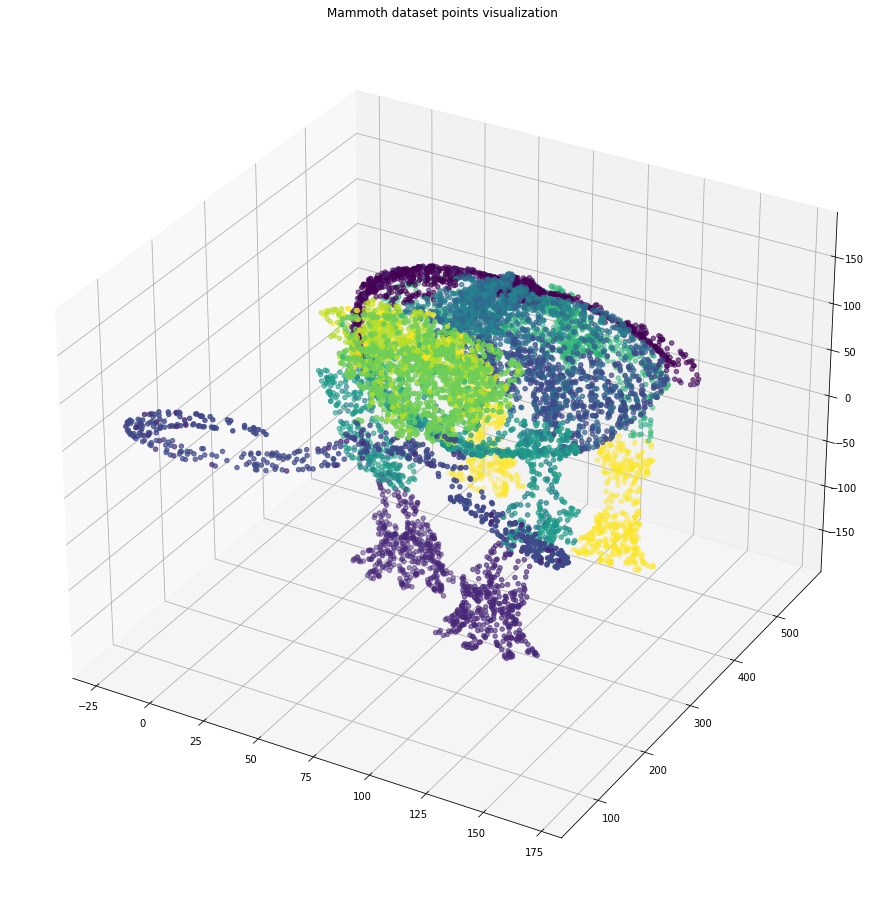

In [48]:
# Now let's visualize the mammoth data using pyplot
def plot_3d_mammoth_scatter(x,y,z,mammoth_classes):
    fig = plt.figure(figsize=(16,16))
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(xs=x, ys=y, zs=z, c=mammoth_classes)
    plt.title("Mammoth dataset points visualization")
    plt.show()

plot_3d_mammoth_scatter(x,y,z,mammoth_classes)

## Let's now transform the mammoth data to 2d using various methods

### Simple plot function to draw mammoth 2d visualizations

In [49]:
def plot_2d_mammoth_scatter(X, y):
    fig, plot = plt.subplots()
    fig.set_size_inches(16, 16)

    for i in range(10):
        digit_indices = (y == i)

        dim1 = X[digit_indices, 0]
        dim2 = X[digit_indices, 1]
        plot.scatter(dim1, dim2, label=f"'{i}'")

    plot.set_xticks(())
    plot.set_yticks(())

    plt.tight_layout()
    plt.legend()
    plt.show()

### First let's make dataframe and scale our data for better results in 2d

In [50]:
data_mammoth = np.array([xyz[2], xyz[0], xyz[1]]).transpose()
min_max_scaler = preprocessing.MinMaxScaler()
data_mammoth_scaled = min_max_scaler.fit_transform(data_mammoth)

columns_mammoth = ['x', 'y', 'z']
df_mammoth = pd.DataFrame(data=data_mammoth_scaled, columns=columns_mammoth)

df_mammoth.head(15)

,x,y,z
0,0.243010,0.728091,0.810569
1,0.190200,0.662922,0.788558
2,0.801630,0.825924,0.735012
3,0.185681,0.712159,0.754896
4,0.522500,0.696609,0.829465
5,0.244617,0.573968,0.634007
6,0.183193,0.628288,0.720932
7,0.232100,0.746069,0.783662
8,0.200754,0.689638,0.783188
9,0.497822,0.725899,0.872186


## t-SNE

In [7]:
tsne_p40 = TSNE(n_components=2, init="pca", learning_rate='auto', perplexity=40)
tsne_p120 = TSNE(n_components=2, init="pca", learning_rate='auto', perplexity=120)
tsne_p500 = TSNE(n_components=2, init="pca", learning_rate='auto', perplexity=500)

x_40_tsne = tsne_p40.fit_transform(df_mammoth)
x_120_tsne = tsne_p120.fit_transform(df_mammoth)
x_500_tsne = tsne_p500.fit_transform(df_mammoth)

/home/ewer/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(
/home/ewer/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(
/home/ewer/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


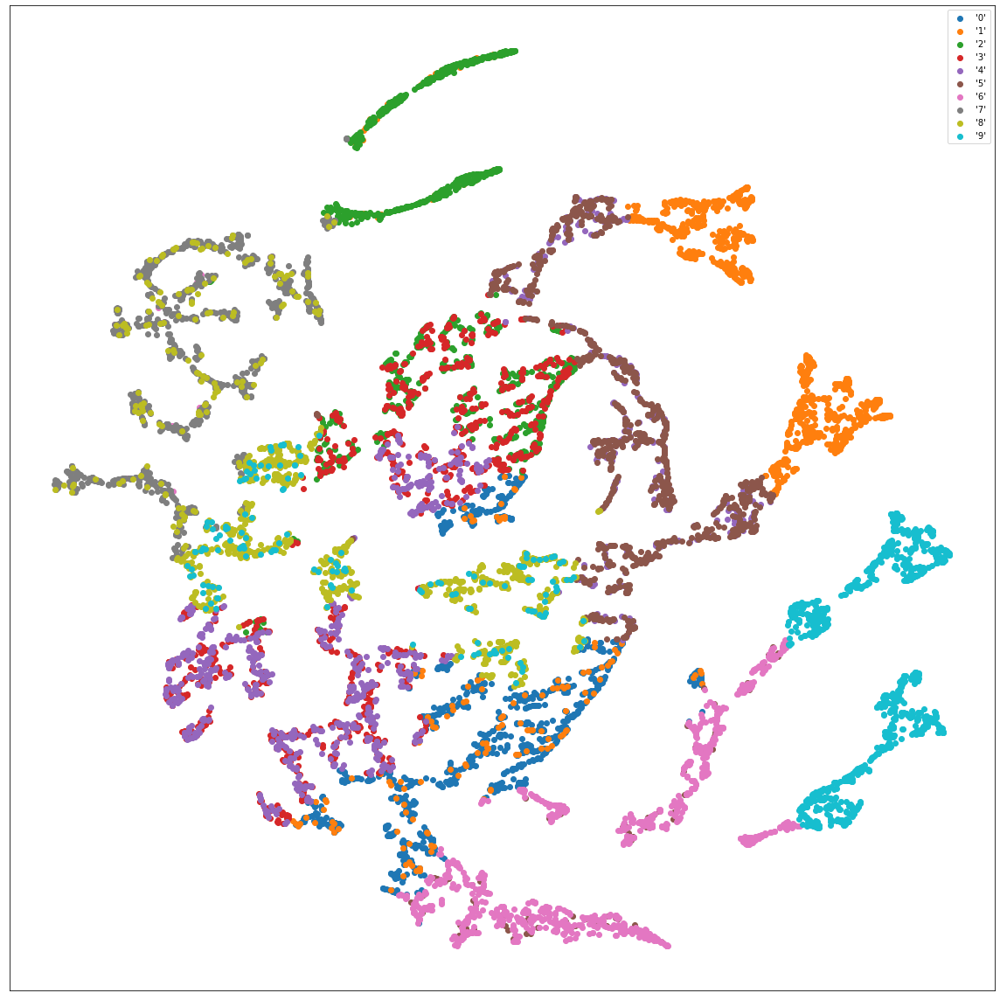

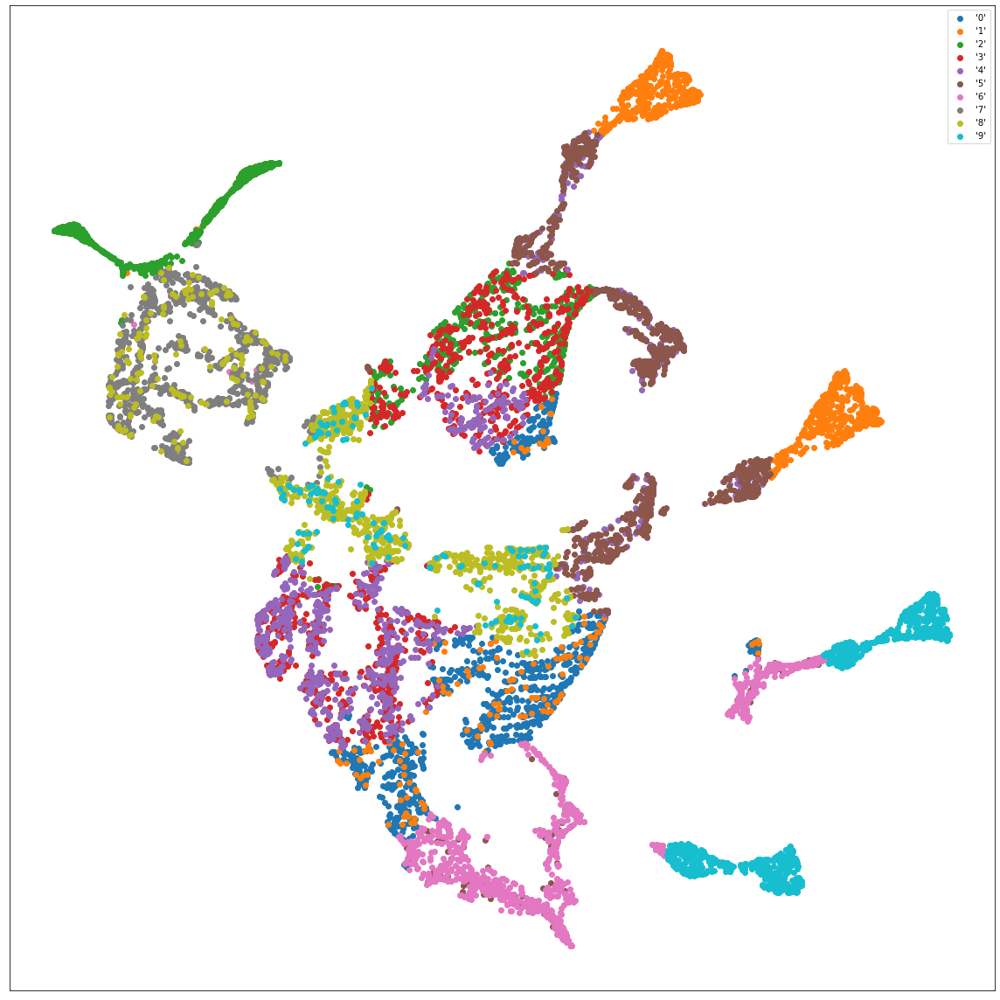

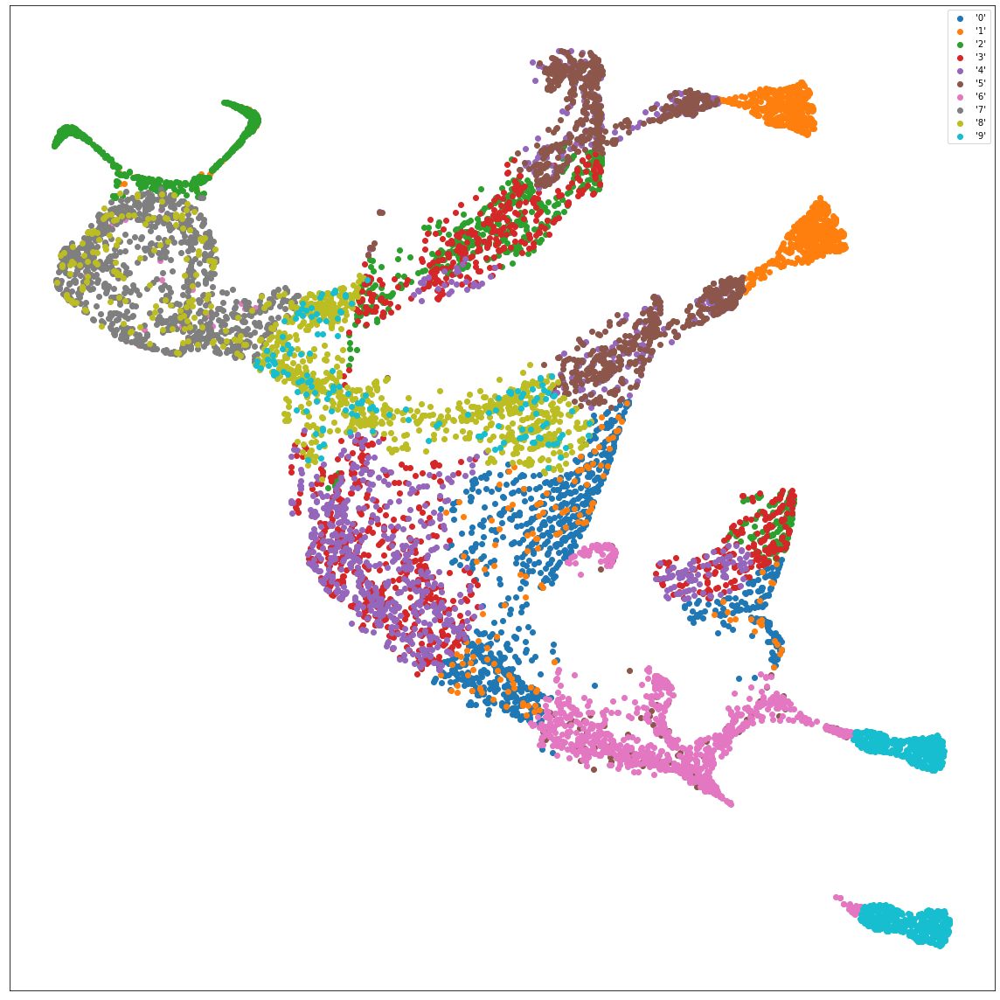

In [8]:
plot_2d_mammoth_scatter(x_40_tsne, mammoth_classes)
plot_2d_mammoth_scatter(x_120_tsne, mammoth_classes)
plot_2d_mammoth_scatter(x_500_tsne, mammoth_classes)

## UMAP

In [9]:
umap_nn10 = umap.UMAP(n_neighbors=10)
umap_nn20 = umap.UMAP(n_neighbors=20)
umap_nn50 = umap.UMAP(n_neighbors=50)

x_10_umap = umap_nn10.fit_transform(df_mammoth)
x_20_umap = umap_nn20.fit_transform(df_mammoth)
x_50_umap = umap_nn50.fit_transform(df_mammoth)

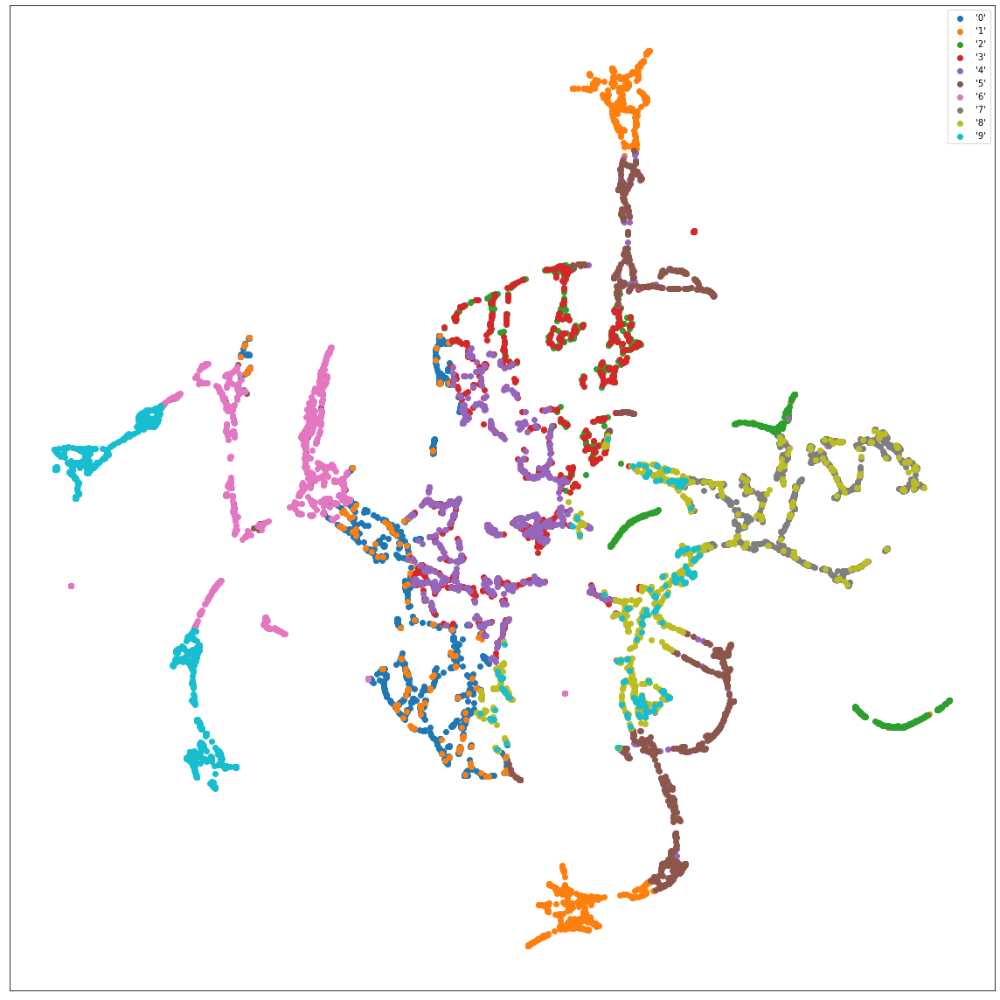

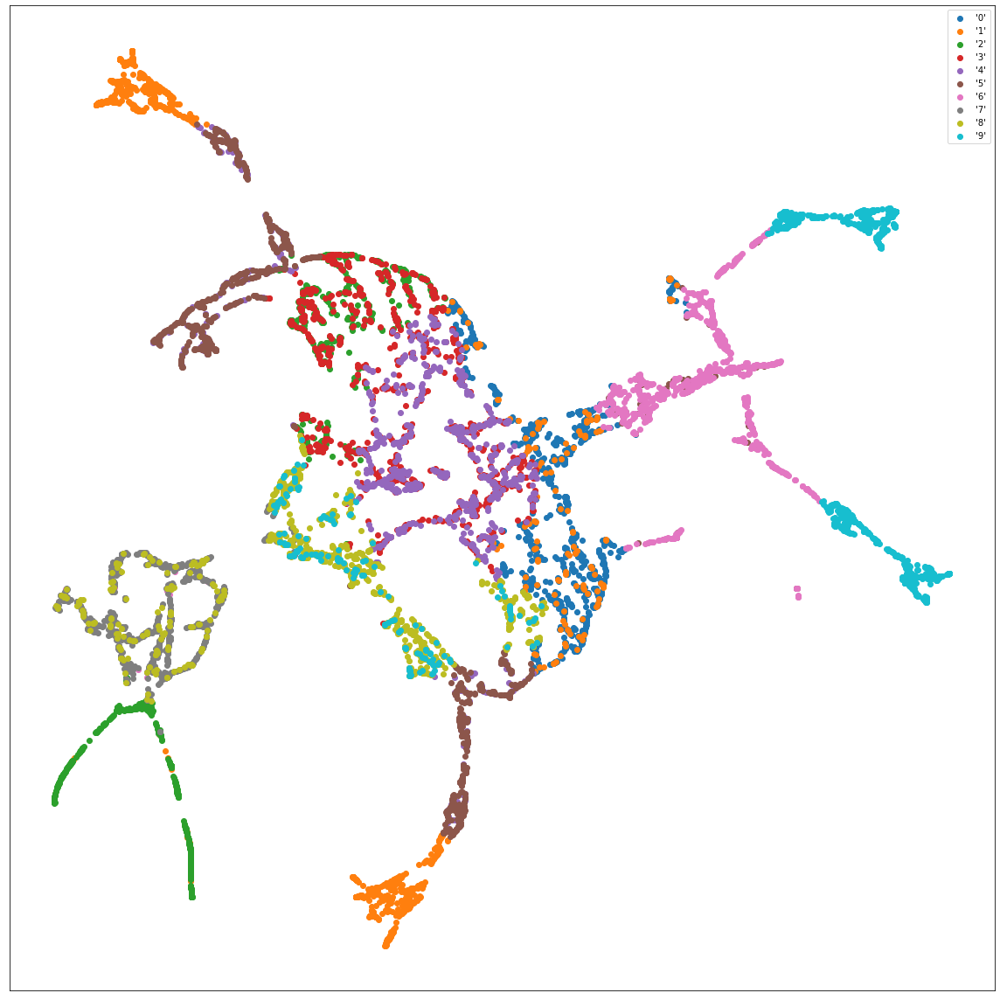

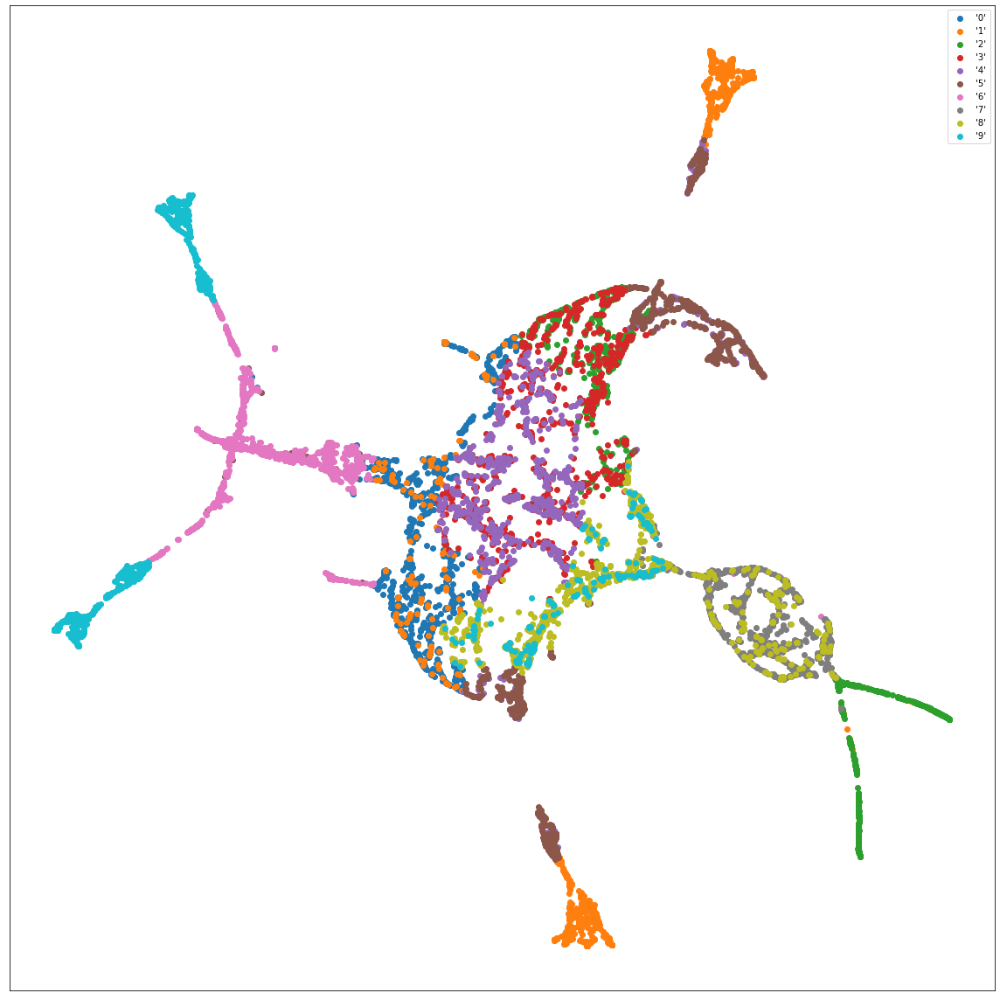

In [10]:
plot_2d_mammoth_scatter(x_10_umap, mammoth_classes)
plot_2d_mammoth_scatter(x_20_umap, mammoth_classes)
plot_2d_mammoth_scatter(x_50_umap, mammoth_classes)

## TriMAP

In [88]:
trimap_ni10 = trimap.TRIMAP(n_inliers=10,
                            n_outliers=5,
                            n_random=5)
trimap_ni20 = trimap.TRIMAP(n_inliers=20,
                            n_outliers=5,
                            n_random=5)
trimap_ni40 = trimap.TRIMAP(n_inliers=40,
                            n_outliers=5,
                            n_random=5)

In [89]:
x_10_trimap = trimap_ni10.fit_transform(data_mammoth_scaled)
x_20_trimap = trimap_ni20.fit_transform(data_mammoth_scaled)
x_40_trimap = trimap_ni40.fit_transform(data_mammoth_scaled)

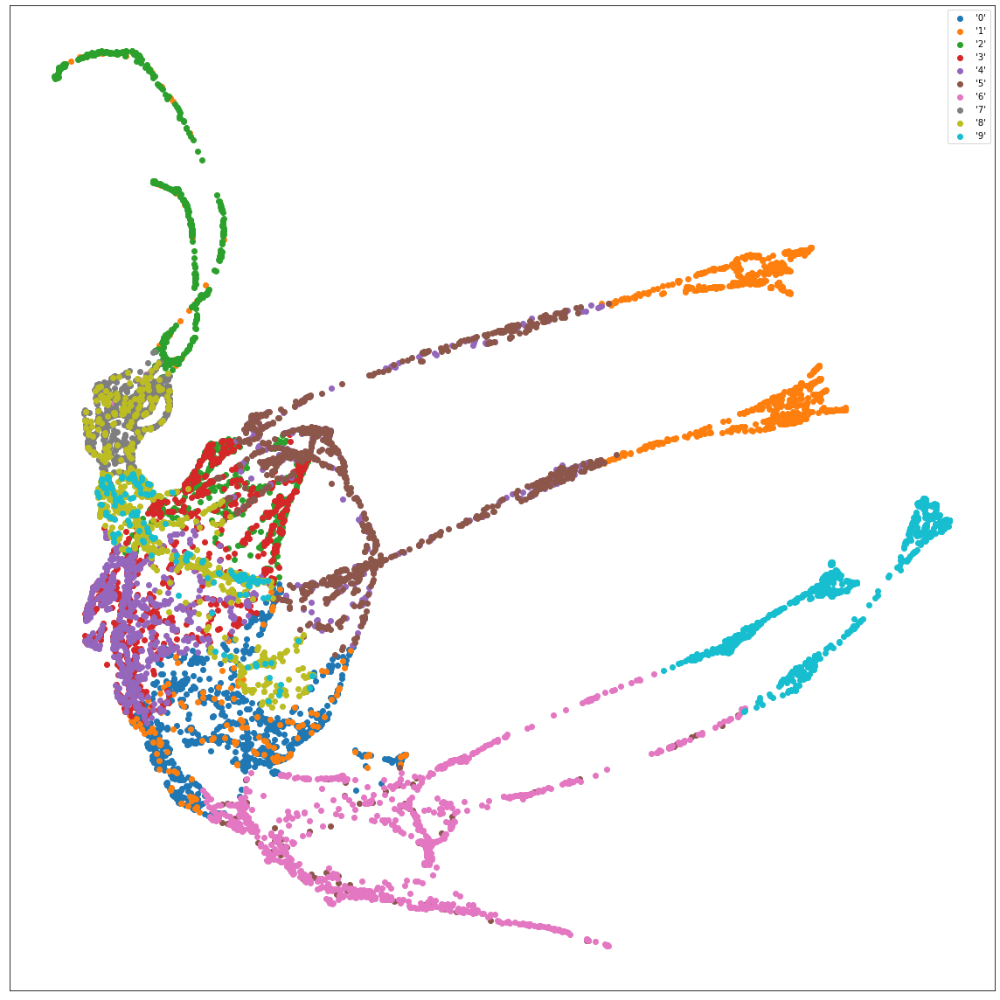

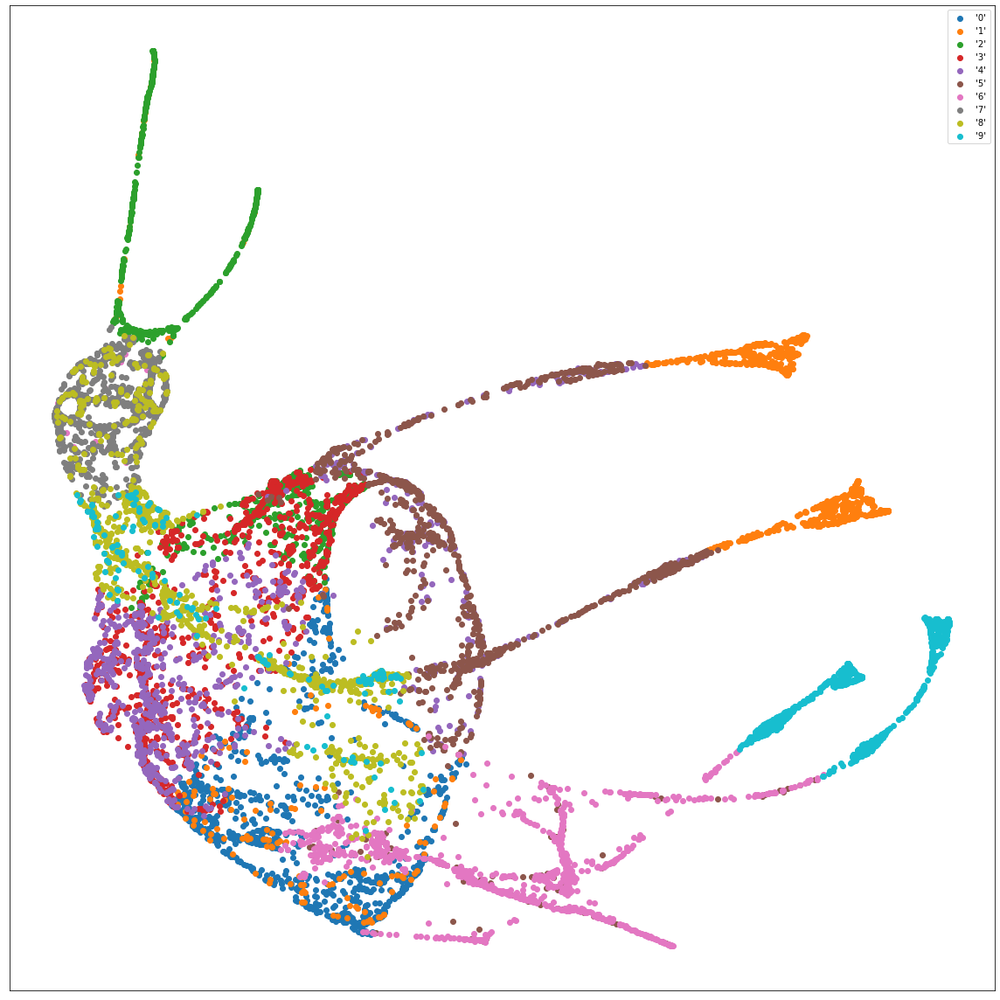

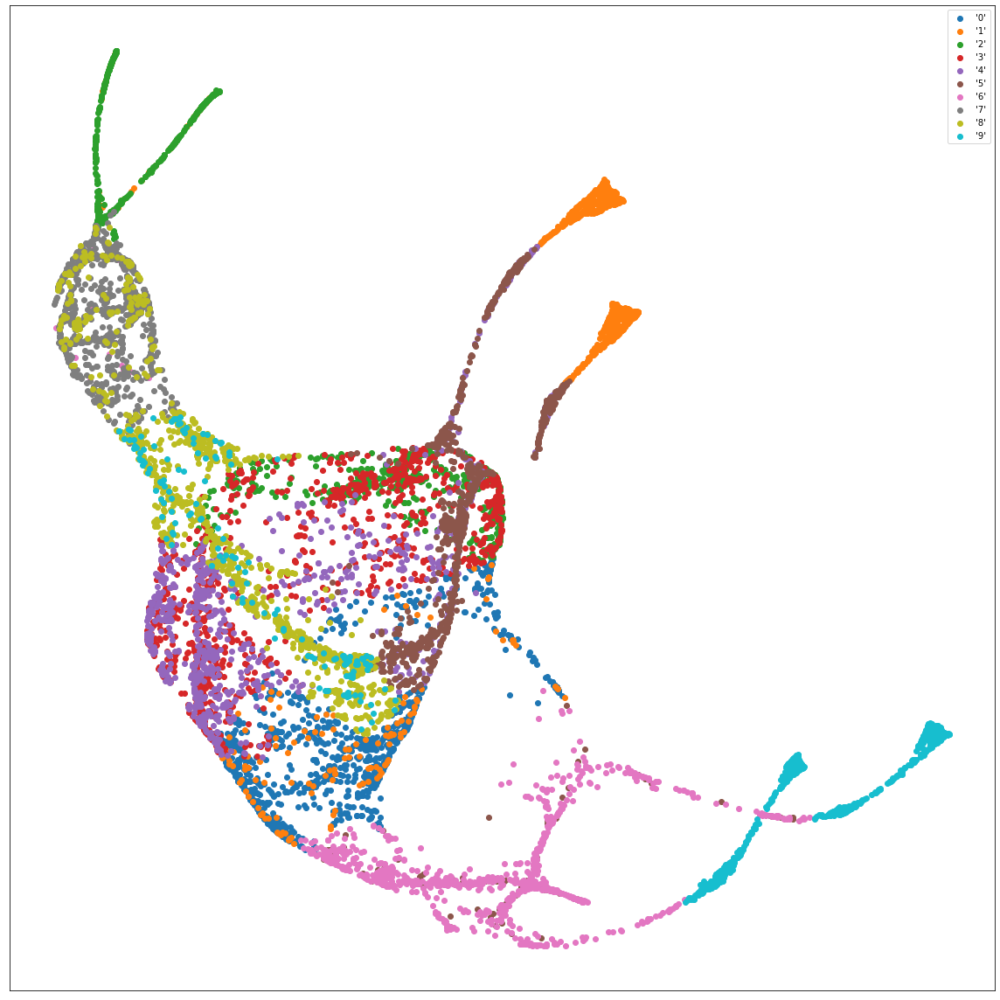

In [90]:
plot_2d_mammoth_scatter(x_10_trimap, mammoth_classes)
plot_2d_mammoth_scatter(x_20_trimap, mammoth_classes)
plot_2d_mammoth_scatter(x_40_trimap, mammoth_classes)

## PaCMAP

In [51]:
pacmapm = pacmap.PaCMAP(n_neighbors=None, MN_ratio=0.5, FP_ratio=2.0)
pacmap_nn10 = pacmap.PaCMAP(n_neighbors=10, MN_ratio=0.5, FP_ratio=2.0)
pacmap_nn20 = pacmap.PaCMAP(n_neighbors=20, MN_ratio=0.5, FP_ratio=2.0)

In [52]:
x_pacmap = pacmapm.fit_transform(data_mammoth_scaled, init="pca")
x_nn10_pacmap = pacmap_nn10.fit_transform(data_mammoth_scaled, init="pca") 
x_nn20_pacmap = pacmap_nn20.fit_transform(data_mammoth_scaled, init="pca") 

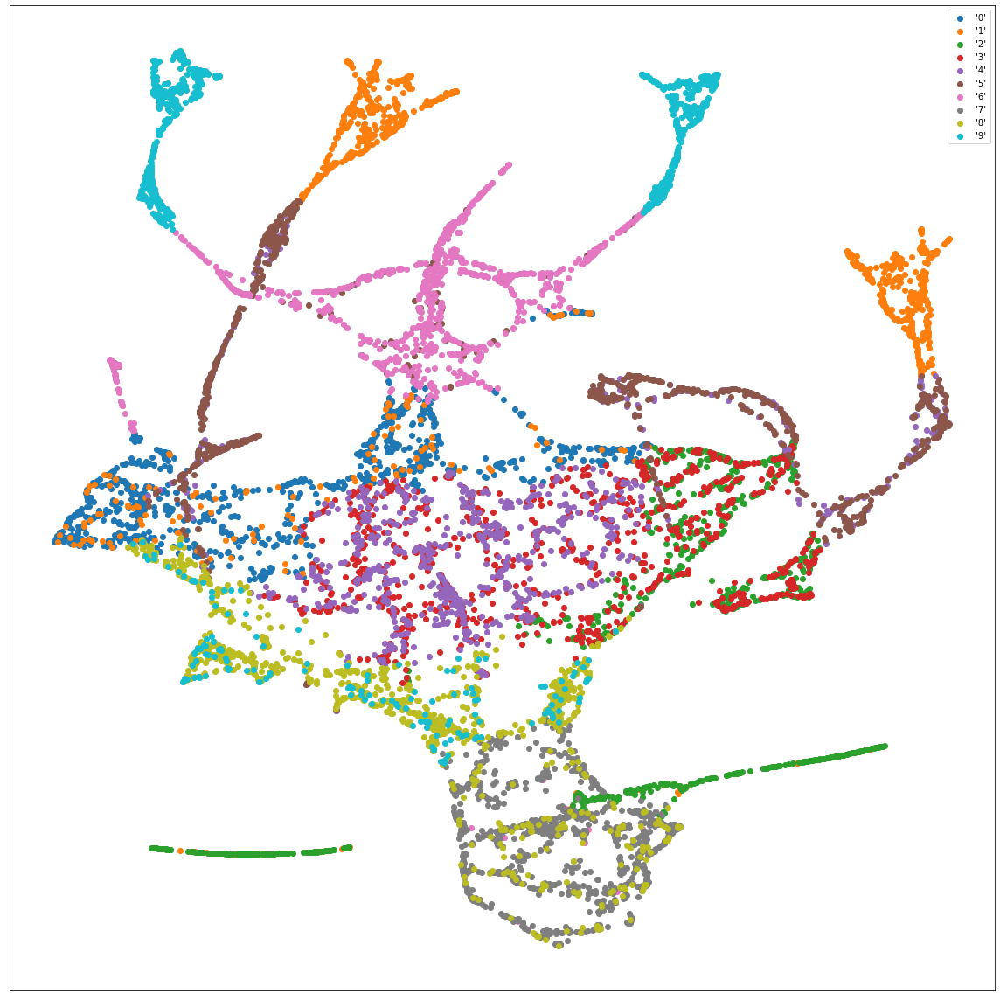

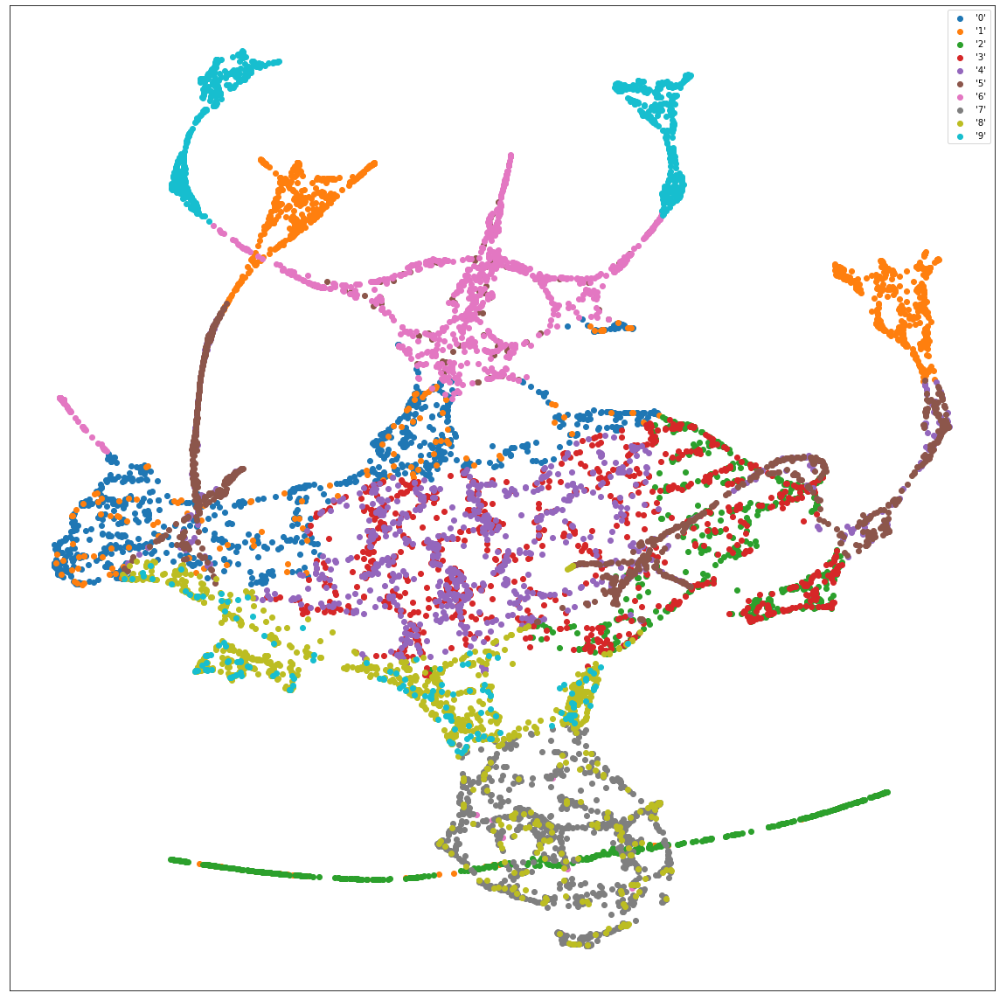

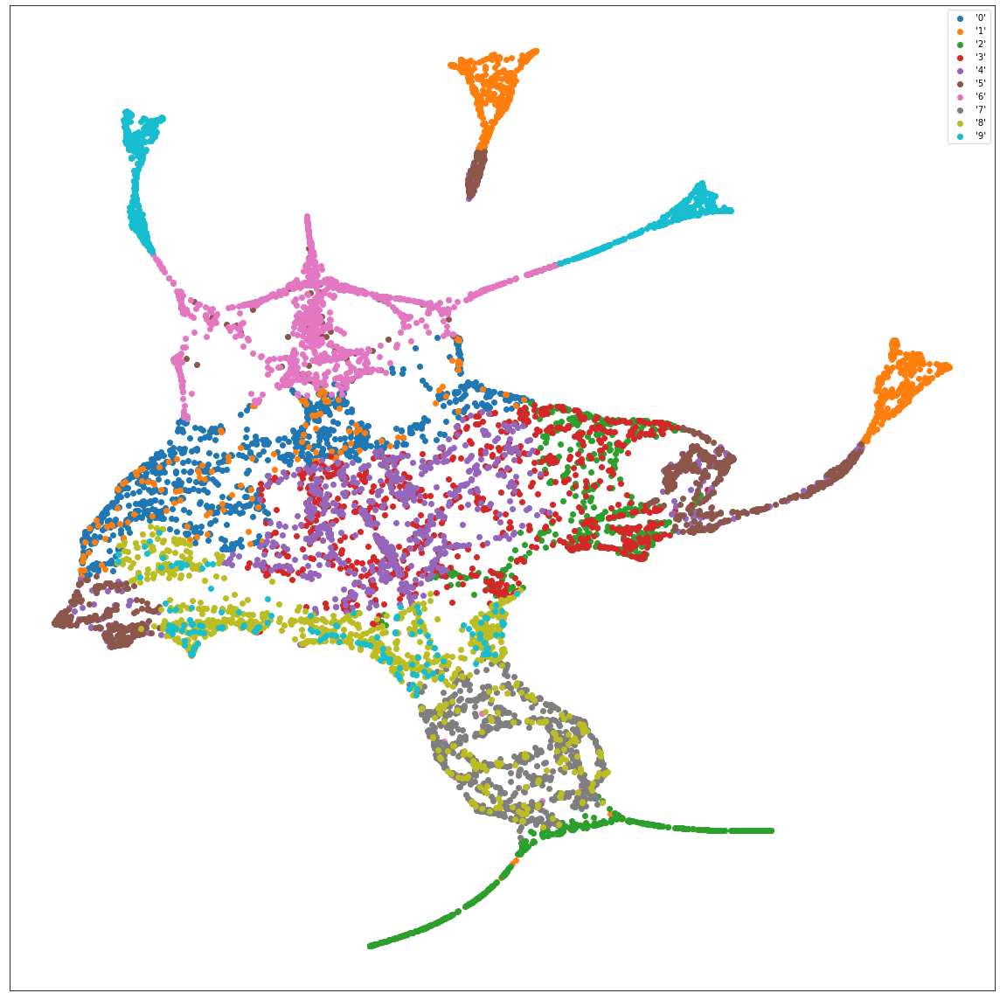

In [53]:
plot_2d_mammoth_scatter(x_pacmap, mammoth_classes)
plot_2d_mammoth_scatter(x_nn10_pacmap, mammoth_classes)
plot_2d_mammoth_scatter(x_nn20_pacmap, mammoth_classes)

## IVHD

### Let's generate mammoth labels and 3d points to csv for IVHD script

In [17]:
df_mammoth_labels = pd.DataFrame(data=mammoth_classes)

filepath = Path('data/mammoth_3d.csv')  
filepath.parent.mkdir(parents=True, exist_ok=True)  
df_mammoth.to_csv(filepath, header=False, index=False)


filepath = Path('data/mammoth_labels.csv')  
filepath.parent.mkdir(parents=True, exist_ok=True)  
df_mammoth_labels.to_csv(filepath, header=False, index=False)

### Let's now use IVHD to visualize mammoth in 2D

In [18]:
df_tmp = pd.read_json('../data/mammoth_3d.json')
df_tmp.to_csv('../data/mammoth_3d_nonscaled.csv', header=False, index=False)

In [32]:
import os

ivhd_const_args = {
    'dir': "../viskit_offline",
    'labels_csv': "../data/mammoth_labels.csv",
    'output': "../data/ivhd_mammoth.txt",
    'iter': 2500,
    'bd': 1, # binaryDistances
    'rns': 0, # reverseNeighborsSteps
    'rnc': 0, # reverseNeighborsCount
    'l1s': 0, # l1Steps
    'optimizer': "force-directed"
}

ivhd_args = [
    {'data_csv': "../data/mammoth_3d.csv", 'gp': "../data/mammoth_cosine.bin", 'nn': 5, 'rn': 1},
    {'data_csv': "../data/mammoth_3d_nonscaled.csv", 'gp': "../data/mammoth_euclidean_nonscaled.bin", 'nn': 5, 'rn': 1},
    {'data_csv': "../data/mammoth_3d_nonscaled.csv", 'gp': "../data/mammoth_euclidean_nonscaled.bin", 'nn': 10, 'rn': 1},
    {'data_csv': "../data/mammoth_3d.csv", 'gp': "../data/mammoth_euclidean.bin", 'nn': 3, 'rn': 1},
    {'data_csv': "../data/mammoth_3d.csv", 'gp': "../data/mammoth_euclidean.bin", 'nn': 5, 'rn': 1},
    {'data_csv': "../data/mammoth_3d.csv", 'gp': "../data/mammoth_euclidean.bin", 'nn': 10, 'rn': 1},
    {'data_csv': "../data/mammoth_3d.csv", 'gp': "../data/mammoth_euclidean.bin", 'nn': 5, 'rn': 2},
    {'data_csv': "../data/mammoth_3d.csv", 'gp': "../data/mammoth_euclidean.bin", 'nn': 7, 'rn': 3},
    {'data_csv': "../data/mammoth_3d.csv", 'gp': "../data/mammoth_euclidean.bin", 'nn': 10, 'rn': 5},
]
    

ivhd_names = ["IVHD cosine 5nn scaled 1rn", #to show cosine doesnt do the job 
    "IVHD euclidean 5nn non-scaled 1rn", 
    "IVHD euclidean 10nn non-scaled 1rn", 
    "IVHD euclidean 3nn scaled 1rn",
    "IVHD euclidean 5nn scaled 1rn", 
    "IVHD euclidean 10nn scaled 1rn", 
    "IVHD euclidean 5nn scaled 2rn", 
    "IVHD euclidean 7nn scaled 3rn",
    "IVHD euclidean 10nn scaled 5rn",
]


def get_ivhd_result(output_file):
    df_ivhd = pd.read_csv(output_file, header=None)
    x_ivhd = df_ivhd.loc[:, '0':'1'].values
    return x_ivhd


In [21]:
ivhd_results = []

for args in ivhd_args:
    csv_arg = args['data_csv']
    gp_arg = args['gp']
    nn_arg = args['nn']
    rn_arg = args['rn']

    command = '{dir} "{data_csv}" "{labels_csv}" "{gp}" {output} {iter} {nn} {rn} {bd} {rns} {rnc} {l1s} "{optimizer}"'.format(
        dir = ivhd_const_args['dir'],
        data_csv = csv_arg,
        labels_csv = ivhd_const_args['labels_csv'],
        gp = gp_arg,
        output = ivhd_const_args['output'],
        iter = ivhd_const_args['iter'],
        nn = nn_arg, 
        rn = rn_arg,
        bd = ivhd_const_args['bd'],
        rns = ivhd_const_args['rns'],
        rnc = ivhd_const_args['rnc'],
        l1s = ivhd_const_args['l1s'],
        optimizer = ivhd_const_args['optimizer'],
    )

    os.system(command)
    res = get_ivhd_result(ivhd_const_args['output'])
    ivhd_results.append(res)

[Info] [CSV Parser] Loading dataset from file: ./data/mammoth_3d.csv
[Info] [CSV Parser] Loading dataset from file: ./data/mammoth_labels.csv
[Info] [CSV Parser] Labels file passed.
[Info] [CSV Parser] Dataset size: 10000
[Info] [CSV Parser] Dataset dimensionality: 3
[Info] [CSV Parser] Number of classes in dataset: 10
[Info] [CSV Parser] Finished.
[Info] [Graph] Loading graph from cache...
[Info] [Graph] Finished.
[Info] [kNN Generator] Determining random neighbors...
[Info] [kNN Generator] Finished.
[Info] [kNN Generator] Neighbors in graph: 60000
Step: 0
Step: 100
Step: 200
Step: 300
Step: 400
Step: 500
Step: 600
Step: 700
Step: 800
Step: 900
Step: 1000
Step: 1100
Step: 1200
Step: 1300
Step: 1400
Step: 1500
Step: 1600
Step: 1700
Step: 1800
Step: 1900
Step: 2000
Step: 2100
Step: 2200
Step: 2300
Step: 2400
[Info] [CSV Parser] Loading dataset from file: ./data/mammoth_3d_nonscaled.csv
[Info] [CSV Parser] Loading dataset from file: ./data/mammoth_labels.csv
[Info] [CSV Parser] Labels fi

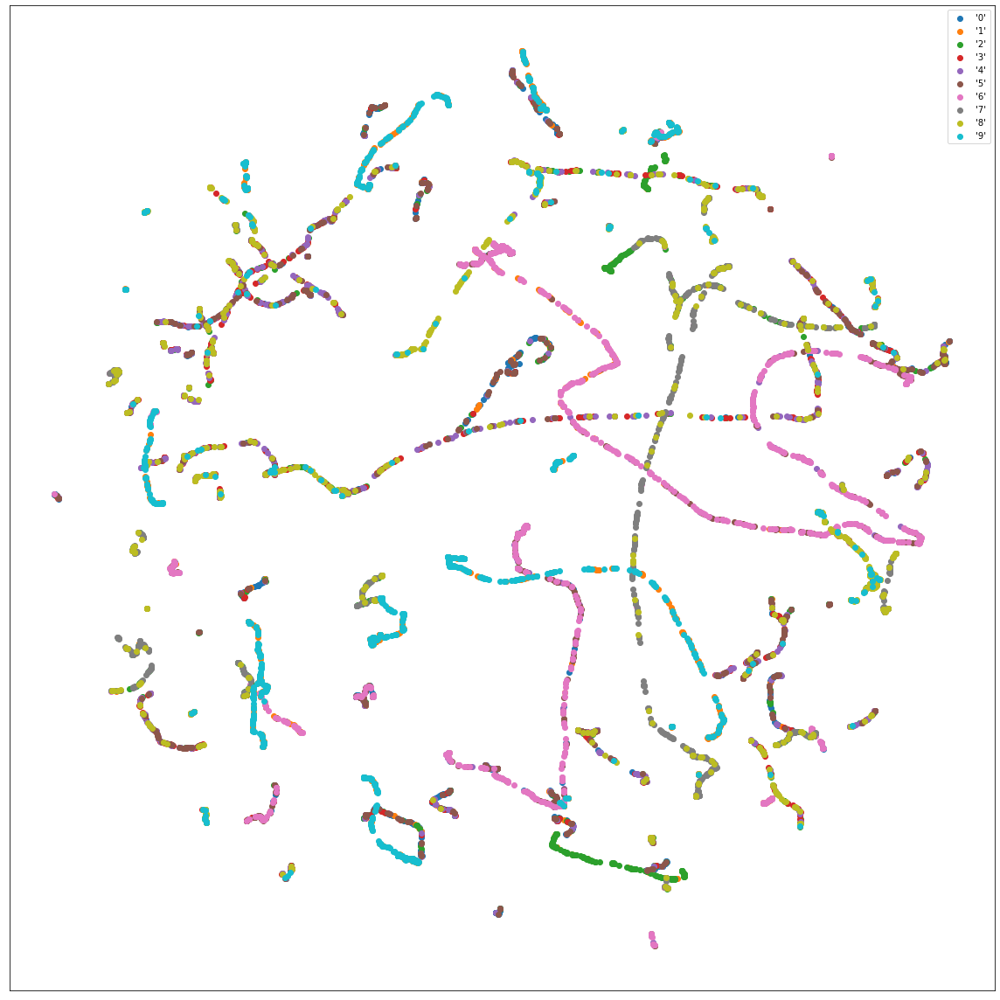

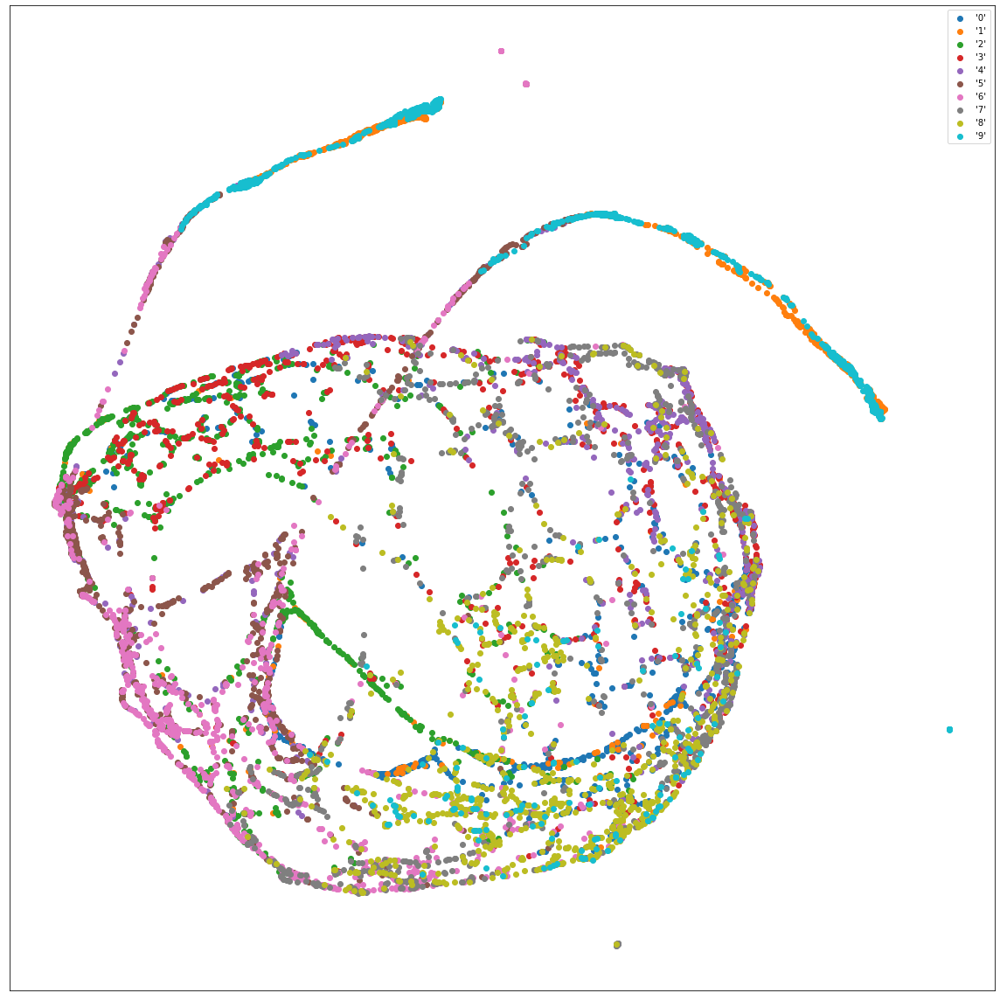

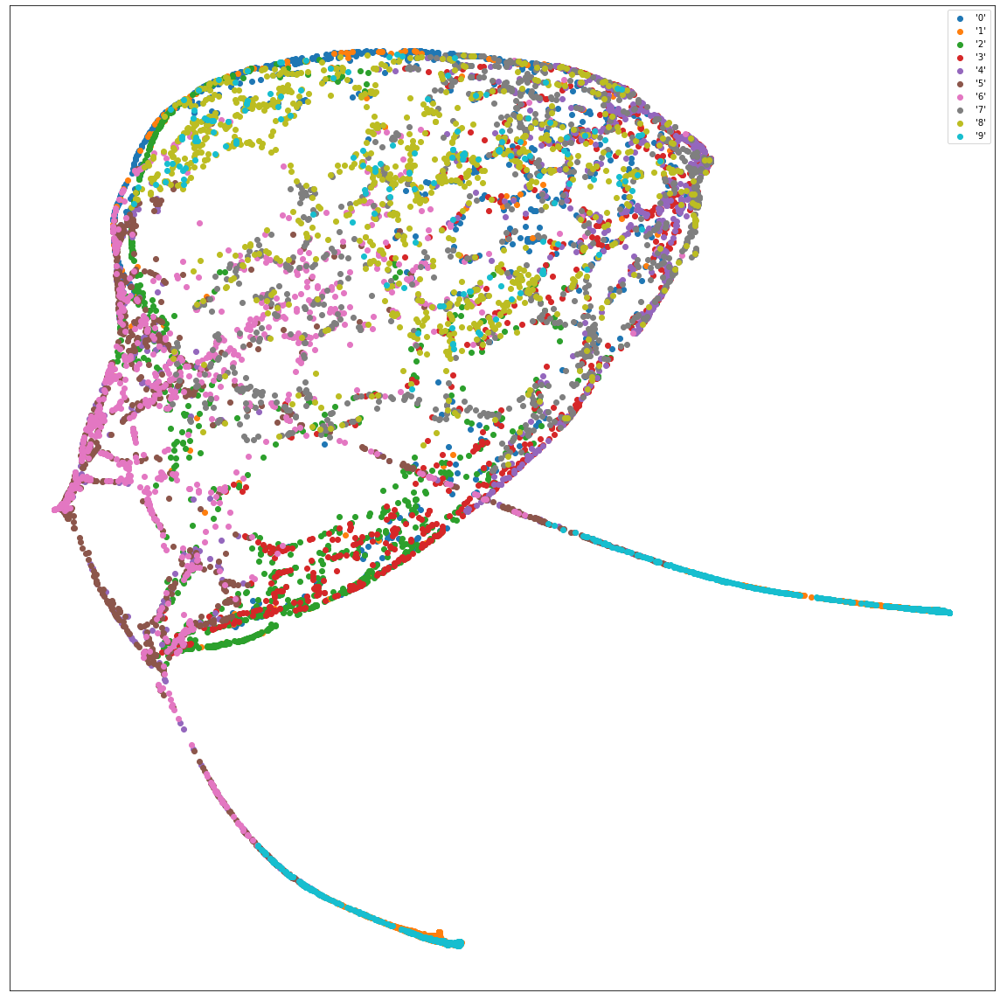

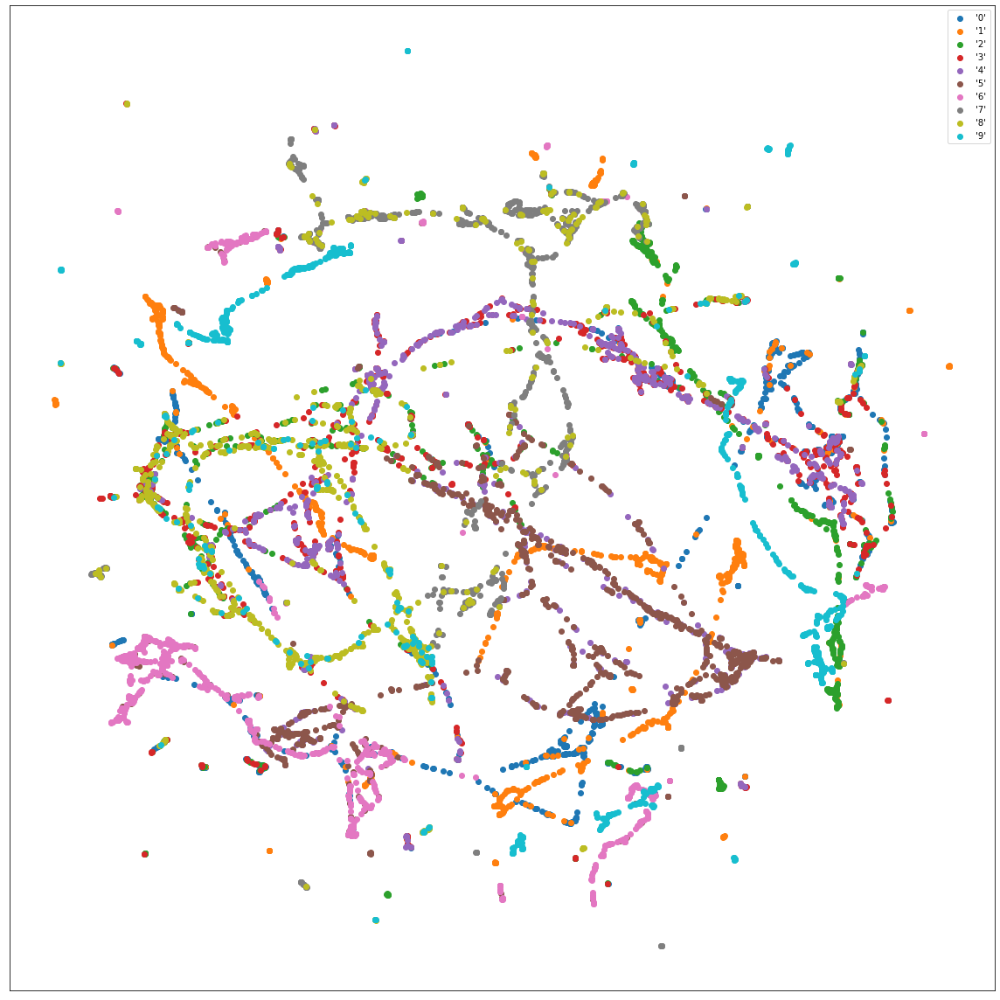

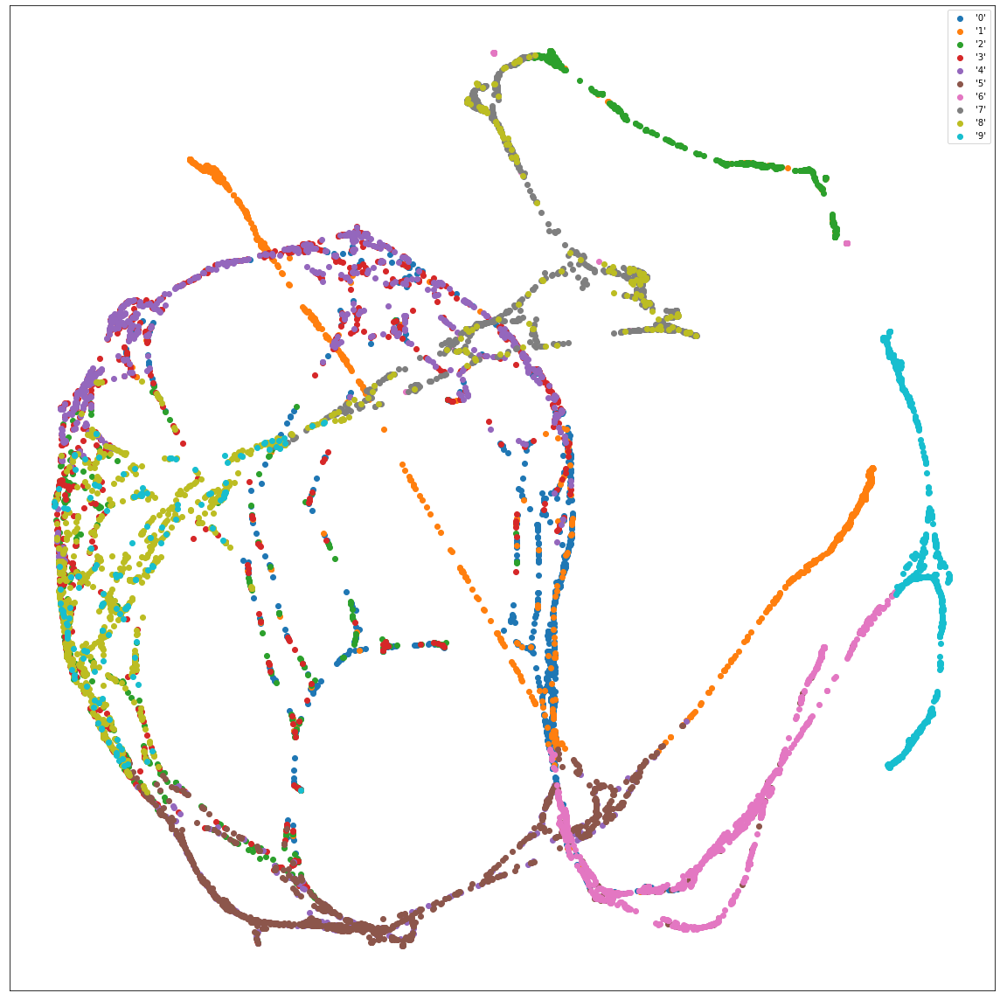

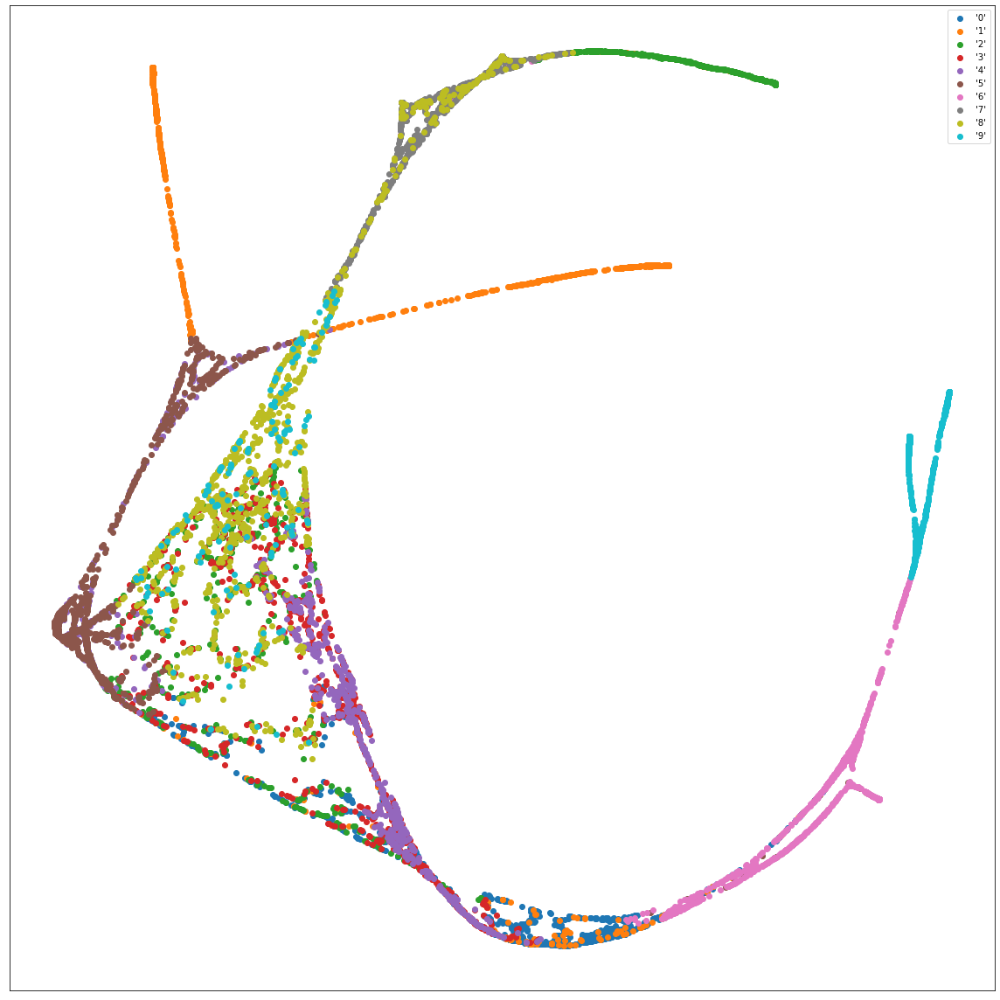

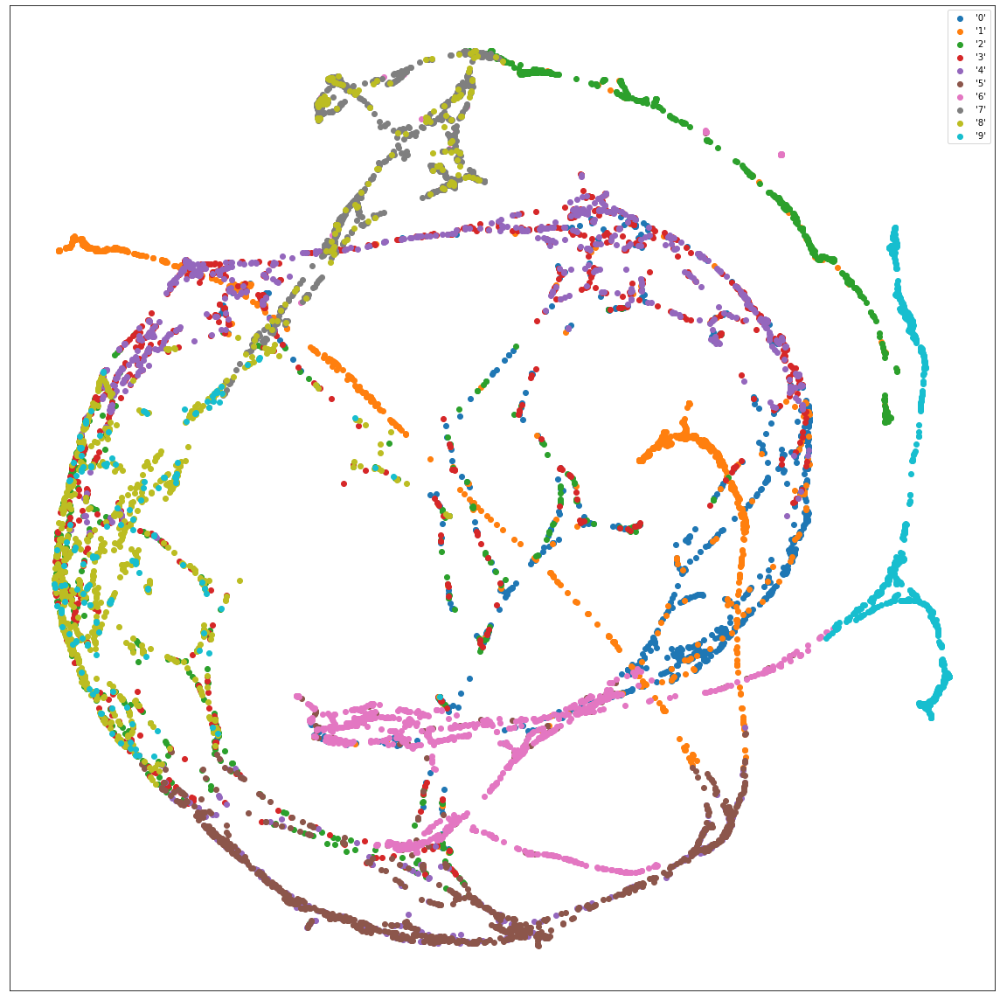

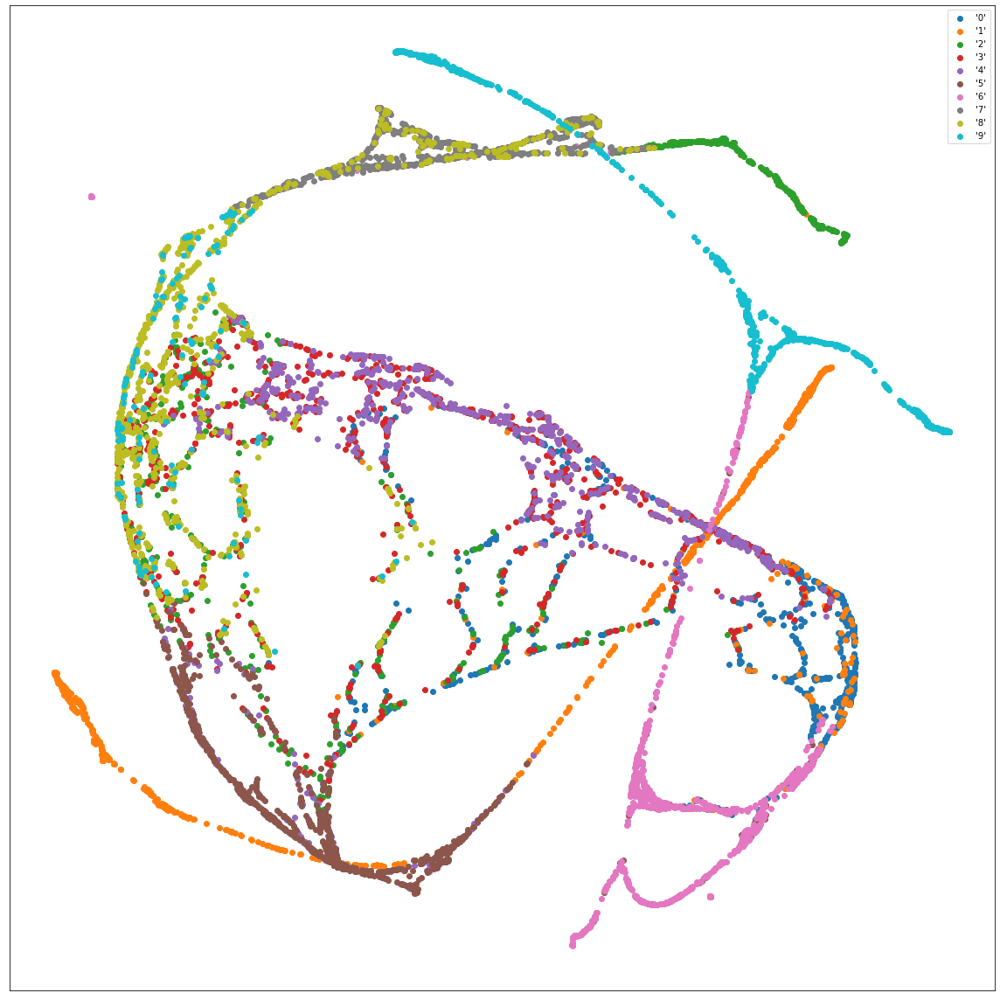

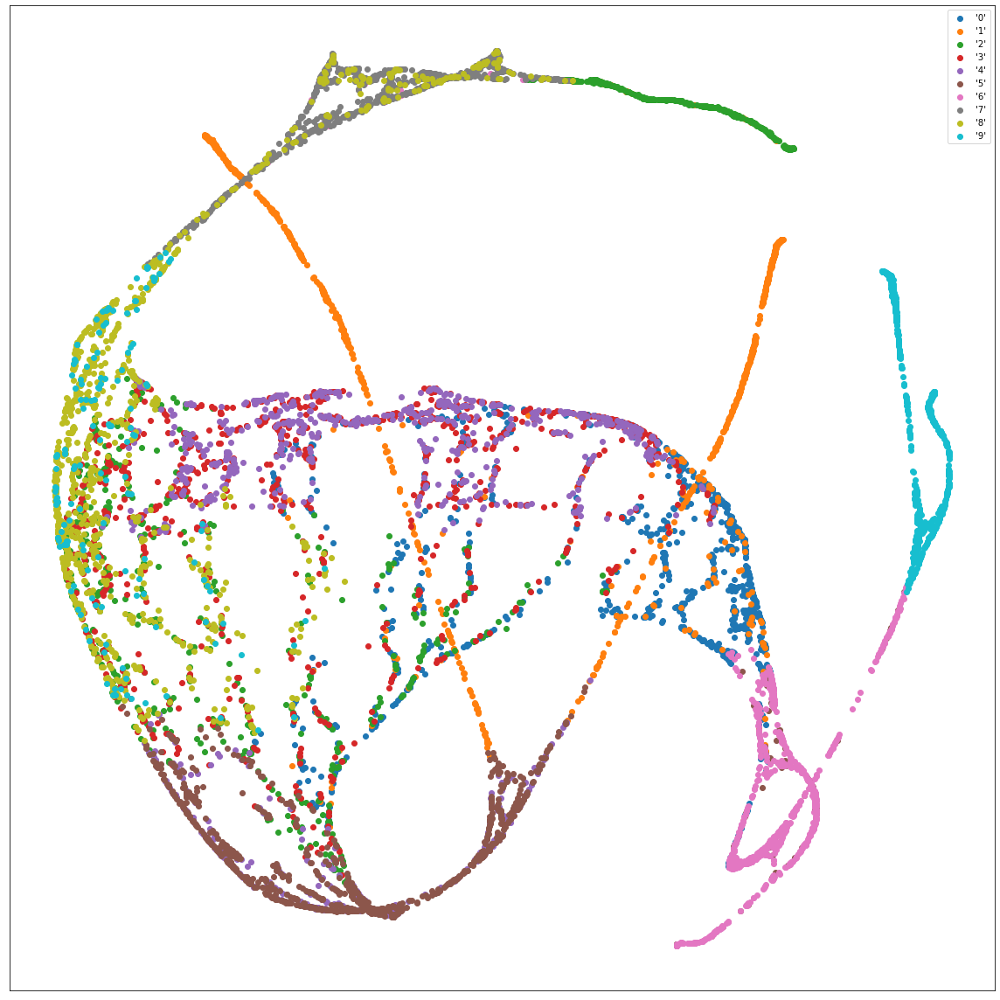

In [23]:
for x in ivhd_results:
    plot_2d_mammoth_scatter(x, mammoth_classes)

## Method comparison

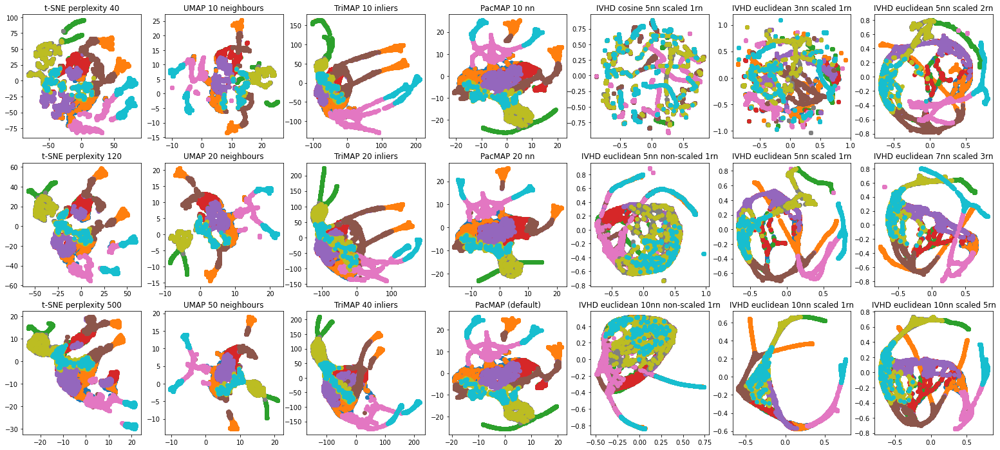

In [91]:
# 3 subplots for t-SNE
# 3 subplots for UMAP
# 3 subplots for TriMAP
# 3 subplots for PacMAP
# 9 subplots for IVHD
figure, axis = plt.subplots(3, 7)
figure.set_size_inches(27,12)
methods_names = [
    ["t-SNE perplexity 40", "t-SNE perplexity 120", "t-SNE perplexity 500"],
    ["UMAP 10 neighbours", "UMAP 20 neighbours", "UMAP 50 neighbours"], 
    ["TriMAP 10 inliers", "TriMAP 20 inliers", "TriMAP 40 inliers"], 
    ["PacMAP 10 nn", "PacMAP 20 nn", "PacMAP (default)"],
    [ivhd_names[0], ivhd_names[1], ivhd_names[2]],
    [ivhd_names[3], ivhd_names[4], ivhd_names[5]], 
    [ivhd_names[6], ivhd_names[7], ivhd_names[8]],
]
todo_res = np.array([])
methods_results = [
    [x_40_tsne, x_120_tsne, x_500_tsne],
    [x_10_umap, x_20_umap, x_50_umap],
    [x_10_trimap, x_20_trimap, x_40_trimap],
    [x_nn10_pacmap, x_nn20_pacmap, x_pacmap],
    [ivhd_results[0], ivhd_results[1], ivhd_results[2]],
    [ivhd_results[3], ivhd_results[4], ivhd_results[5]],
    [ivhd_results[6], ivhd_results[7], ivhd_results[8]],
]

for j in range(7):
    for i in range(3):
        axis[i, j].set_title(methods_names[j][i])

        X = methods_results[j][i]
        if not X.any(): # temporary for non-existant plot data
            break
        
        for k in range(10):
            digit_indices = (mammoth_classes == k)
            dim1 = X[digit_indices, 0]
            dim2 = X[digit_indices, 1]
            axis[i, j].scatter(dim1, dim2, label=f"'{i}'")
            

plt.show()

## Metrics comparison for methods

### Funkcje ze skryptu z metryk

In [31]:
markers = ["x", "o", "s", "*", "^", ".", "X"]
colors = ["red", "blue", "green", "brown", "orange", "cyan", "grey", "purple"]


@numba.jit(nopython=True)
def knngain(d_hd, d_ld, labels):
    # Number of data points
    N = d_hd.shape[0]
    N_1 = N - 1
    k_hd = np.zeros(shape=N_1, dtype=np.int64)
    k_ld = np.zeros(shape=N_1, dtype=np.int64)
    # For each data point
    for i in range(N):
        c_i = labels[i]
        di_hd = d_hd[i, :].argsort(kind="mergesort")
        di_ld = d_ld[i, :].argsort(kind="mergesort")
        # Making sure that i is first in di_hd and di_ld
        for arr in [di_hd, di_ld]:
            for idj, j in enumerate(arr):
                if j == i:
                    idi = idj
                    break
            if idi != 0:
                arr[idi] = arr[0]
            arr = arr[1:]
        for k in range(N_1):
            if c_i == labels[di_hd[k]]:
                k_hd[k] += 1
            if c_i == labels[di_ld[k]]:
                k_ld[k] += 1
    # Computing the KNN gain
    gn = (k_ld.cumsum() - k_hd.cumsum()).astype(np.float64) / (
        (1.0 + np.arange(N_1)) * N
    )
    # Returning the KNN gain and its AUC
    return gn, eval_auc(gn)


@numba.jit(nopython=True)
def eval_auc(arr):
    i_all_k = 1.0 / (np.arange(arr.size) + 1.0)
    return np.float64(arr.dot(i_all_k)) / (i_all_k.sum())


@numba.jit(nopython=True)
def eval_rnx(Q):
    N_1 = Q.shape[0]
    N = N_1 + 1
    # Computing Q_NX
    qnxk = np.empty(shape=N_1, dtype=np.float64)
    acc_q = 0.0
    for K in range(N_1):
        acc_q += Q[K, K] + np.sum(Q[K, :K]) + np.sum(Q[:K, K])
        qnxk[K] = acc_q / ((K + 1) * N)
    # Computing R_NX
    arr_K = np.arange(N_1)[1:].astype(np.float64)
    rnxk = (N_1 * qnxk[: N_1 - 1] - arr_K) / (N_1 - arr_K)
    # Returning
    return rnxk


def eval_dr_quality(d_hd, d_ld):
    # Computing the co-ranking matrix of the embedding, and the R_{NX}(K) curve.
    rnxk = eval_rnx(Q=coranking(d_hd=d_hd, d_ld=d_ld))
    # Computing the AUC, and returning.
    return rnxk, eval_auc(rnxk)


def coranking(d_hd, d_ld):
    # Computing the permutations to sort the rows of the distance matrices in HDS and LDS.
    perm_hd = d_hd.argsort(axis=-1, kind="mergesort")
    perm_ld = d_ld.argsort(axis=-1, kind="mergesort")

    N = d_hd.shape[0]
    i = np.arange(N, dtype=np.int64)
    # Computing the ranks in the LDS
    R = np.empty(shape=(N, N), dtype=np.int64)
    for j in range(N):
        R[perm_ld[j, i], j] = i
    # Computing the co-ranking matrix
    Q = np.zeros(shape=(N, N), dtype=np.int64)
    for j in range(N):
        Q[i, R[perm_hd[j, i], j]] += 1
    # Returning
    return Q[1:, 1:]


def viz_qa(
    Ly,
    ymin=None,
    ymax=None,
    Lmarkers=None,
    Lcols=None,
    Lleg=None,
    Lls=None,
    Lmedw=None,
    Lsdots=None,
    lw=2,
    markevery=0.1,
    tit="",
    folder_name="",
    xlabel="",
    ylabel="",
    alpha_plot=0.9,
    alpha_leg=0.8,
    stit=25,
    sax=20,
    sleg=15,
    zleg=1,
    loc_leg="best",
    ncol_leg=1,
    lMticks=10,
    lmticks=5,
    wMticks=2,
    wmticks=1,
    nyMticks=11,
    mymticks=4,
    grid=True,
    grid_ls="solid",
    grid_col="lightgrey",
    grid_alpha=0.7,
    xlog=True,
):
    # Number of curves
    nc = len(Ly)
    # Checking the parameters
    if ymin is None:
        ymin = np.min(np.asarray([arr.min() for arr in Ly]))
    if ymax is None:
        ymax = np.max(np.asarray([arr.max() for arr in Ly]))
    if Lmarkers is None:
        Lmarkers = ["x"] * nc
    if Lcols is None:
        Lcols = ["blue"] * nc
    if Lleg is None:
        Lleg = [None] * nc
        add_leg = False
    else:
        add_leg = True
    if Lls is None:
        Lls = ["solid"] * nc
    if Lmedw is None:
        Lmedw = [float(lw) / 2.0] * nc
    if Lsdots is None:
        Lsdots = [12] * nc

    # Setting the limits of the y-axis
    y_lim = [ymin, ymax]

    # Defining the ticks on the y-axis
    yMticks = np.linspace(
        start=ymin, stop=ymax, num=nyMticks, endpoint=True, retstep=False
    )
    ymticks = np.linspace(
        start=ymin,
        stop=ymax,
        num=1 + mymticks * (nyMticks - 1),
        endpoint=True,
        retstep=False,
    )
    yMticksLab = [int(round(v * 100.0)) / 100.0 for v in yMticks]

    # Initial values for xmin and xmax
    xmin, xmax = 1, -np.inf

    fig = plt.figure(figsize=(16, 12))
    ax = fig.add_subplot(111)
    if xlog:
        fplot = ax.semilogx
    else:
        fplot = ax.plot

    # Plotting the data
    for id, y in enumerate(Ly):
        x = np.arange(start=1, step=1, stop=y.size + 0.5, dtype=np.int64)
        xmax = max(xmax, x[-1])
        fplot(
            x,
            y,
            label=Lleg[id],
            alpha=alpha_plot,
            color=Lcols[id],
            linestyle=Lls[id],
            lw=lw,
            marker=Lmarkers[id],
            markeredgecolor=Lcols[id],
            markeredgewidth=Lmedw[id],
            markersize=Lsdots[id],
            dash_capstyle="round",
            solid_capstyle="round",
            dash_joinstyle="round",
            solid_joinstyle="round",
            markerfacecolor=Lcols[id],
            markevery=markevery,
        )

    # Setting the limits of the axes
    ax.set_xlim([xmin, xmax])
    ax.set_ylim(y_lim)

    # Setting the major and minor ticks on the y-axis
    ax.set_yticks(yMticks, minor=False)
    ax.set_yticks(ymticks, minor=True)
    ax.set_yticklabels(yMticksLab, minor=False, fontsize=sax)

    # Defining the legend
    if add_leg:
        leg = ax.legend(
            loc=loc_leg,
            fontsize=sleg,
            markerfirst=True,
            fancybox=True,
            framealpha=alpha_leg,
            ncol=ncol_leg,
        )
        if zleg is not None:
            leg.set_zorder(zleg)

    # Setting the size of the ticks labels on the x axis
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(sax)

    # Setting ticks length and width
    ax.tick_params(axis="both", length=lMticks, width=wMticks, which="major")
    ax.tick_params(axis="both", length=lmticks, width=wmticks, which="minor")

    # Setting the positions of the labels
    ax.xaxis.set_tick_params(labelright=False, labelleft=True)
    ax.yaxis.set_tick_params(labelright=False, labelleft=True)

    # Adding the grids
    if grid:
        ax.xaxis.grid(
            True, linestyle=grid_ls, which="major", color=grid_col, alpha=grid_alpha
        )
        ax.yaxis.grid(
            True, linestyle=grid_ls, which="major", color=grid_col, alpha=grid_alpha
        )
    ax.set_axisbelow(True)

    ax.set_title(tit, fontsize=stit)
    ax.set_xlabel(xlabel, fontsize=sax)
    ax.set_ylabel(ylabel, fontsize=sax)
    # plt.tight_layout()

    # Showing the figure
    fig.savefig(
        "{}.png".format(
            tit
        ),
        dpi=fig.dpi,
    )


class LocalMetric:
    def __init__(self):
        self.L_rnx = []
        self.L_kg = []
        self.Lleg_rnx = []
        self.Lleg_kg = []
        self.Lls = []
        self.number_of_methods = 0

    def calculate_knn_gain_and_dr_quality(
        self,
        X_lds: np.ndarray,
        X_hds: np.ndarray,
        labels: np.ndarray,
        method_name: str,
    ):

        (
            X_hds_train,
            X_hds_test,
            X_lds_train,
            X_lds_test,
            labels_train,
            labels_test,
        ) = train_test_split(X_hds, X_lds, labels, test_size=0.15)

        print("Calculating d_hd")
        d_hd = squareform(X=pdist(X=X_hds_test, metric="euclidean"), force="tomatrix")

        print(method_name)
        d_ld = squareform(X=pdist(X=X_lds_test, metric="euclidean"), force="tomatrix")
        rnxk, auc_rnx = eval_dr_quality(d_hd=d_hd, d_ld=d_ld)
        kg, auc_kg = knngain(d_hd=d_hd, d_ld=d_ld, labels=labels_test)

        self.L_rnx.append(rnxk)
        self.L_kg.append(kg)
        self.Lleg_rnx.append(
            "{} {}".format(int(round(auc_rnx * 1000)) / 1000.0, method_name)
        )
        self.Lleg_kg.append(
            "{} {}".format(int(round(auc_kg * 1000)) / 1000.0, method_name)
        )
        self.Lls.append("solid")
        self.number_of_methods = self.number_of_methods + 1

    def visualize(self):
        Lmarkers = random.sample(markers, self.number_of_methods)
        Lcols = random.sample(colors, self.number_of_methods)
        Lmedw = [1.0] * self.number_of_methods
        Lsdots = [12] * self.number_of_methods

        viz_qa(
            Ly=self.L_rnx,
            Lmarkers=Lmarkers,
            Lcols=Lcols,
            Lleg=self.Lleg_rnx,
            Lls=self.Lls,
            Lmedw=Lmedw,
            Lsdots=Lsdots,
            tit="DR quality",
            xlabel="Neighborhood size $K$",
            ylabel="$R_{NX}(K)$",
        )

        viz_qa(
            Ly=self.L_kg,
            Lmarkers=Lmarkers,
            Lcols=Lcols,
            Lleg=self.Lleg_kg,
            Lls=self.Lls,
            Lmedw=Lmedw,
            Lsdots=Lsdots,
            tit="KNN gain",
            xlabel="Neighborhood size $K$",
            ylabel="$G_{NN}(K)$",
        )

        print("Finished.")

In [32]:
mammoth_labels = np.array([x for x in df_mammoth_labels[0]])

In [92]:
metrics_names = list(itertools.chain(*methods_names))
x_results = list(itertools.chain(*methods_results))

tsne_umap_metric = LocalMetric()
trimap_pacmap_metric = LocalMetric()
ivhd_cosine_metric = LocalMetric()
ivhd_euclidean_metric = LocalMetric()

x_tsne_umap = [x_40_tsne, x_120_tsne, x_500_tsne, x_10_umap, x_20_umap, x_50_umap]
y_tsne_umap = ["t-SNE perplexity 40", "t-SNE perplexity 120", "t-SNE perplexity 500",
    "UMAP 10 neighbours", "UMAP 20 neighbours", "UMAP 50 neighbours"]

x_trimap_pacmap = [x_10_trimap, x_20_trimap, x_40_trimap, x_nn10_pacmap, x_nn20_pacmap, x_pacmap]
y_trimap_pacmap = ["TriMAP 10 inliers", "TriMAP 20 inliers", "TriMAP 40 inliers", 
    "PacMAP 10 nn", "PacMAP 20 nn", "PacMAP (default)"]

x_euclidean_ivhd = []
y_euclidean_ivhd = []

x_cosine_ivhd = []
y_cosine_ivhd = []

for i in range(len(ivhd_names)):
    if i // 2 % 2 == 0:
        x_euclidean_ivhd.append(ivhd_results[i])
        y_euclidean_ivhd.append(ivhd_names[i])
    else:
        x_cosine_ivhd.append(ivhd_results[i])
        y_cosine_ivhd.append(ivhd_names[i])


def metric_calculate(metric, x_m, y_m):
    for i in range(len(x_m)):
        metric.calculate_knn_gain_and_dr_quality(
            X_lds=x_m[i],
            X_hds=df_mammoth,
            labels=mammoth_labels,
            method_name=y_m[i],
        )

metric_calculate(tsne_umap_metric, x_tsne_umap, y_tsne_umap)
metric_calculate(trimap_pacmap_metric, x_trimap_pacmap, y_trimap_pacmap)
metric_calculate(ivhd_euclidean_metric, x_euclidean_ivhd, y_euclidean_ivhd)
metric_calculate(ivhd_cosine_metric, x_cosine_ivhd, y_cosine_ivhd)

Calculating d_hd
t-SNE perplexity 40
Calculating d_hd
t-SNE perplexity 120
Calculating d_hd
t-SNE perplexity 500
Calculating d_hd
UMAP 10 neighbours
Calculating d_hd
UMAP 20 neighbours
Calculating d_hd
UMAP 50 neighbours
Calculating d_hd
TriMAP 10 inliers
Calculating d_hd
TriMAP 20 inliers
Calculating d_hd
TriMAP 40 inliers
Calculating d_hd
PacMAP 10 nn
Calculating d_hd
PacMAP 20 nn
Calculating d_hd
PacMAP (default)
Calculating d_hd
IVHD cosine 5nn scaled 1rn
Calculating d_hd
IVHD euclidean 5nn non-scaled 1rn
Calculating d_hd
IVHD euclidean 5nn scaled 1rn
Calculating d_hd
IVHD euclidean 10nn scaled 1rn
Calculating d_hd
IVHD euclidean 10nn scaled 5rn
Calculating d_hd
IVHD euclidean 10nn non-scaled 1rn
Calculating d_hd
IVHD euclidean 3nn scaled 1rn
Calculating d_hd
IVHD euclidean 5nn scaled 2rn
Calculating d_hd
IVHD euclidean 7nn scaled 3rn


Finished.


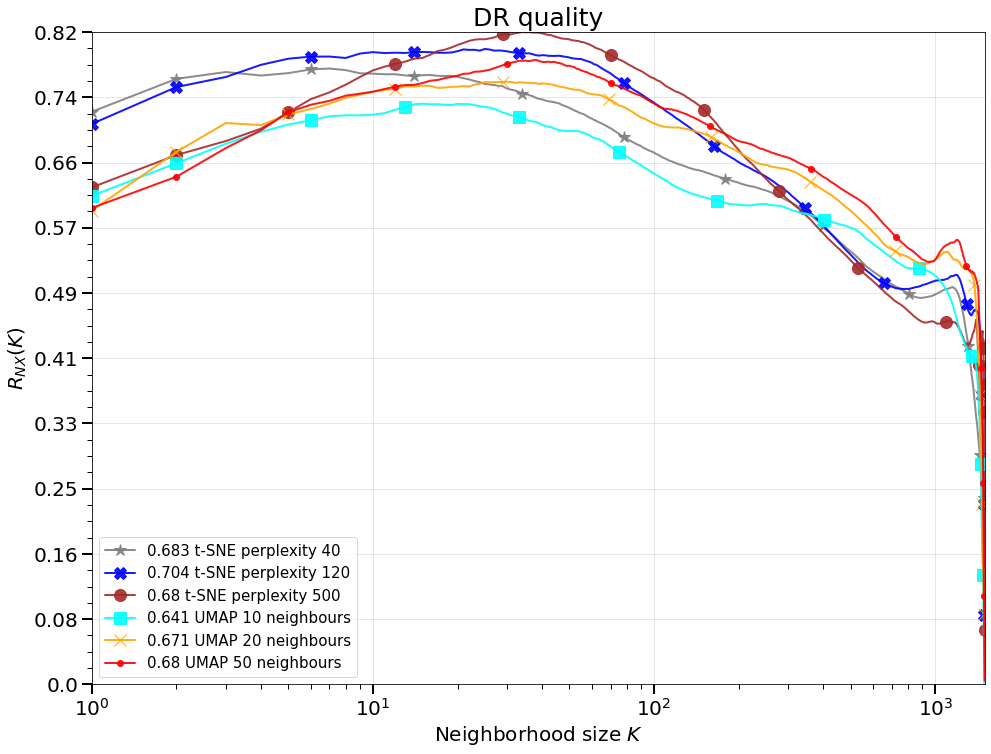

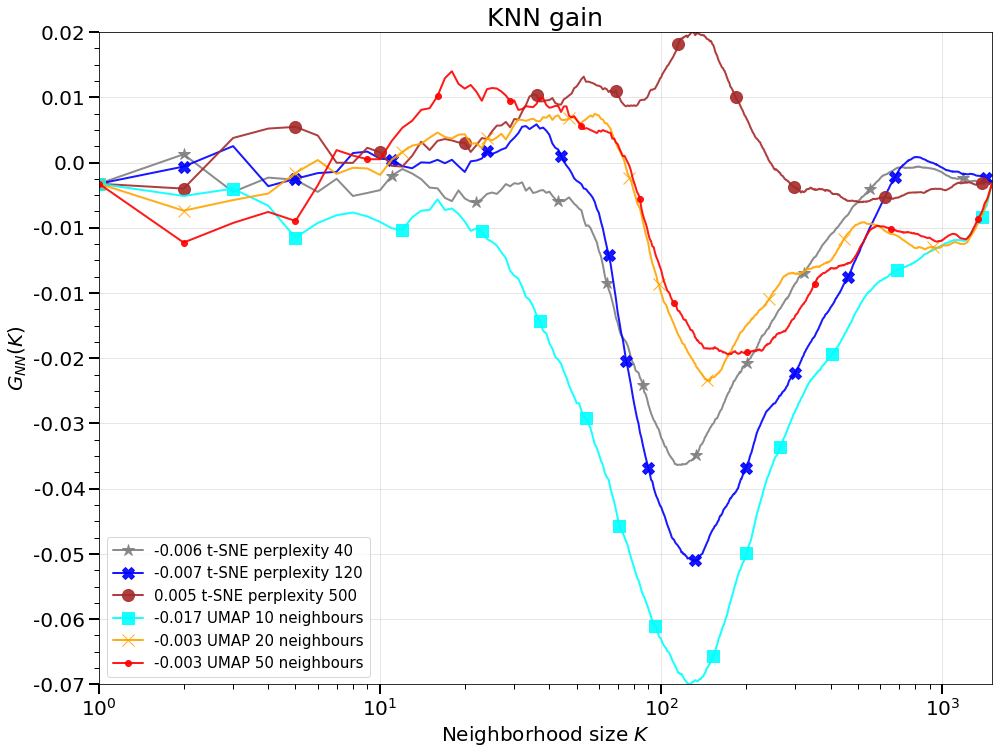

In [93]:
tsne_umap_metric.visualize()

Finished.


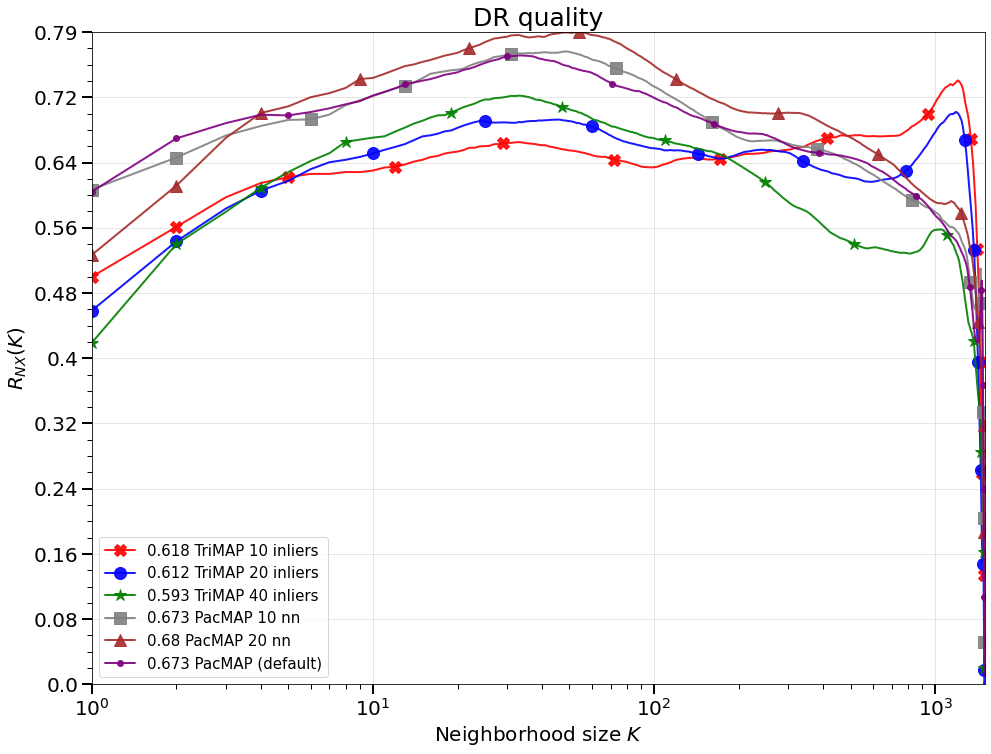

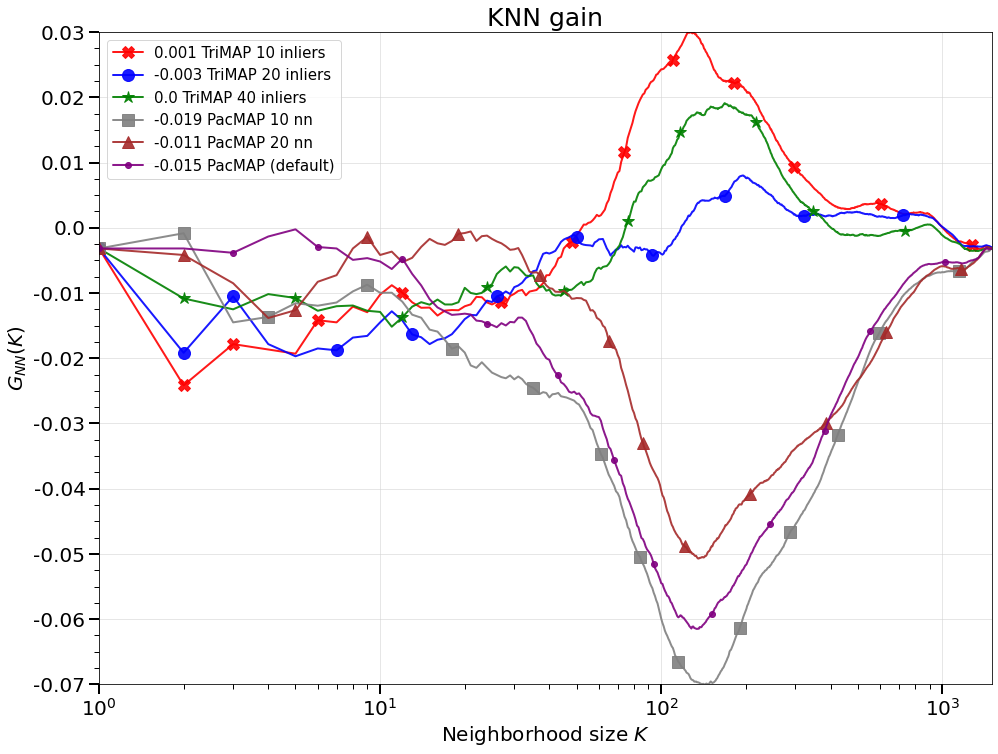

In [94]:
trimap_pacmap_metric.visualize()

Finished.


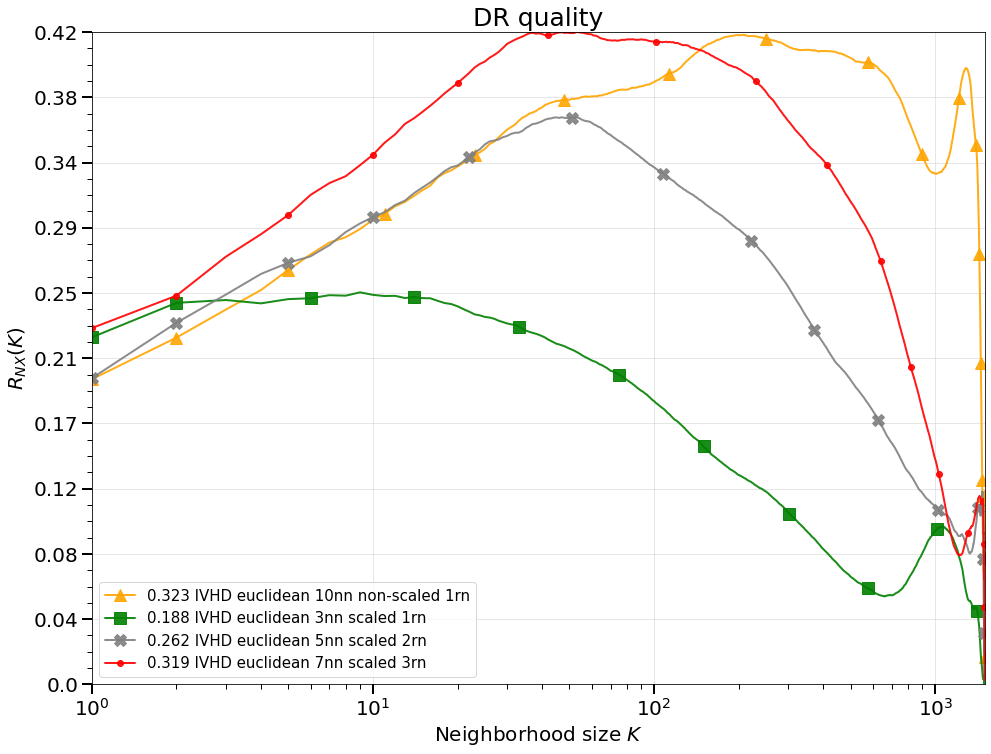

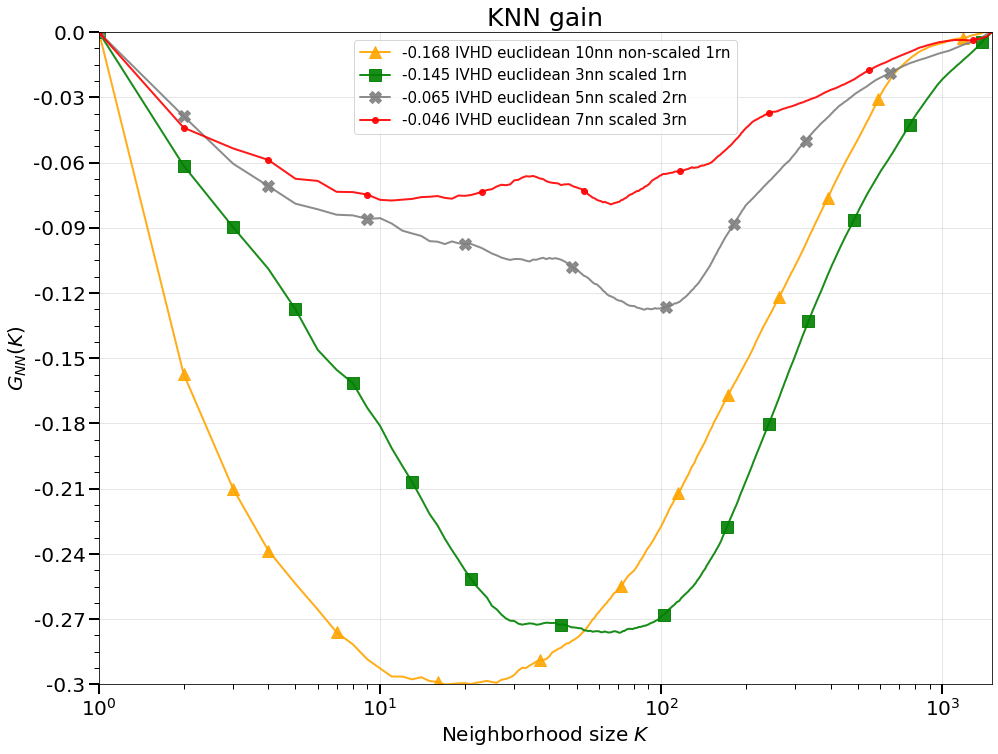

In [95]:
ivhd_cosine_metric.visualize()

Finished.


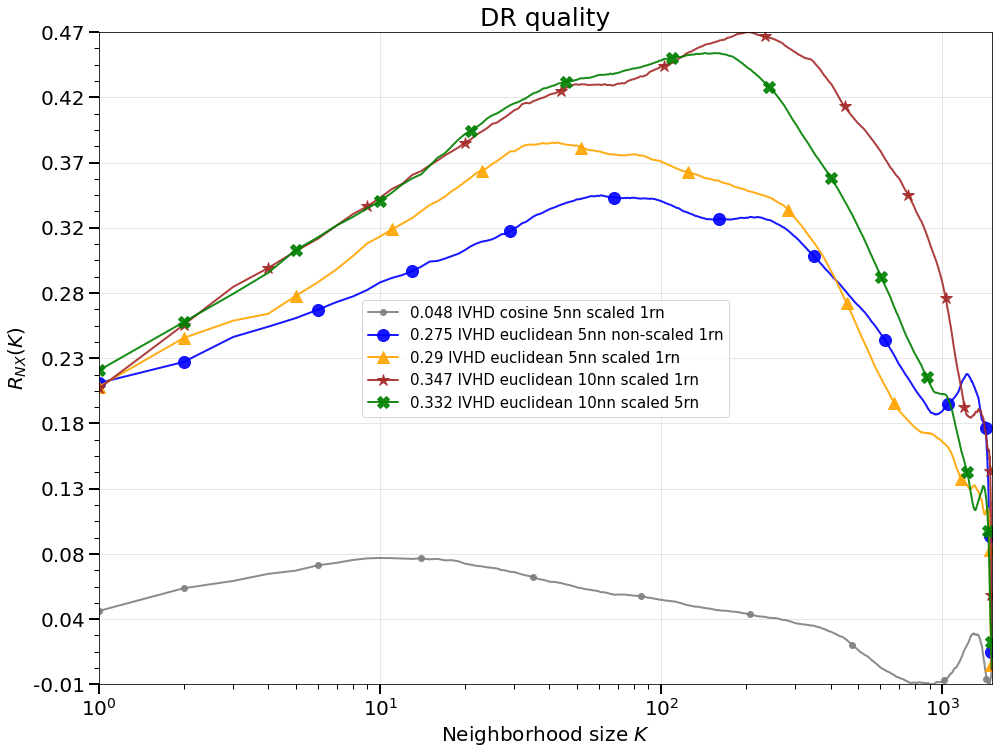

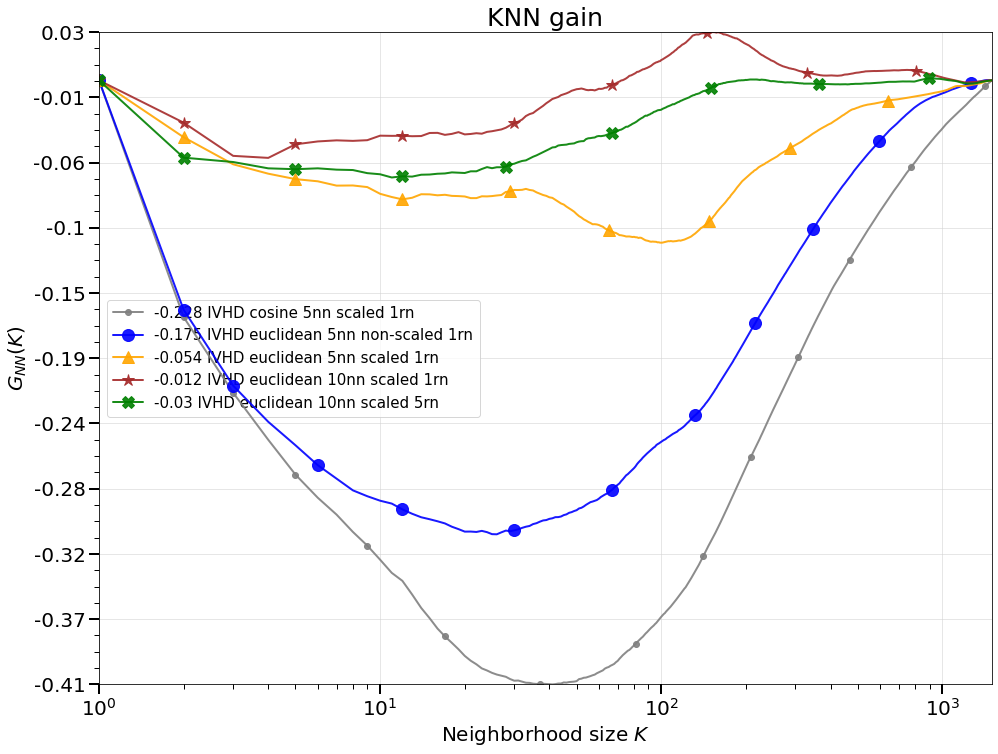

In [96]:
ivhd_euclidean_metric.visualize()

### Najlepsze wyniki z każdej metody

In [38]:
best_method_results = LocalMetric()

x_results_best = [x_120_tsne, x_20_umap, x_10_trimap, x_nn20_pacmap, ivhd_results[5]]
y_results_best = ["t-SNE perplexity 120", "UMAP 20 neighbours", "TriMAP 10 inliers", "PacMAP 20nn", "IVHD 10nn scaled 1rn"]

metric_calculate(best_method_results, x_results_best, y_results_best)

Calculating d_hd
t-SNE perplexity 120
Calculating d_hd
UMAP 20 neighbours
Calculating d_hd
TriMAP 10 inliers
Calculating d_hd
PacMAP 20nn
Calculating d_hd
IVHD 10nn scaled 1rn


Finished.


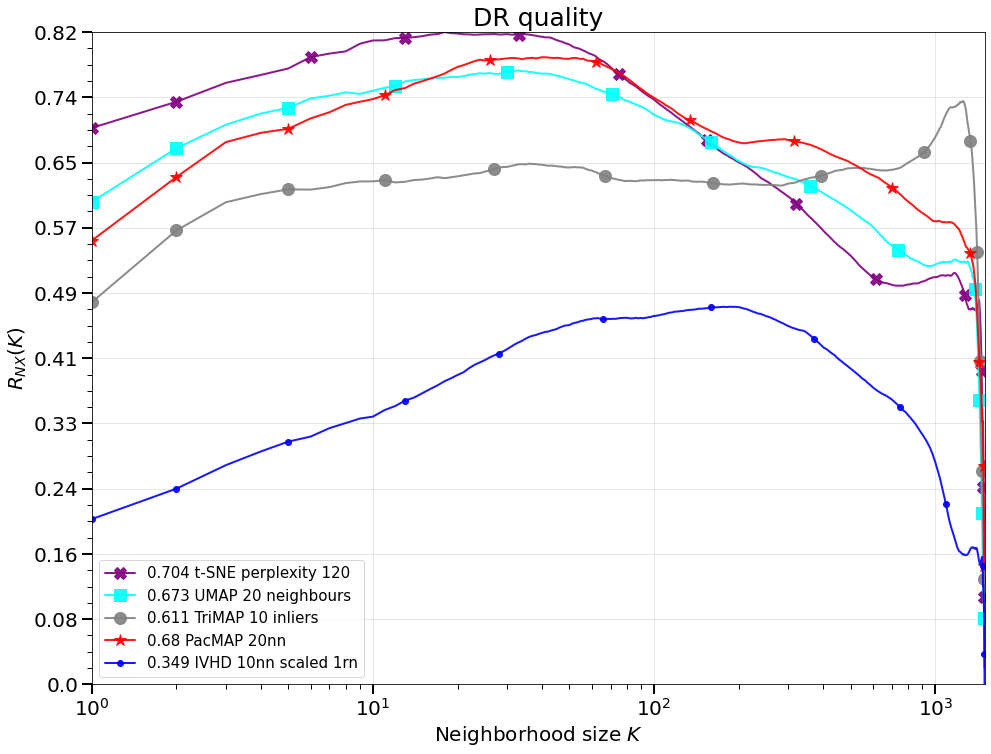

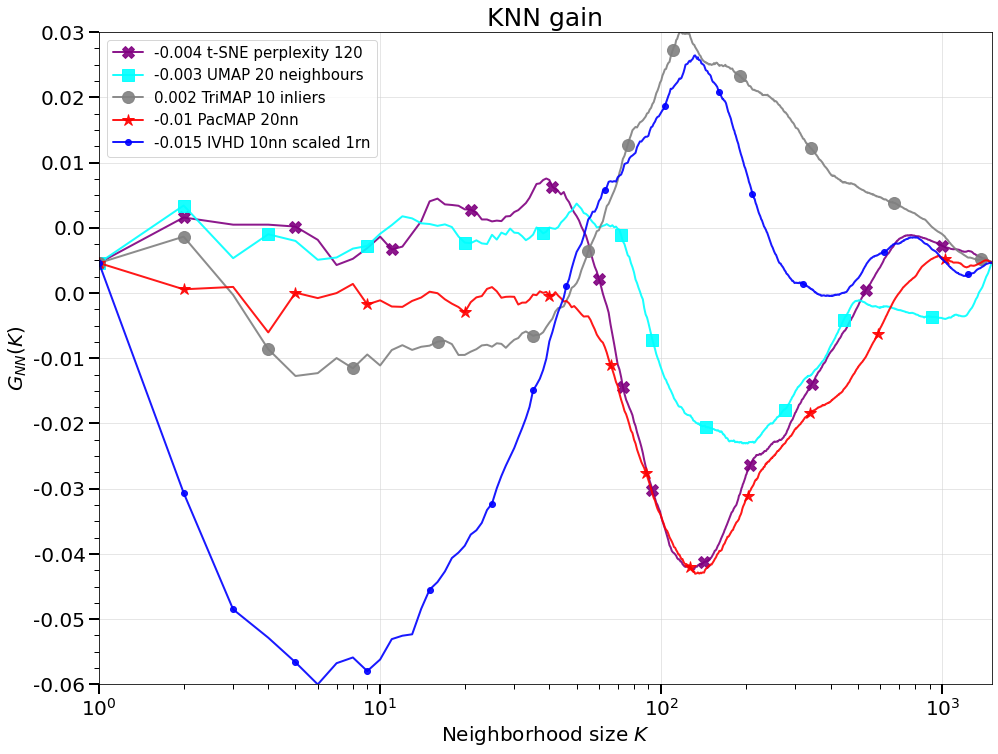

In [39]:
best_method_results.visualize()

## Trying other datasets

We will now try same methods on atrificially generated datasets
* ball
    - radius = 1
    - 30 dimensions
    - 2 classes 
        + d[0] < 0
        + d[0] > 0


* ball inside sphere inside sphere
    - 30 dimensions
    - 3 classes
        + ball with radius 1
        + sphere with radius 2
        + sphere with radius 3 

In [2]:
def random_ball(num_points, dimension, radius=1):
    random_directions = np.random.normal(size=(dimension,num_points))
    random_directions /= np.linalg.norm(random_directions, axis=0)
    random_radii = np.random.random(num_points) ** (1/dimension)
    return radius * (random_directions * random_radii).T

def random_sphere(num_points, dimension, radius=1):
    random_directions = np.random.normal(size=(dimension,num_points))
    random_directions /= np.linalg.norm(random_directions, axis=0)
    random_radii = 1
    return radius * (random_directions * random_radii).T

Let's see how those new datasets would look like in 3d

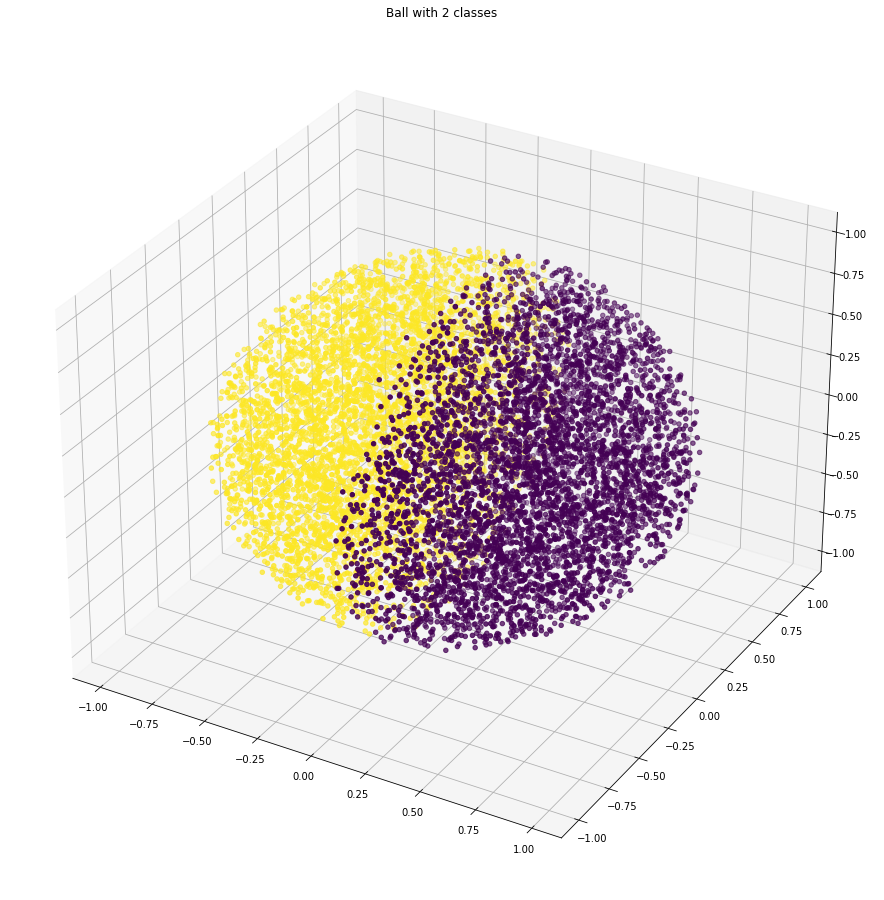

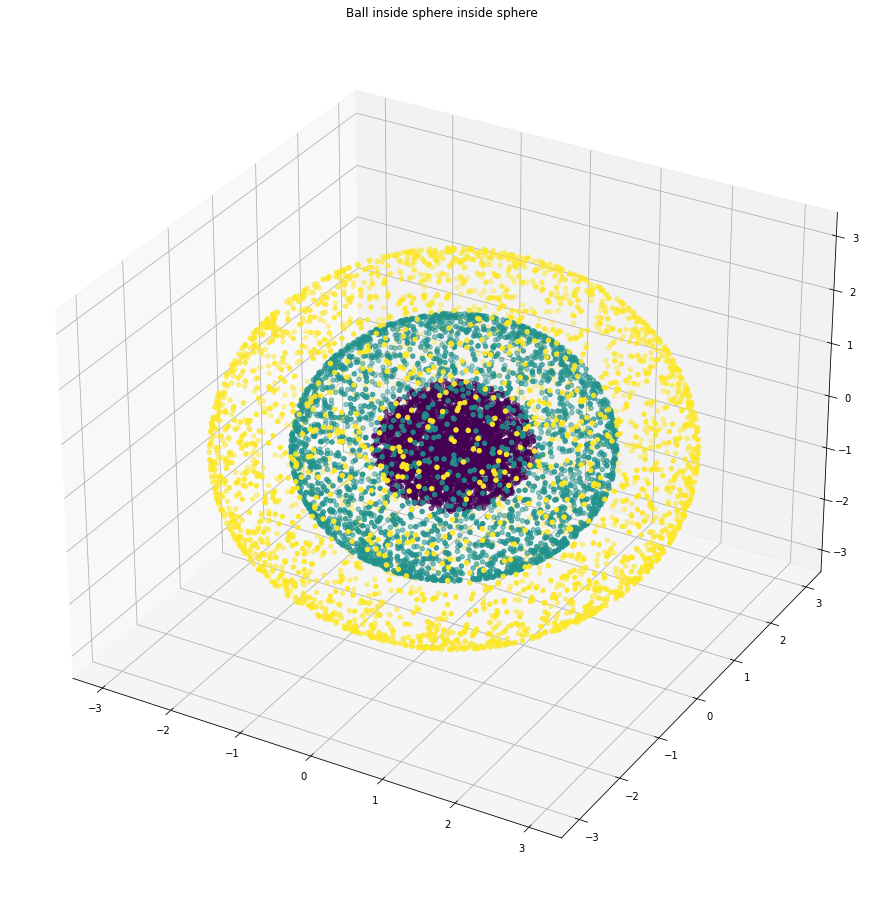

In [55]:
def plot_3d_scatter(points, ball_data, title):
    x = [p[0] for p in points]
    y = [p[1] for p in points]
    z = [p[2] for p in points]
    fig = plt.figure(figsize=(16,16))
    ax1 = fig.add_subplot(111, projection='3d')
    ax1.scatter(xs=x, ys=y, zs=z, c=ball_data)
    plt.title(title)
    plt.show()

# if you want to generate dataset with exact ammount of same class points 
# you can do it the way it's done in next cell instead 
ball_3d_10k = random_ball(10_000, 3, 1)
ball_3d_10k_classes = [1 if p[0] > 0 else 2 for p in ball_3d_10k]

ball_2spheres_3d_9k = np.concatenate([
    random_ball(3000, 3, 1),
    random_sphere(3000, 3, 2),
    random_sphere(3000, 3, 3)
])
ball_2spheres_3d_9k_classes = np.array([i for i in range(3) for _ in range(3000)])
plot_3d_scatter(ball_3d_10k, ball_3d_10k_classes, "Ball with 2 classes")
plot_3d_scatter(ball_2spheres_3d_9k, ball_2spheres_3d_9k_classes, "Ball inside sphere inside sphere")

In [76]:
# Uncomment if you want to generate random dataset - however .bin files for IVHD will have to be remade for the new datasets

# tmp_ball = random_ball(12000, 30, radius=1)
# tmp_ball1 = []
# tmp_ball2 = []
# for i in tmp_ball:
#     if i[0] > 0:
#         tmp_ball1.append(i)
#     else:
#         tmp_ball2.append(i)
# tmp_ball_res = np.concatenate([tmp_ball1[:5000], tmp_ball2[:5000]])
# np.savetxt("data/10k_ball.csv", tmp_ball_res, delimiter=",")

df_2class_ball = pd.read_csv('../data/10k_ball.csv', header=None)
min_max_scaler = preprocessing.MinMaxScaler()
df_2class_ball.head(15)
classes_2class_ball = np.array([i for i in range(2) for _ in range(5000)])
data_2class_ball = df_2class_ball.to_numpy()

data_2class_ball_scaled = min_max_scaler.fit_transform(df_2class_ball)
df_2class_ball_scaled = pd.DataFrame(data=data_2class_ball_scaled)
df_2class_ball_scaled.to_csv('../data/10k_ball_scaled.csv', header=False, index=False)
df_2class_ball_scaled.head(15)

df_classes_2class_ball = pd.DataFrame(classes_2class_ball)
filepath = Path('../data/10k_ball_labels.csv')
filepath.parent.mkdir(parents=True, exist_ok=True)  
df_classes_2class_ball.to_csv(filepath, header=False, index=False)

,0,1,2,3,4,5,6,7,8,9,...,20,21,22,23,24,25,26,27,28,29
0,0.553474,0.499490,0.345810,0.483189,0.341200,0.575751,0.591151,0.433132,0.696526,0.329724,...,0.625741,0.354650,0.494825,0.553909,0.803058,0.676535,0.672235,0.294083,0.772287,0.495012
1,0.529596,0.700590,0.470733,0.309821,0.318816,0.279133,0.712289,0.426230,0.412568,0.656093,...,0.279231,0.702188,0.540386,0.484450,0.597963,0.264983,0.295381,0.659493,0.421862,0.441927
2,0.583265,0.481287,0.585065,0.667813,0.754556,0.499537,0.460812,0.296884,0.580268,0.476242,...,0.459028,0.694415,0.412024,0.378122,0.384060,0.595612,0.319643,0.299911,0.324017,0.381381
3,0.499661,0.712475,0.717987,0.520682,0.719341,0.372409,0.333910,0.322574,0.459964,0.370046,...,0.581267,0.565663,0.547451,0.541685,0.312407,0.208340,0.577955,0.311173,0.763823,0.516949
4,0.559394,0.137798,0.695643,0.632652,0.642260,0.385555,0.362225,0.506100,0.528603,0.441507,...,0.690054,0.459513,0.594130,0.564172,0.454135,0.604527,0.419864,0.282461,0.556163,0.467607
5,0.699940,0.473916,0.407290,0.489428,0.514698,0.448245,0.744453,0.427730,0.530107,0.669136,...,0.630683,0.289063,0.745818,0.361651,0.546593,0.649751,0.518958,0.399767,0.249454,0.509559
6,0.639464,0.574962,0.538369,0.467639,0.370883,0.157763,0.610159,0.307638,0.429726,0.608641,...,0.622193,0.408556,0.613237,0.331877,0.471809,0.426783,0.519050,0.451454,0.322992,0.360713
7,0.518729,0.629138,0.436802,0.647147,0.447149,0.347435,0.527184,0.501607,0.532450,0.582359,...,0.263373,0.427419,0.584210,0.724209,0.521929,0.402270,0.765323,0.640513,0.541266,0.385076
8,0.586821,0.248762,0.341271,0.499589,0.201820,0.391578,0.383303,0.356609,0.632848,0.268350,...,0.455353,0.492878,0.593735,0.566836,0.698632,0.452387,0.549889,0.598799,0.614329,0.407673
9,0.546680,0.271690,0.449124,0.508765,0.493596,0.554193,0.452251,0.206823,0.658322,0.417085,...,0.772809,0.562342,0.439035,0.488421,0.685853,0.532344,0.538824,0.519113,0.552880,0.541927


In [72]:
# Uncomment if you want to generate random dataset - however .bin files for IVHD will have to be remade for the new datasets

# tmp_ball_ds2 = random_ball(5000, 30, radius=1)
# tmp_sphere_1 = random_sphere(5000, 30, radius=2)
# tmp_sphere_2 = random_sphere(5000, 30, radius=3)
# tmp_res = np.concatenate([tmp_ball_ds2, tmp_sphere_1, tmp_sphere_2])
# np.savetxt("data/ball_2spheres_15k.csv", tmp_res, delimiter=",")

df_ball_2spheres = pd.read_csv('../data/ball_2spheres_15k.csv', header=None)
min_max_scaler = preprocessing.MinMaxScaler()
classes_ball_2spheres = np.array([i for i in range(3) for _ in range(5000)])

data_ball_2spheres_scaled = min_max_scaler.fit_transform(df_ball_2spheres)
df_ball_2spheres_scaled = pd.DataFrame(data=data_ball_2spheres_scaled)
df_ball_2spheres_scaled.to_csv('../data/ball_2spheres_15k_scaled.csv', header=False, index=False)
df_ball_2spheres_scaled.head(15)

df_classes_ball_2spheres = pd.DataFrame(classes_ball_2spheres)
filepath = Path('../data/ball_2spheres_15k_labels.csv')
filepath.parent.mkdir(parents=True, exist_ok=True)  
df_classes_ball_2spheres.to_csv(filepath, header=False, index=False)

,0,1,2,3,4,5,6,7,8,9,...,20,21,22,23,24,25,26,27,28,29
0,0.375008,0.385957,0.521071,0.469200,0.439885,0.531762,0.586285,0.535363,0.574886,0.518158,...,0.506081,0.510002,0.433183,0.467557,0.466582,0.468044,0.526179,0.557250,0.534452,0.556586
1,0.379560,0.510392,0.515908,0.578056,0.488031,0.440524,0.494314,0.513290,0.616739,0.520142,...,0.425202,0.541413,0.514549,0.536554,0.525522,0.560444,0.510661,0.542804,0.581980,0.405934
2,0.538958,0.456637,0.545712,0.532183,0.587834,0.534716,0.454424,0.394243,0.553390,0.497359,...,0.435341,0.534793,0.530643,0.481978,0.544385,0.484748,0.530219,0.411228,0.512808,0.482283
3,0.413146,0.459402,0.513208,0.599150,0.449288,0.502901,0.470697,0.476784,0.536184,0.605279,...,0.533723,0.503694,0.604256,0.454627,0.510477,0.524259,0.528370,0.499257,0.461238,0.530238
4,0.481214,0.491126,0.462112,0.571597,0.524336,0.413395,0.538637,0.558795,0.574663,0.514249,...,0.474030,0.496458,0.513430,0.410785,0.455387,0.445285,0.539095,0.543744,0.505419,0.509273
5,0.443003,0.506168,0.608636,0.447758,0.526770,0.483365,0.542940,0.540055,0.503553,0.537219,...,0.393934,0.545371,0.471312,0.564302,0.458746,0.406624,0.542754,0.488326,0.462656,0.540528
6,0.430822,0.468526,0.531869,0.535980,0.548130,0.543949,0.507129,0.453104,0.411807,0.424820,...,0.523002,0.545221,0.453085,0.554432,0.502498,0.420608,0.516408,0.464310,0.581753,0.466301
7,0.483669,0.510550,0.449063,0.567671,0.539433,0.544313,0.541849,0.446120,0.549844,0.427912,...,0.567356,0.529220,0.523367,0.495897,0.516632,0.559482,0.482693,0.486109,0.642551,0.509342
8,0.595771,0.557715,0.600417,0.590023,0.521126,0.453474,0.539783,0.474850,0.509944,0.622585,...,0.516222,0.484132,0.503798,0.440164,0.516129,0.518823,0.507668,0.529225,0.585118,0.499241
9,0.482782,0.482824,0.518149,0.557229,0.450997,0.463174,0.537495,0.515558,0.522195,0.540825,...,0.440944,0.586980,0.482206,0.394083,0.532151,0.495568,0.582635,0.488788,0.602137,0.513105


In [15]:
def plot_2d_scatter(X, y, c):
    fig, plot = plt.subplots()
    fig.set_size_inches(16, 16)

    for i in range(c):
        digit_indices = (y == i)

        dim1 = X[digit_indices, 0]
        dim2 = X[digit_indices, 1]
        plot.scatter(dim1, dim2, label=f"'{i}'")

    plot.set_xticks(())
    plot.set_yticks(())

    plt.tight_layout()
    plt.legend()
    plt.show()

## Time to analyze both new datasets with all methods we used for mammoth dataset

### t-SNE

In [84]:
ball_2c_tsne_p40 = TSNE(n_components=2, init="pca", learning_rate='auto', perplexity=40)
ball_2c_tsne_p120 = TSNE(n_components=2, init="pca", learning_rate='auto', perplexity=120)
ball_2c_tsne_p500 = TSNE(n_components=2, init="pca", learning_rate='auto', perplexity=500)

ball_2c_x_40_tsne = ball_2c_tsne_p40.fit_transform(data_2class_ball_scaled)
ball_2c_x_120_tsne = ball_2c_tsne_p120.fit_transform(data_2class_ball_scaled)
ball_2c_x_500_tsne = ball_2c_tsne_p500.fit_transform(data_2class_ball_scaled)

ball_2spheres_tsne_p40 = TSNE(n_components=2, init="pca", learning_rate='auto', perplexity=40)
ball_2spheres_tsne_p120 = TSNE(n_components=2, init="pca", learning_rate='auto', perplexity=120)
ball_2spheres_tsne_p500 = TSNE(n_components=2, init="pca", learning_rate='auto', perplexity=500)

ball_2spheres_x_40_tsne = ball_2spheres_tsne_p40.fit_transform(data_ball_2spheres_scaled)
ball_2spheres_x_120_tsne = ball_2spheres_tsne_p120.fit_transform(data_ball_2spheres_scaled)
ball_2spheres_x_500_tsne = ball_2spheres_tsne_p500.fit_transform(data_ball_2spheres_scaled)

/home/ewer/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(
/home/ewer/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(
/home/ewer/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(
/home/ewer/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


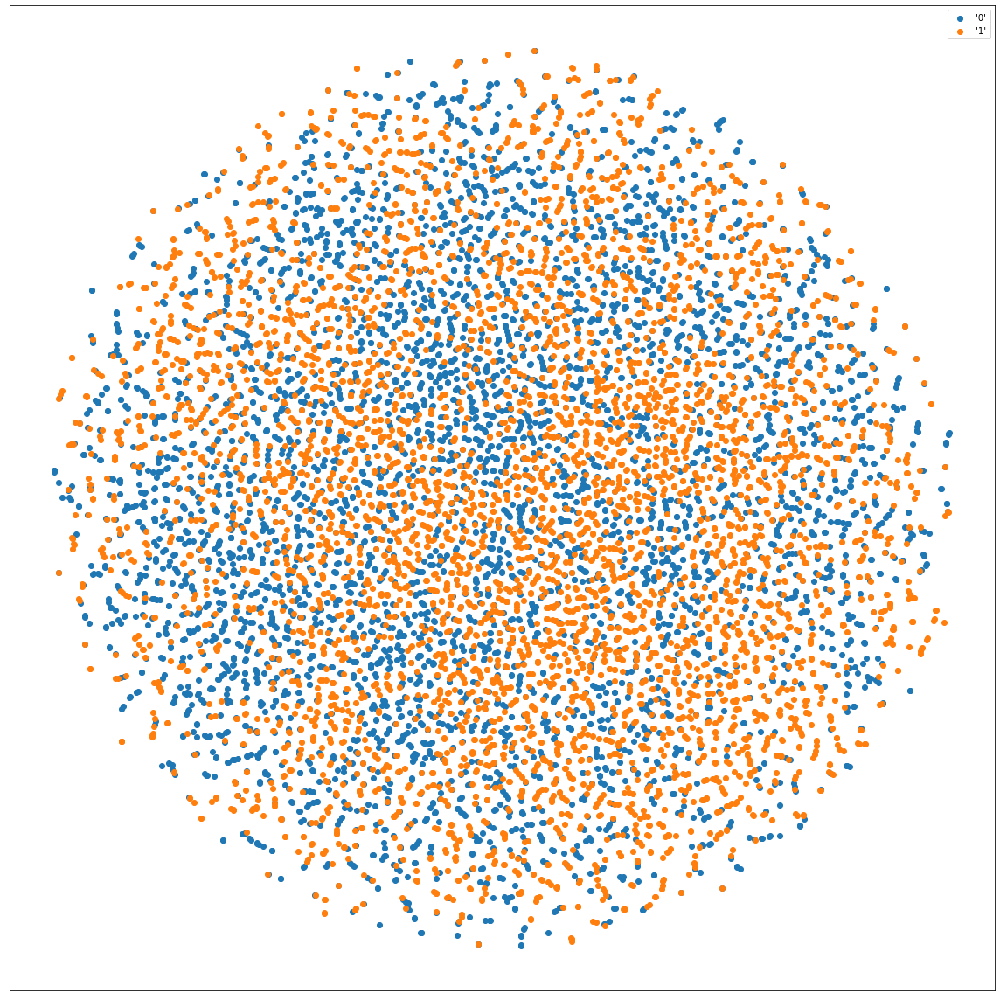

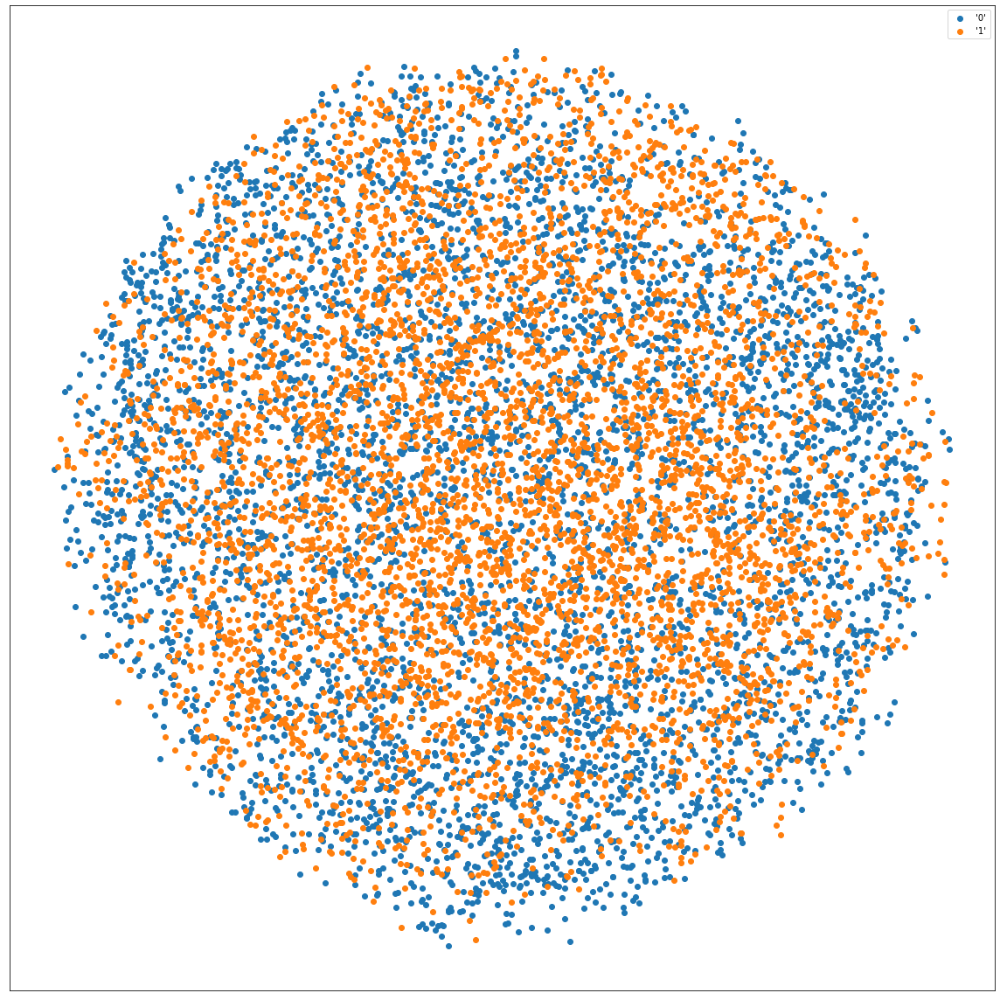

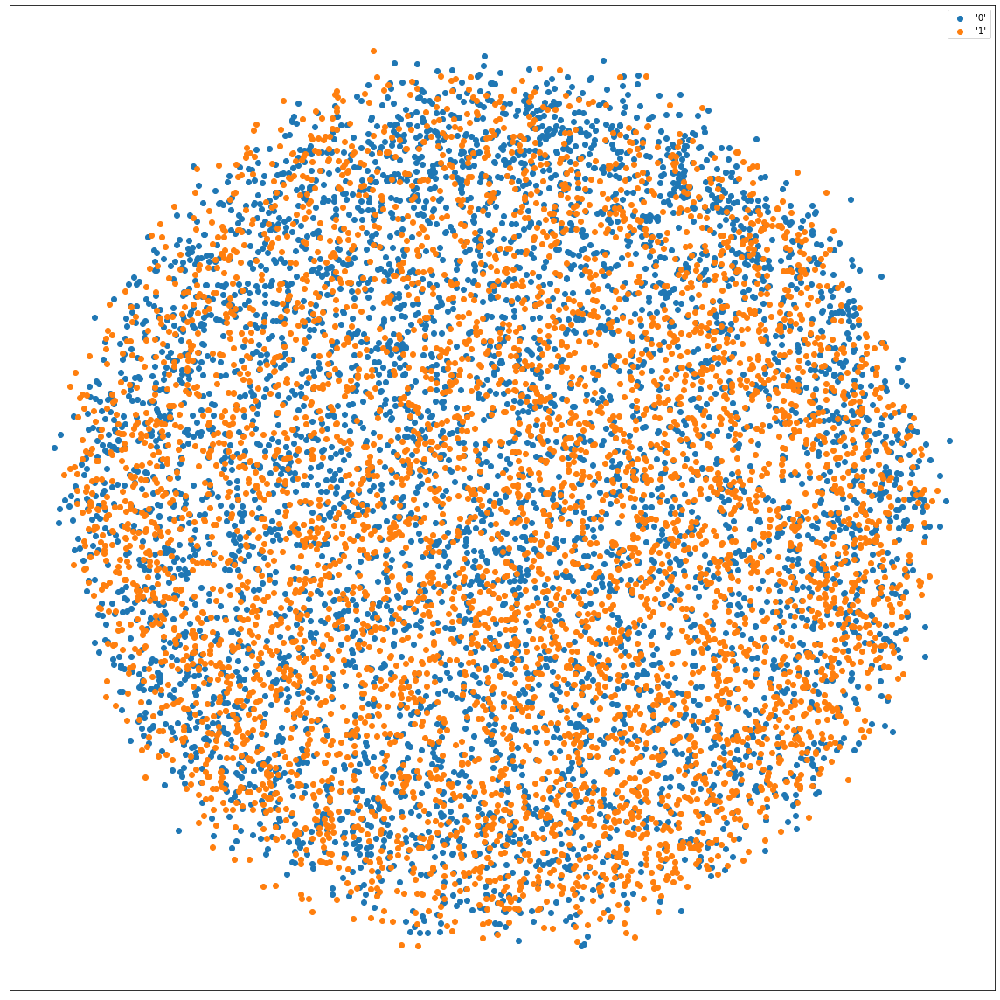

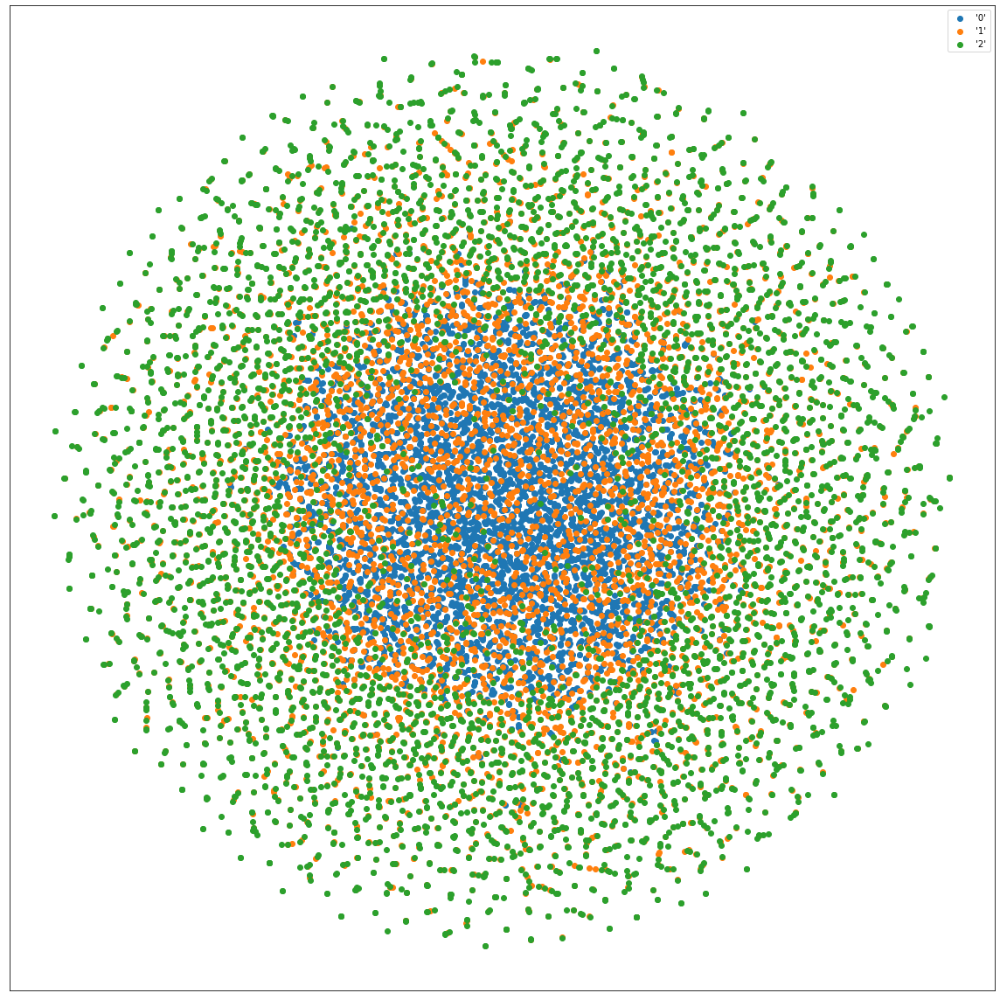

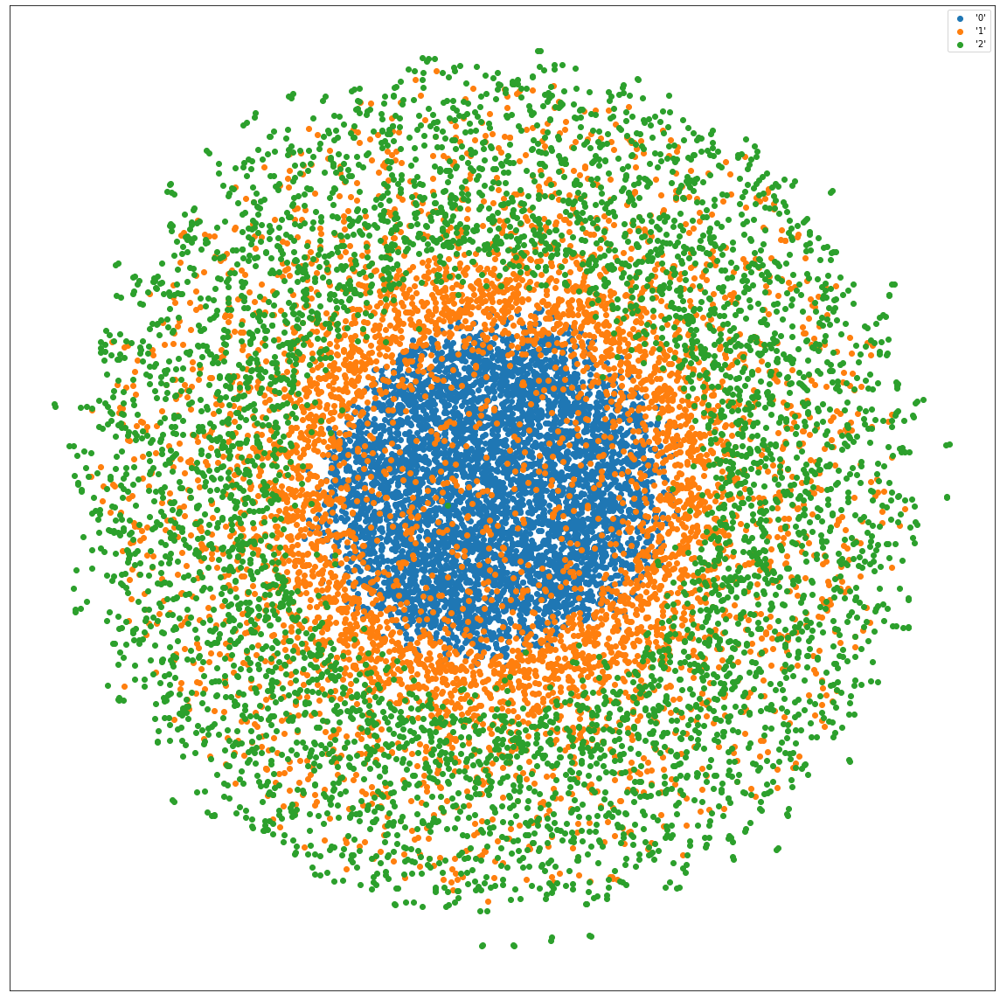

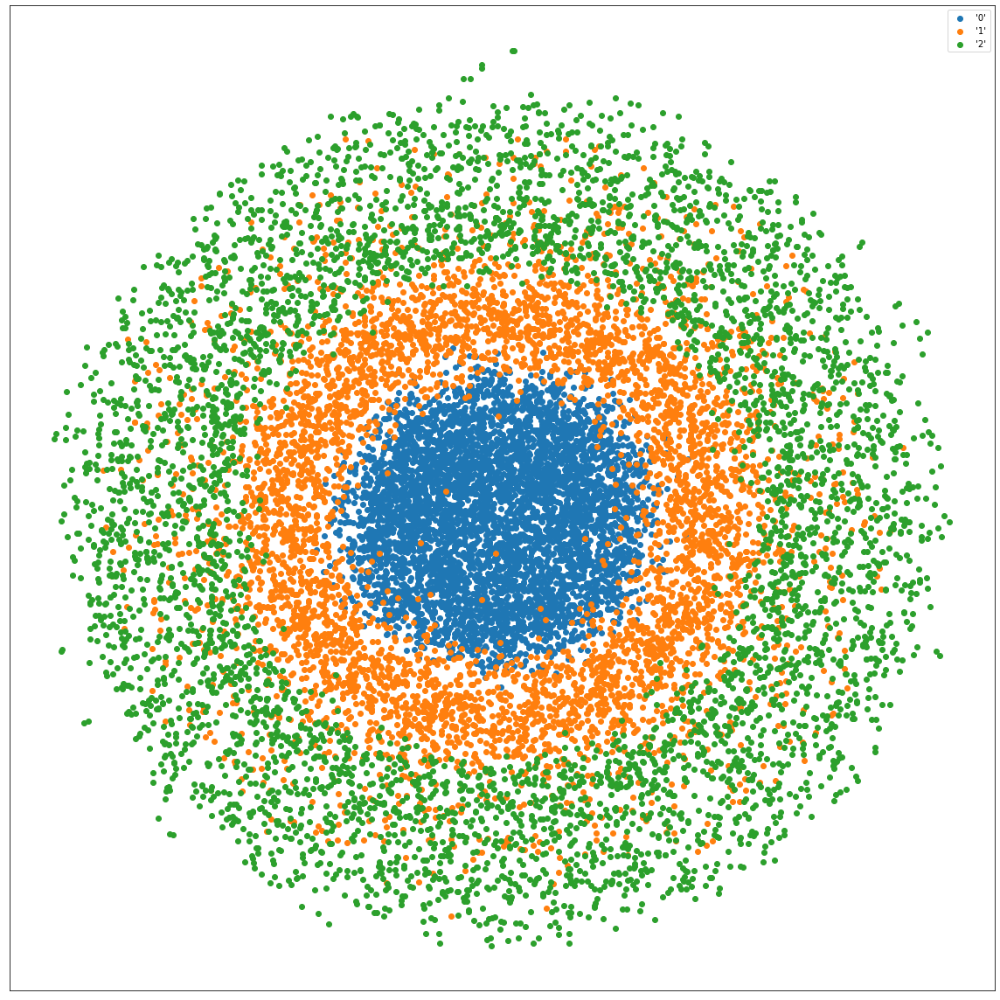

In [85]:
plot_2d_scatter(ball_2c_x_40_tsne, classes_2class_ball, 2)
plot_2d_scatter(ball_2c_x_120_tsne, classes_2class_ball, 2)
plot_2d_scatter(ball_2c_x_500_tsne, classes_2class_ball, 2)

plot_2d_scatter(ball_2spheres_x_40_tsne, classes_ball_2spheres, 3)
plot_2d_scatter(ball_2spheres_x_120_tsne, classes_ball_2spheres, 3)
plot_2d_scatter(ball_2spheres_x_500_tsne, classes_ball_2spheres, 3)

### UMAP

In [86]:
ball_2c_umap_nn10 = umap.UMAP(n_neighbors=10)
ball_2c_umap_nn20 = umap.UMAP(n_neighbors=20)
ball_2c_umap_nn50 = umap.UMAP(n_neighbors=50)

ball_2c_x_10_umap = ball_2c_umap_nn10.fit_transform(data_2class_ball_scaled)
ball_2c_x_20_umap = ball_2c_umap_nn20.fit_transform(data_2class_ball_scaled)
ball_2c_x_50_umap = ball_2c_umap_nn50.fit_transform(data_2class_ball_scaled)

ball_2spheres_umap_nn10 = umap.UMAP(n_neighbors=10)
ball_2spheres_umap_nn20 = umap.UMAP(n_neighbors=20)
ball_2spheres_umap_nn50 = umap.UMAP(n_neighbors=50)

ball_2spheres_x_10_umap = ball_2spheres_umap_nn10.fit_transform(data_ball_2spheres_scaled)
ball_2spheres_x_20_umap = ball_2spheres_umap_nn20.fit_transform(data_ball_2spheres_scaled)
ball_2spheres_x_50_umap = ball_2spheres_umap_nn50.fit_transform(data_ball_2spheres_scaled)

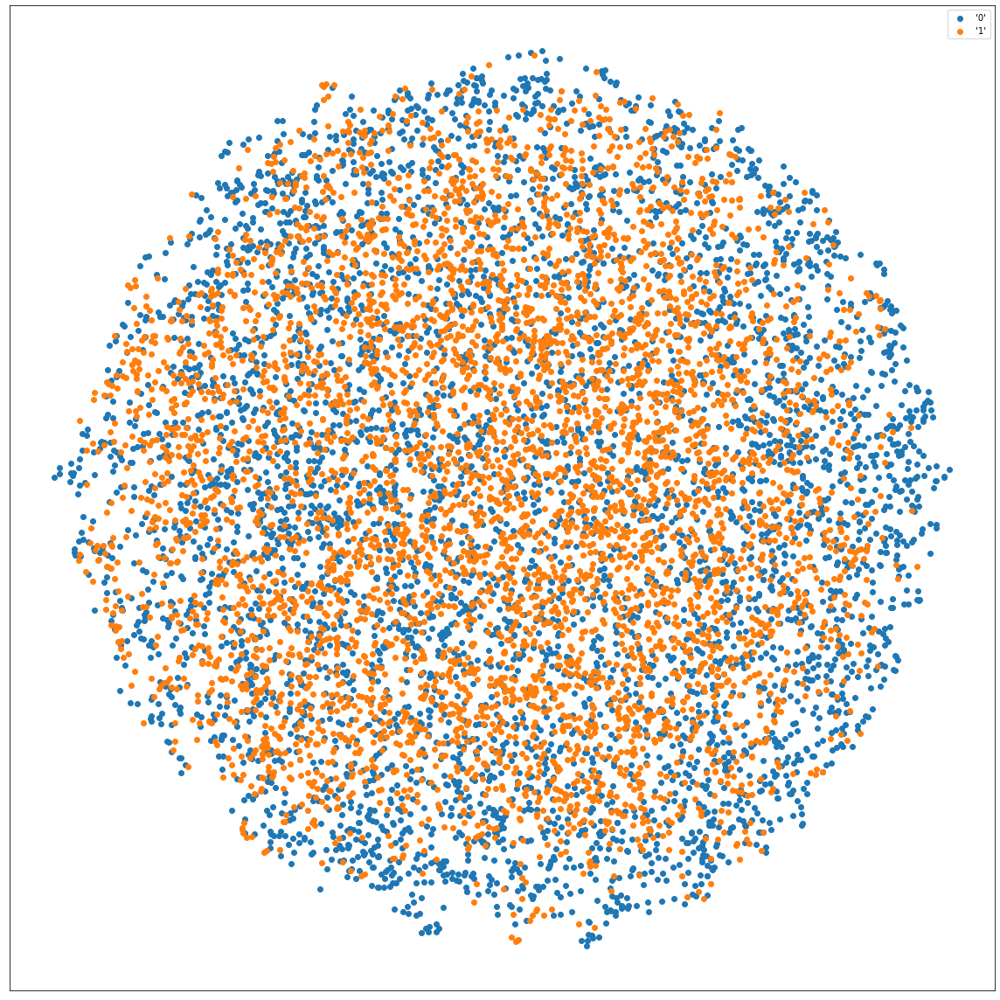

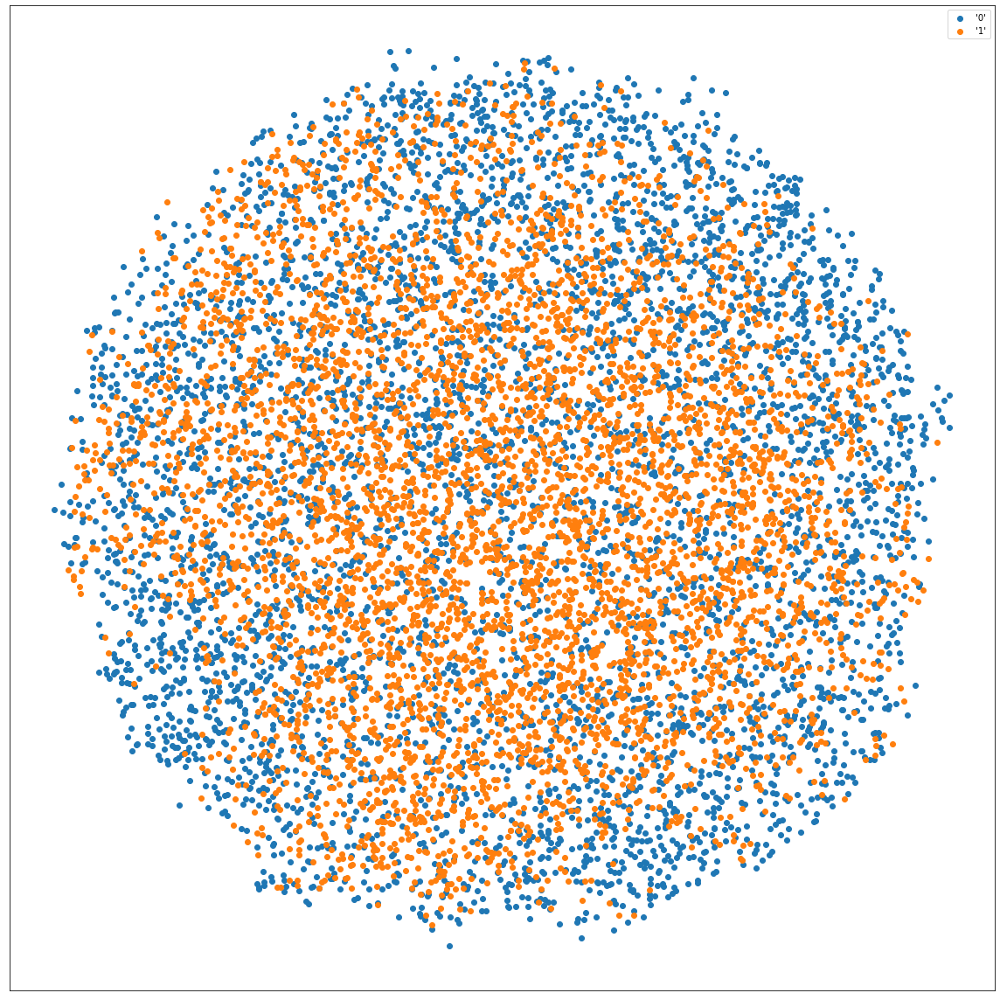

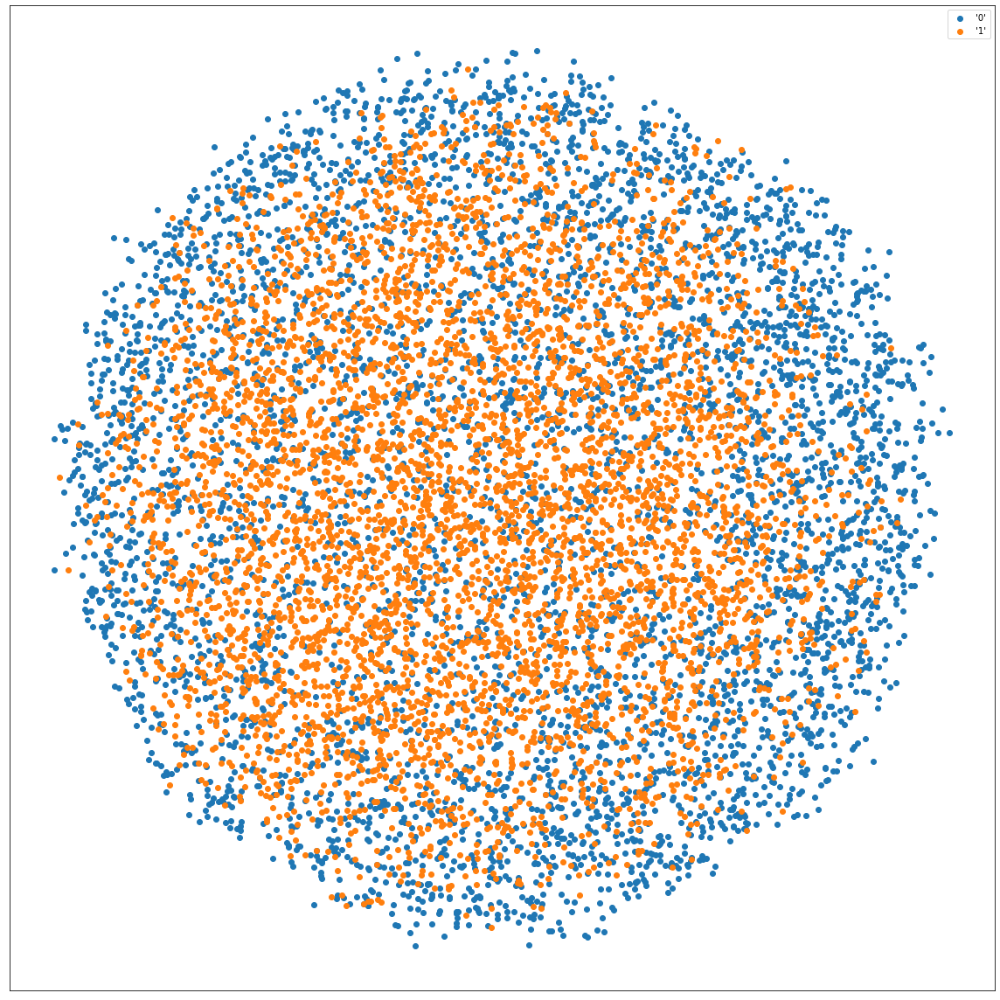

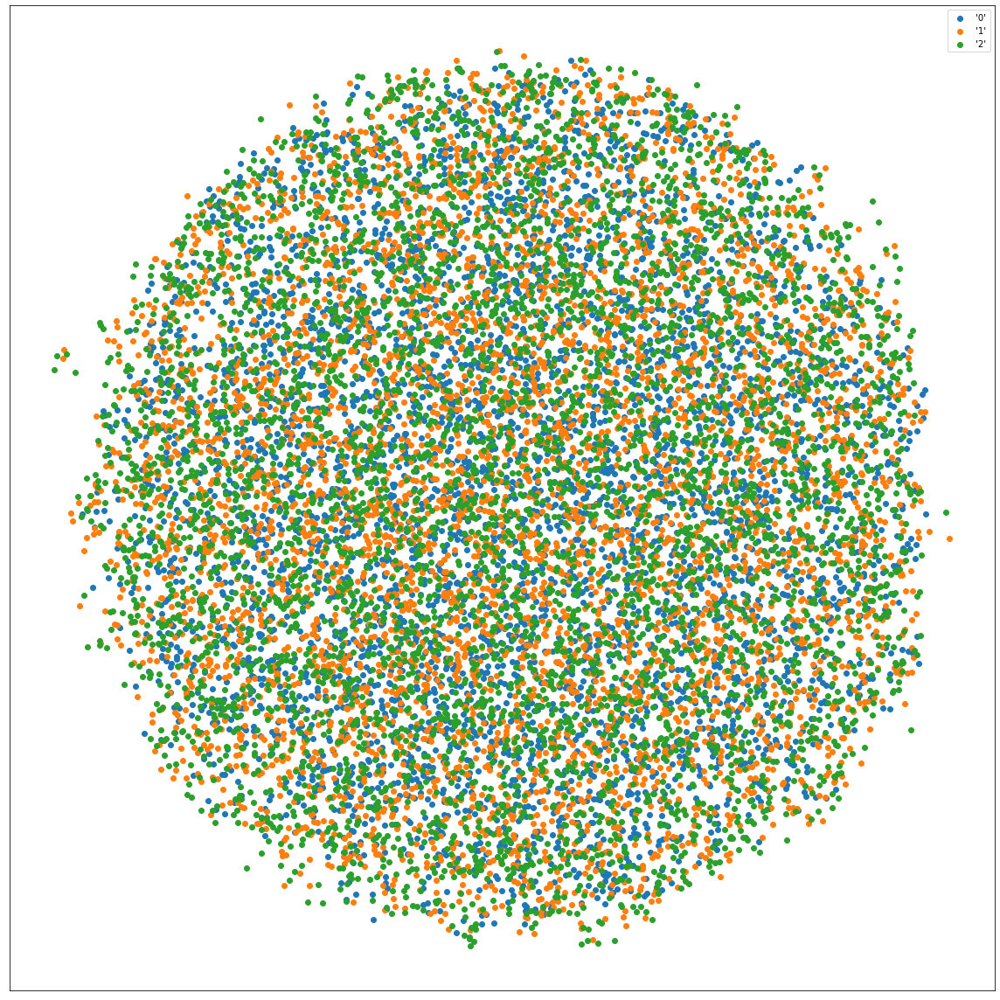

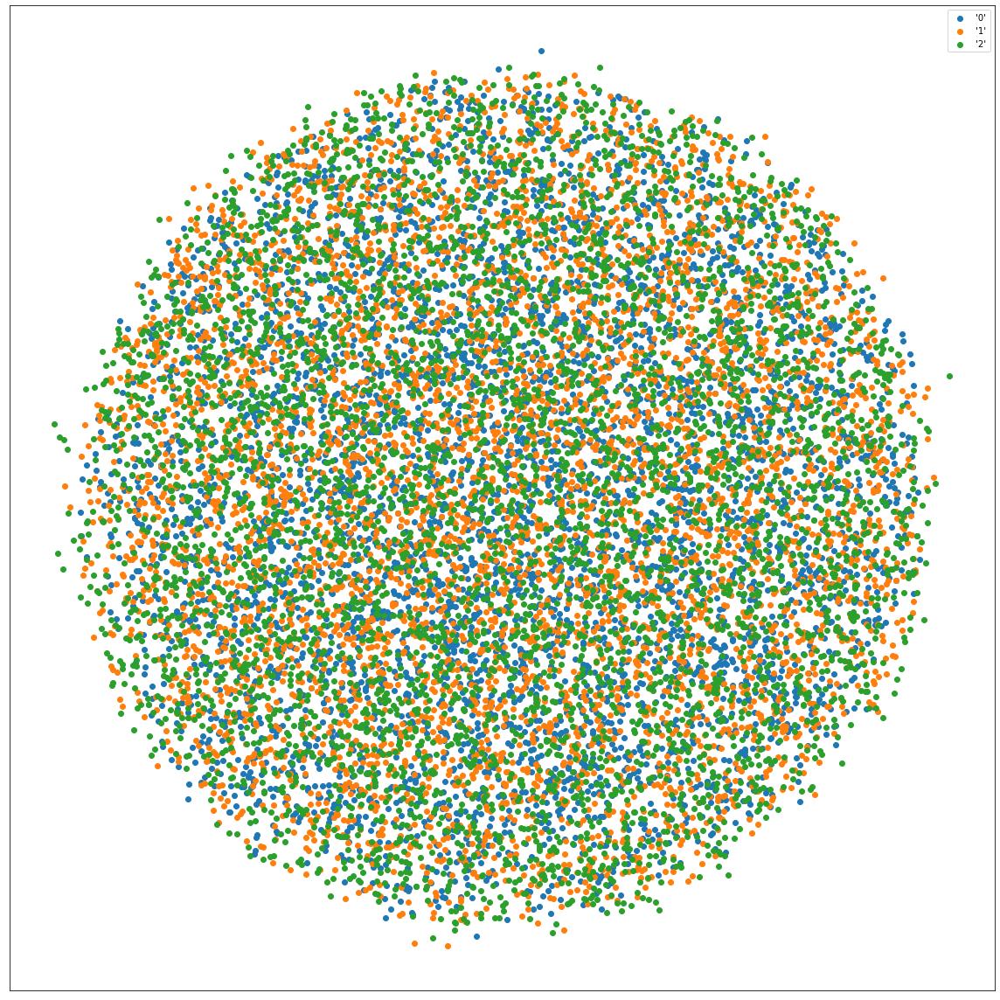

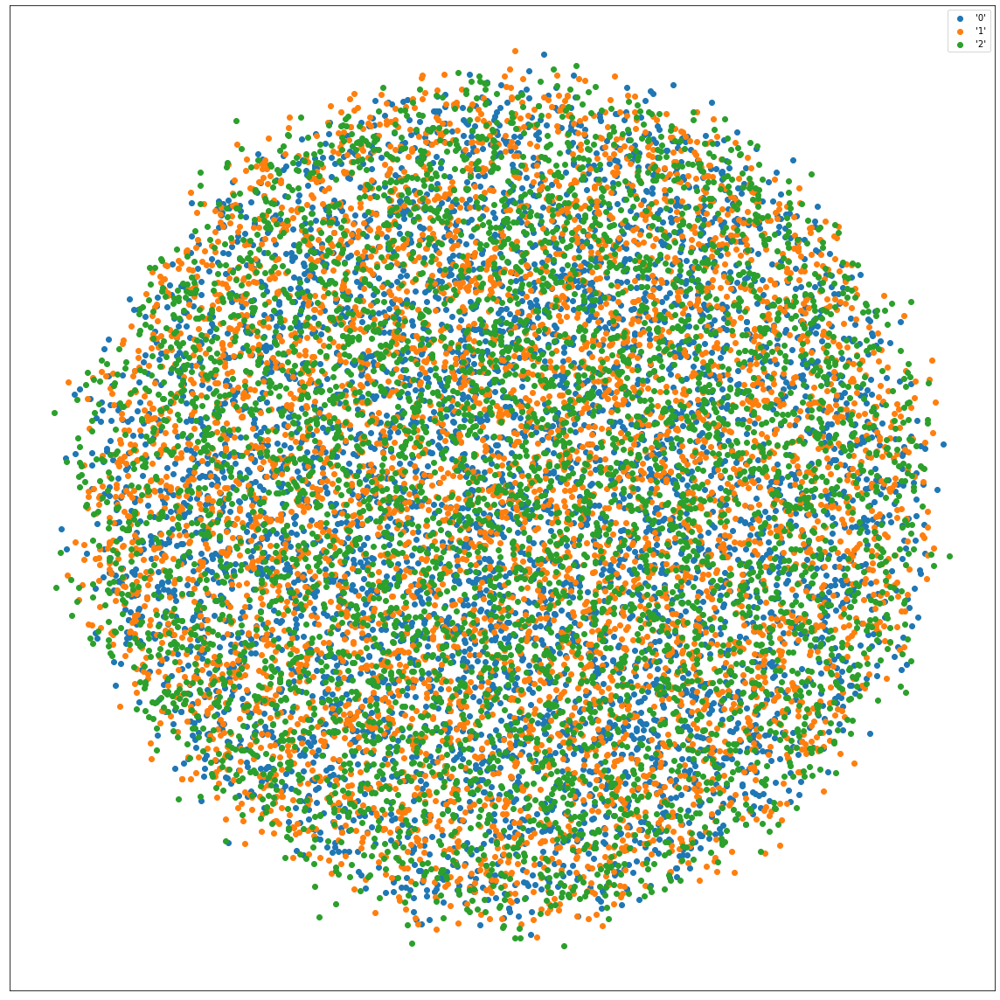

In [87]:
plot_2d_scatter(ball_2c_x_10_umap, classes_2class_ball, 2)
plot_2d_scatter(ball_2c_x_20_umap, classes_2class_ball, 2)
plot_2d_scatter(ball_2c_x_50_umap, classes_2class_ball, 2)

plot_2d_scatter(ball_2spheres_x_10_umap, classes_ball_2spheres, 3)
plot_2d_scatter(ball_2spheres_x_20_umap, classes_ball_2spheres, 3)
plot_2d_scatter(ball_2spheres_x_50_umap, classes_ball_2spheres, 3)

### TriMAP

In [97]:
ball_2c_trimap_ni10 = trimap.TRIMAP(n_inliers=10,
                            n_outliers=5,
                            n_random=5)
ball_2c_trimap_ni20 = trimap.TRIMAP(n_inliers=20,
                            n_outliers=5,
                            n_random=5)
ball_2c_trimap_ni40 = trimap.TRIMAP(n_inliers=40,
                            n_outliers=5,
                            n_random=5)

ball_2c_x_10_trimap = ball_2c_trimap_ni10.fit_transform(data_2class_ball_scaled)
ball_2c_x_20_trimap = ball_2c_trimap_ni20.fit_transform(data_2class_ball_scaled)
ball_2c_x_40_trimap = ball_2c_trimap_ni40.fit_transform(data_2class_ball_scaled)

ball_2spheres_trimap_ni10 = trimap.TRIMAP(n_inliers=10,
                            n_outliers=5,
                            n_random=5)
ball_2spheres_trimap_ni20 = trimap.TRIMAP(n_inliers=20,
                            n_outliers=5,
                            n_random=5)
ball_2spheres_trimap_ni40 = trimap.TRIMAP(n_inliers=40,
                            n_outliers=5,
                            n_random=5)

ball_2spheres_x_10_trimap = ball_2spheres_trimap_ni10.fit_transform(data_ball_2spheres_scaled)
ball_2spheres_x_20_trimap = ball_2spheres_trimap_ni20.fit_transform(data_ball_2spheres_scaled)
ball_2spheres_x_40_trimap = ball_2spheres_trimap_ni40.fit_transform(data_ball_2spheres_scaled)

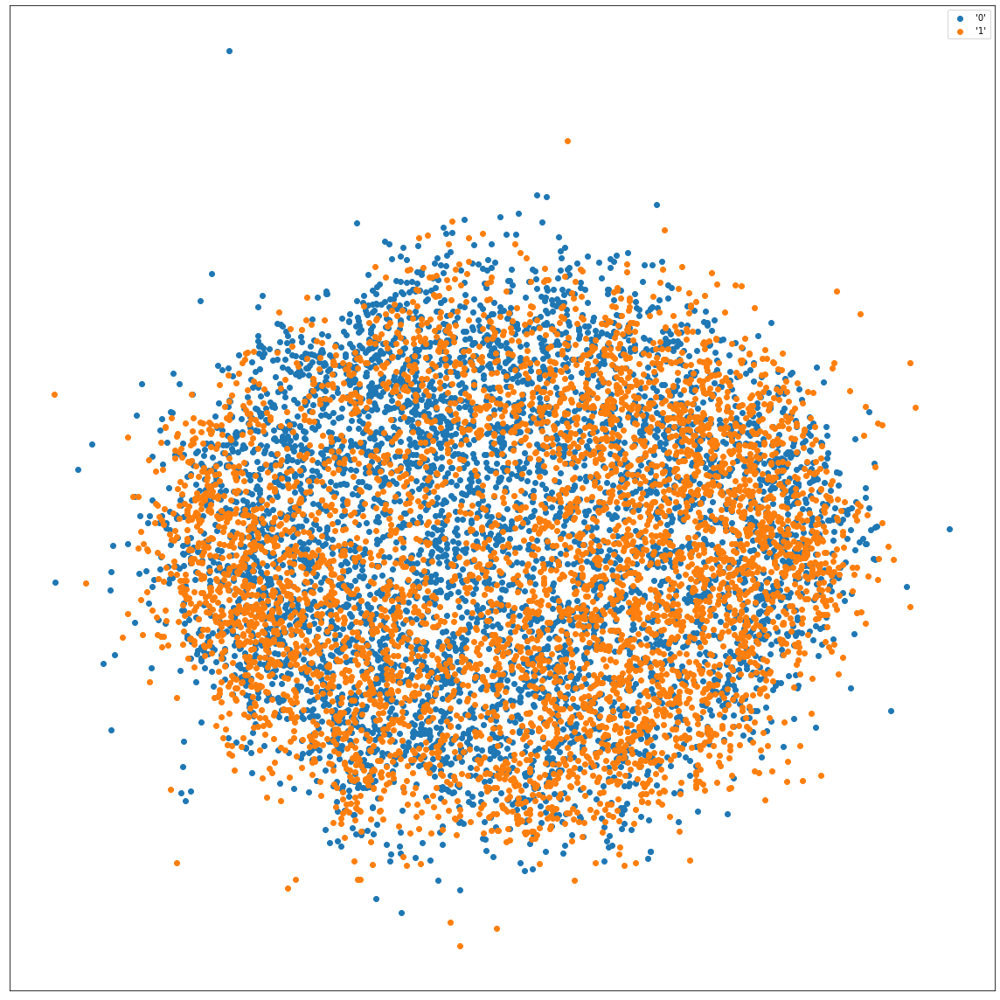

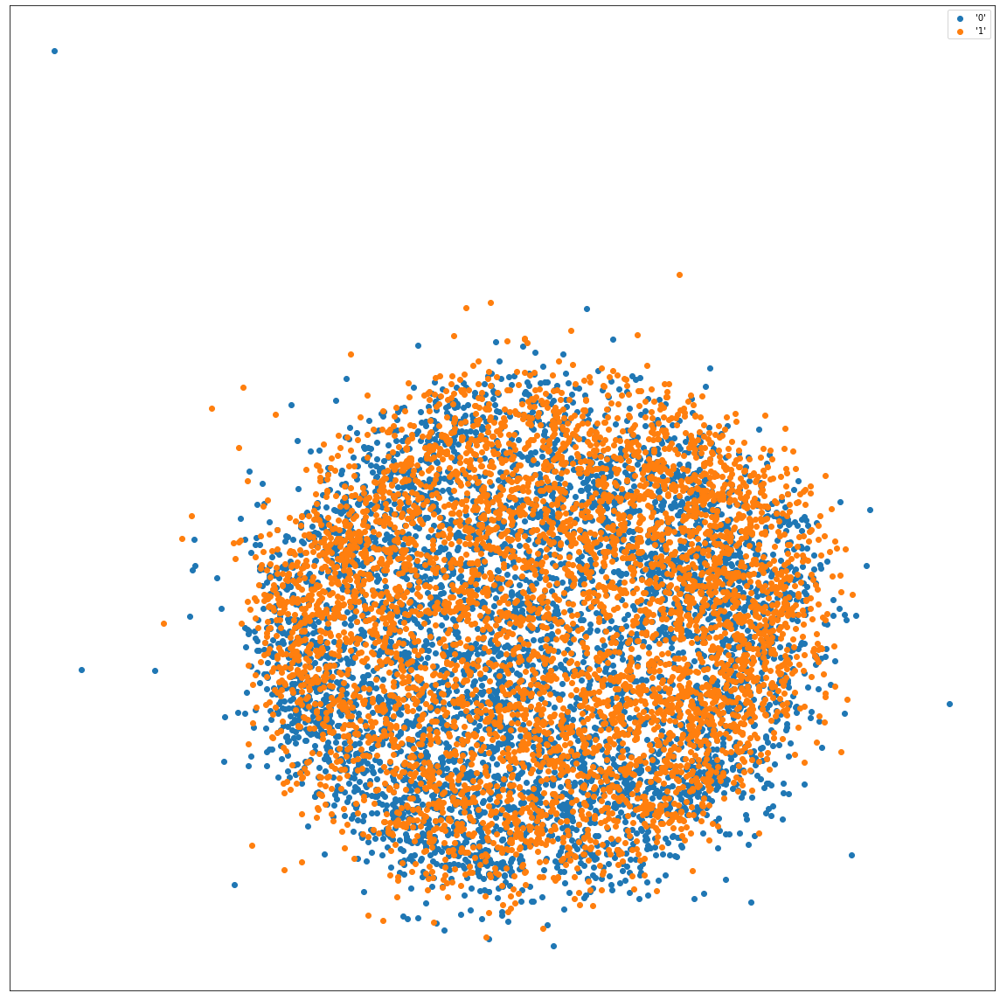

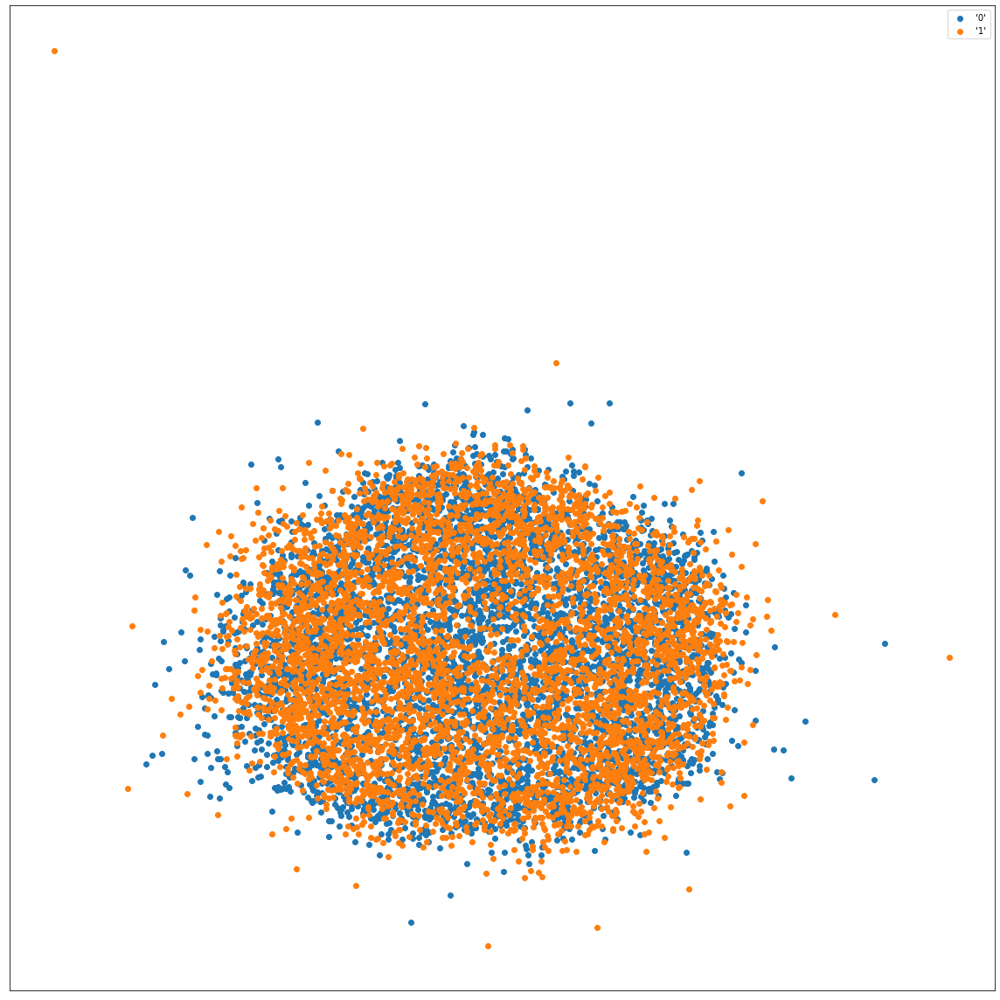

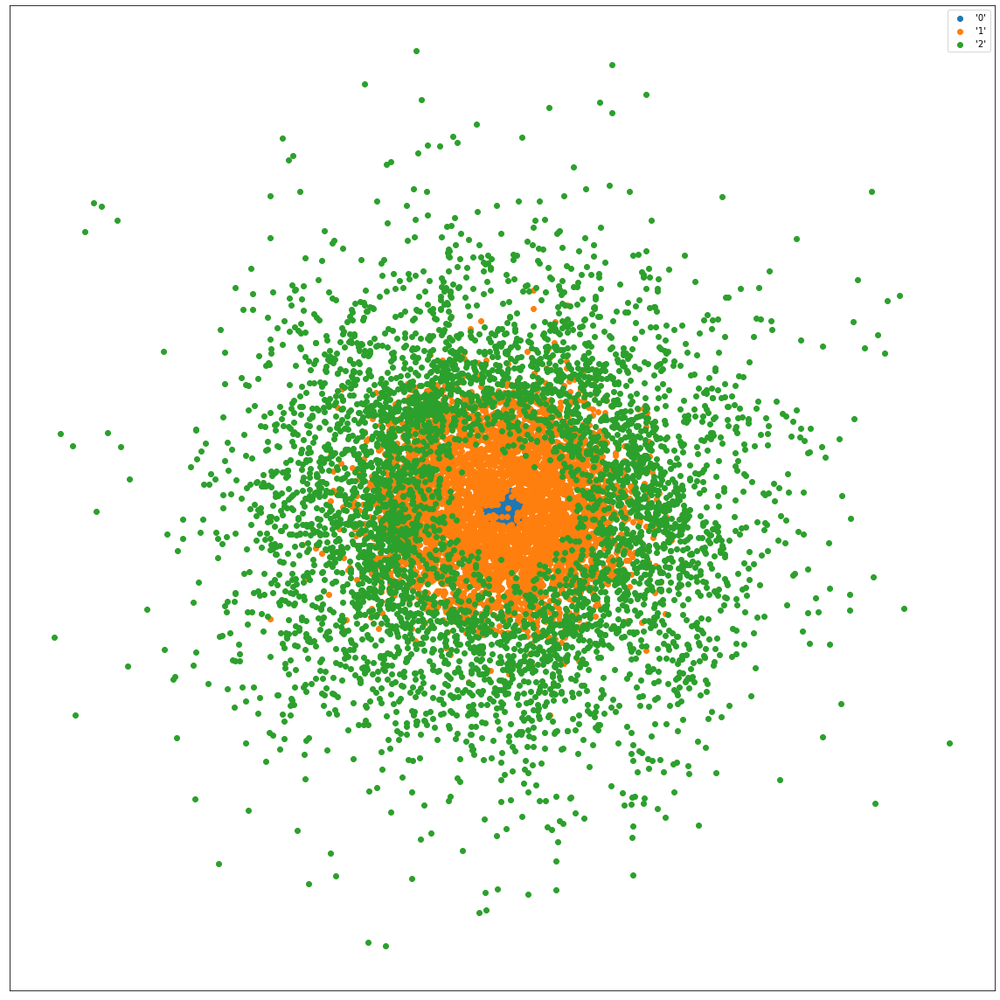

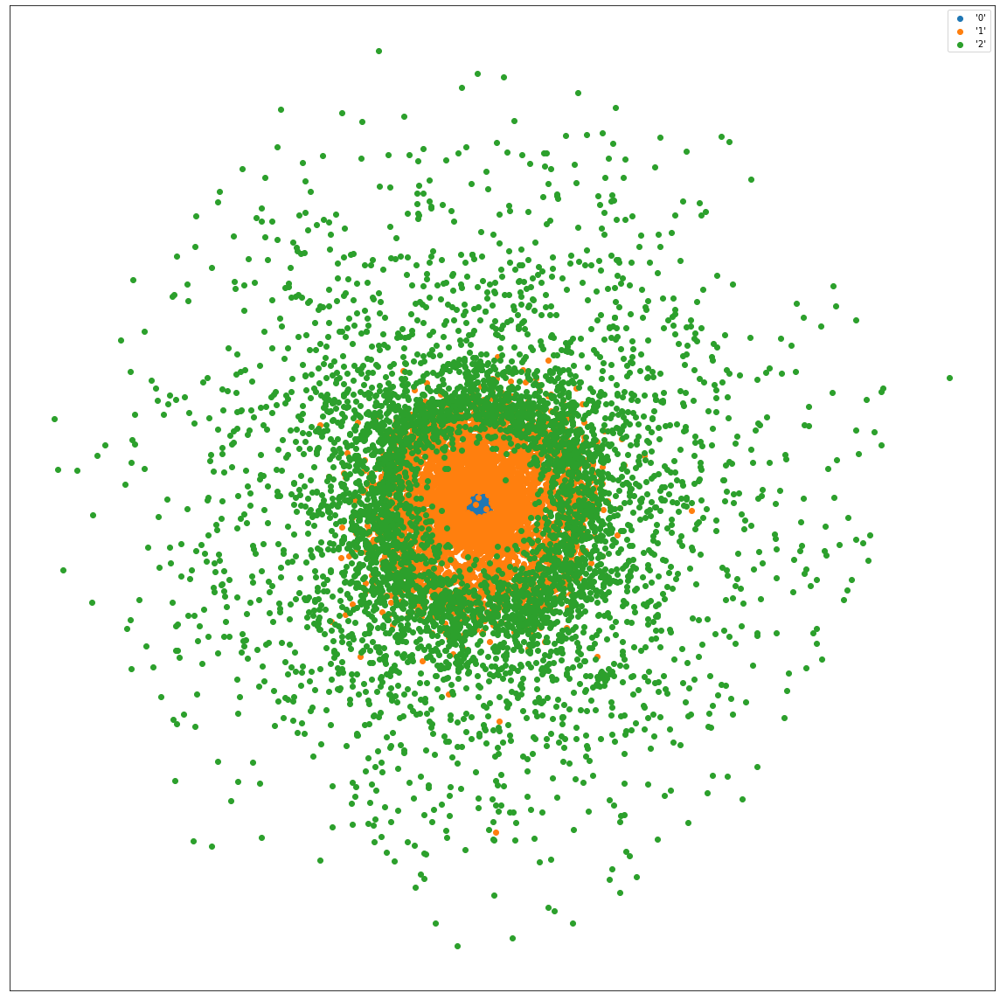

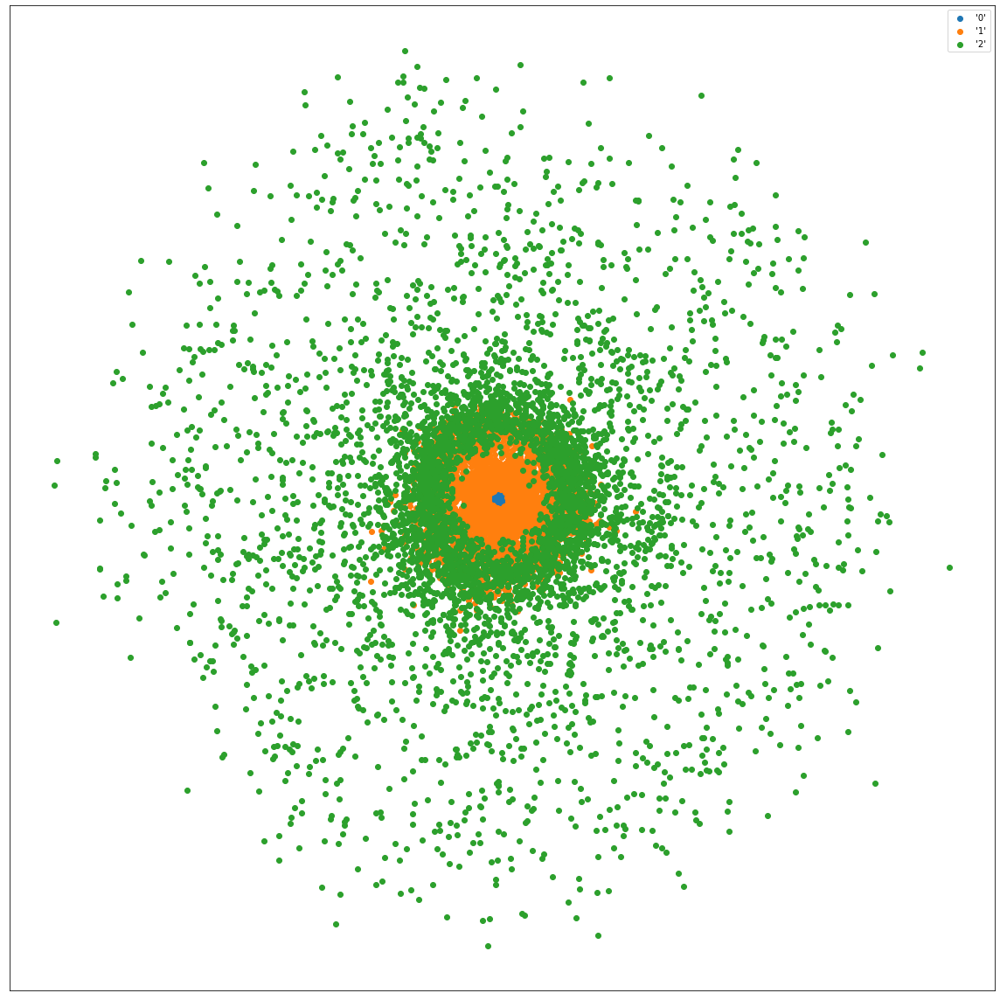

In [98]:
plot_2d_scatter(ball_2c_x_10_trimap, classes_2class_ball, 2)
plot_2d_scatter(ball_2c_x_20_trimap, classes_2class_ball, 2)
plot_2d_scatter(ball_2c_x_40_trimap, classes_2class_ball, 2)

plot_2d_scatter(ball_2spheres_x_10_trimap, classes_ball_2spheres, 3)
plot_2d_scatter(ball_2spheres_x_20_trimap, classes_ball_2spheres, 3)
plot_2d_scatter(ball_2spheres_x_40_trimap, classes_ball_2spheres, 3)

### PacMAP

In [99]:
ball_2c_pacmapm = pacmap.PaCMAP(n_neighbors=None, MN_ratio=0.5, FP_ratio=2.0)
ball_2c_pacmap_nn10 = pacmap.PaCMAP(n_neighbors=10, MN_ratio=0.5, FP_ratio=2.0)
ball_2c_pacmap_nn20 = pacmap.PaCMAP(n_neighbors=20, MN_ratio=0.5, FP_ratio=2.0)

ball_2c_x_pacmap = ball_2c_pacmapm.fit_transform(data_2class_ball_scaled, init="pca")
ball_2c_x_nn10_pacmap = ball_2c_pacmap_nn10.fit_transform(data_2class_ball_scaled, init="pca") 
ball_2c_x_nn20_pacmap = ball_2c_pacmap_nn20.fit_transform(data_2class_ball_scaled, init="pca") 

ball_2spheres_pacmapm = pacmap.PaCMAP(n_neighbors=None, MN_ratio=0.5, FP_ratio=2.0)
ball_2spheres_pacmap_nn10 = pacmap.PaCMAP(n_neighbors=10, MN_ratio=0.5, FP_ratio=2.0)
ball_2spheres_pacmap_nn20 = pacmap.PaCMAP(n_neighbors=20, MN_ratio=0.5, FP_ratio=2.0)

ball_2spheres_x_pacmap = ball_2spheres_pacmapm.fit_transform(data_ball_2spheres_scaled, init="pca")
ball_2spheres_x_nn10_pacmap = ball_2spheres_pacmap_nn10.fit_transform(data_ball_2spheres_scaled, init="pca") 
ball_2spheres_x_nn20_pacmap = ball_2spheres_pacmap_nn20.fit_transform(data_ball_2spheres_scaled, init="pca") 

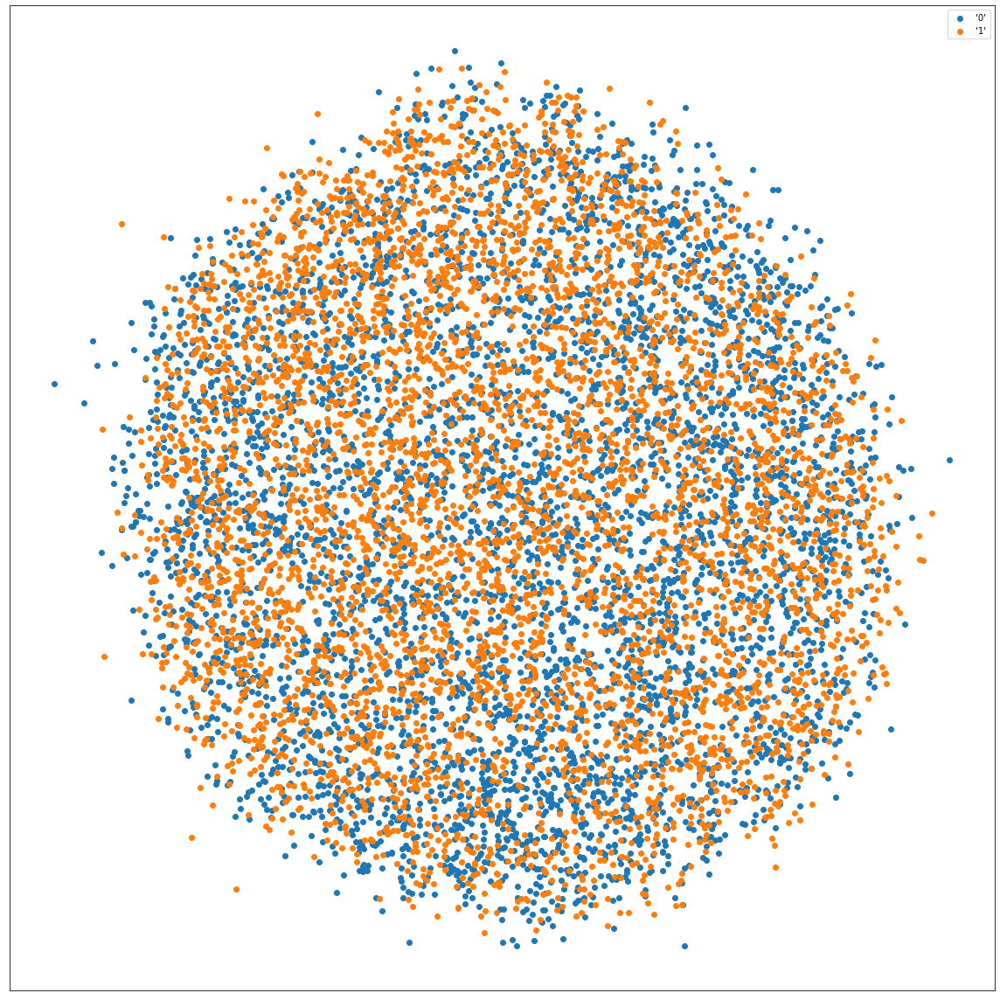

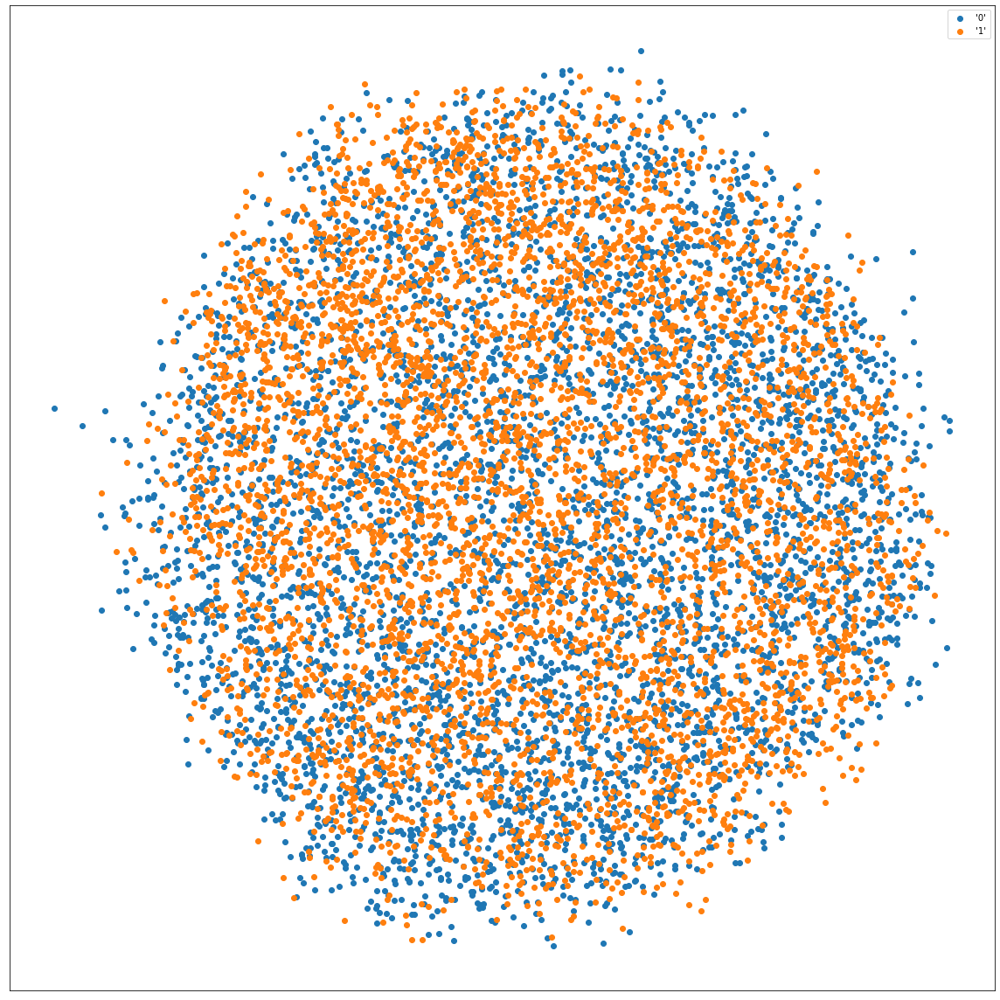

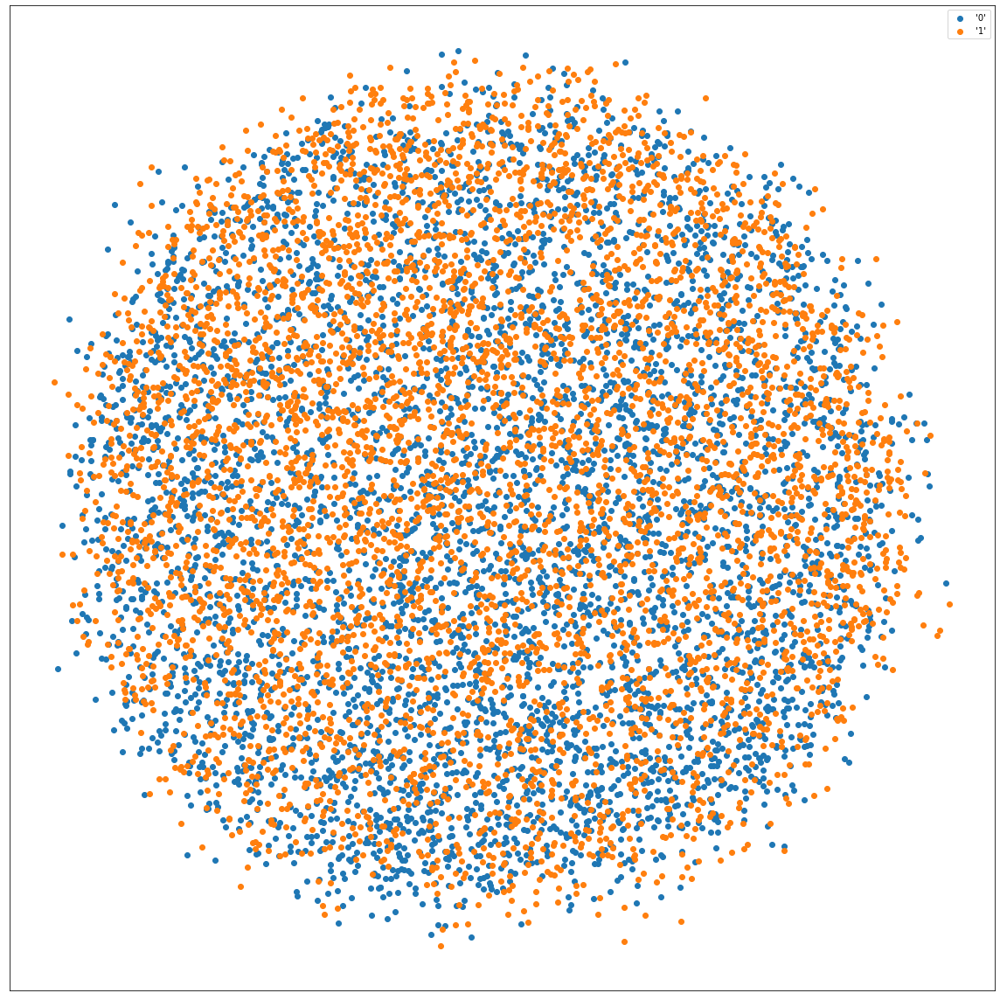

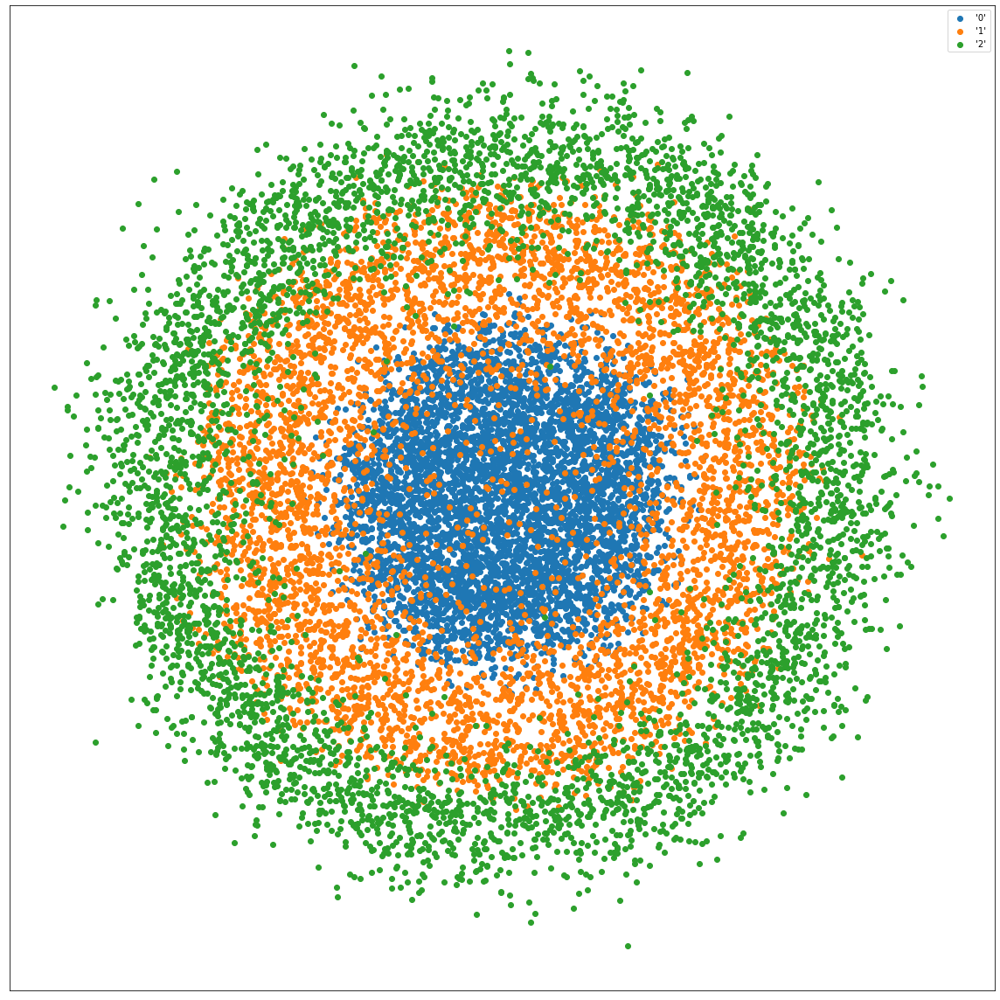

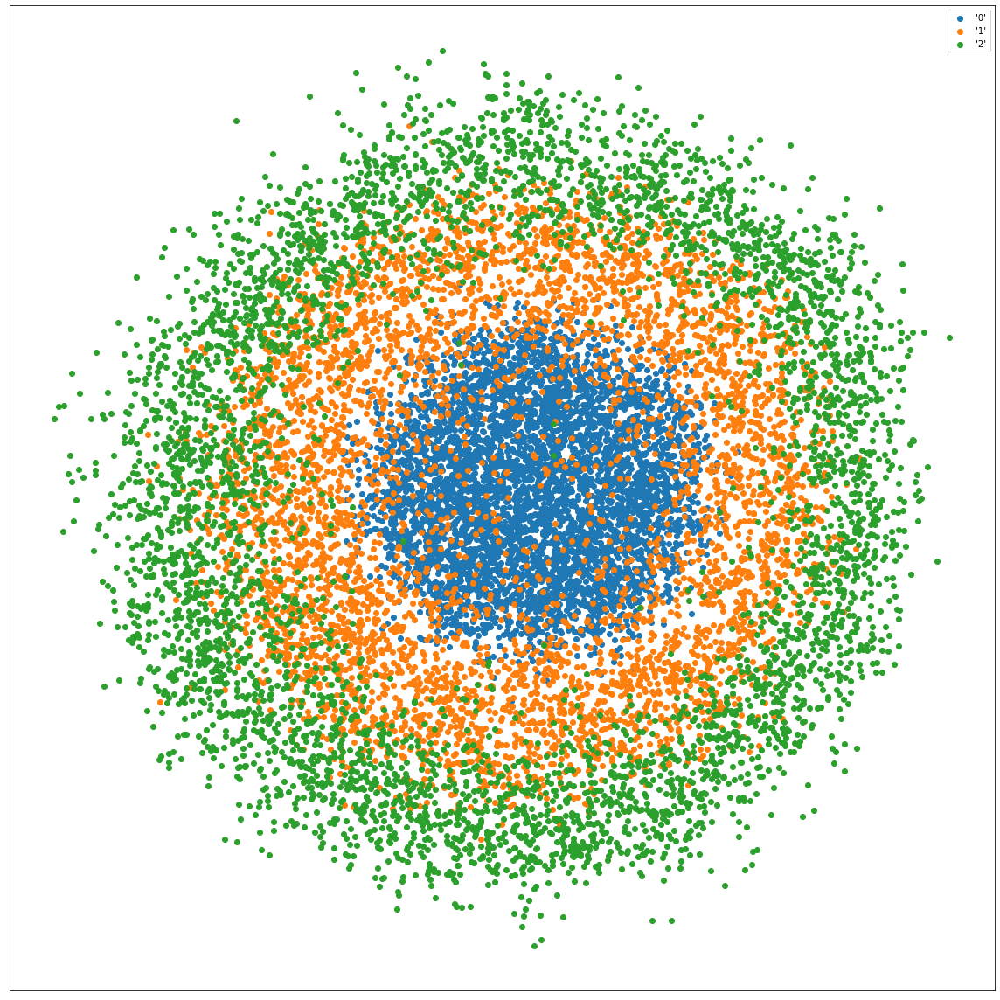

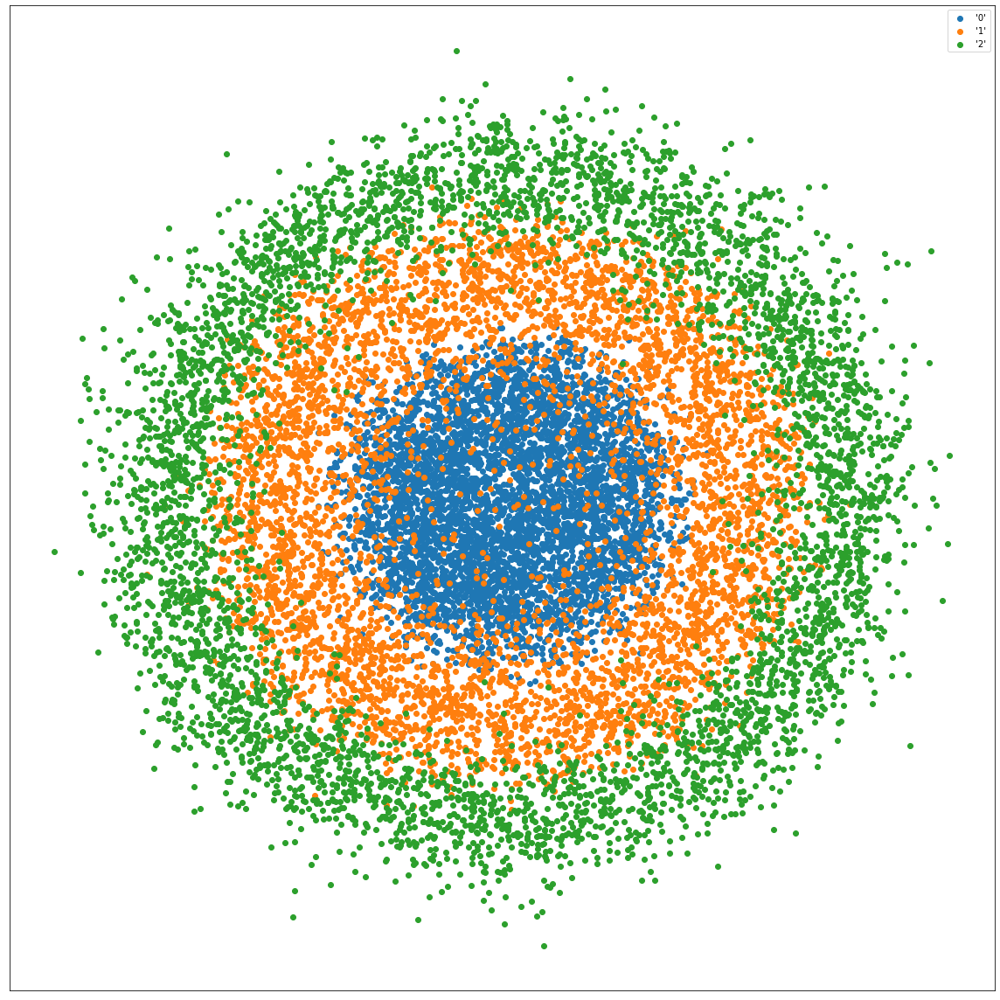

In [100]:
plot_2d_scatter(ball_2c_x_pacmap, classes_2class_ball, 2)
plot_2d_scatter(ball_2c_x_nn10_pacmap, classes_2class_ball, 2)
plot_2d_scatter(ball_2c_x_nn20_pacmap, classes_2class_ball, 2)

plot_2d_scatter(ball_2spheres_x_pacmap, classes_ball_2spheres, 3)
plot_2d_scatter(ball_2spheres_x_nn10_pacmap, classes_ball_2spheres, 3)
plot_2d_scatter(ball_2spheres_x_nn20_pacmap, classes_ball_2spheres, 3)

### IVHD

In [102]:
df_2class_ball_labels = pd.DataFrame(data=classes_2class_ball)

filepath = Path('../data/10k_ball_labels.csv')
filepath.parent.mkdir(parents=True, exist_ok=True)  
df_2class_ball_labels.to_csv(filepath, header=False, index=False)

df_ball_2spheres_labels = pd.DataFrame(data=classes_ball_2spheres)

filepath = Path('../data/ball_2spheres_15k_labels.csv')
filepath.parent.mkdir(parents=True, exist_ok=True)  
df_ball_2spheres_labels.to_csv(filepath, header=False, index=False)

In [108]:

ball_2c_ivhd_const_args = {
    'dir': "../viskit_offline",
    'labels_csv': "../data/10k_ball_labels.csv",
    'output': "../data/10k_balls.txt",
    'iter': 2500,
    'bd': 1, # binaryDistances
    'rns': 0, # reverseNeighborsSteps
    'rnc': 0, # reverseNeighborsCount
    'l1s': 0, # l1Steps
    'optimizer': "force-directed"
}

ball_2c_ivhd_args = [
    {'data_csv': "../data/10k_ball.csv", 'gp': "../data/10k_ball_nonscaled_euclidean.bin", 'nn': 3, 'rn': 1},
    {'data_csv': "../data/10k_ball.csv", 'gp': "../data/10k_ball_nonscaled_euclidean.bin", 'nn': 5, 'rn': 1},
    {'data_csv': "../data/10k_ball.csv", 'gp': "../data/10k_ball_nonscaled.bin", 'nn': 3, 'rn': 1},
    {'data_csv': "../data/10k_ball.csv", 'gp': "../data/10k_ball_nonscaled.bin", 'nn': 5, 'rn': 1},
    {'data_csv': "../data/10k_ball_scaled.csv", 'gp': "../data/10k_ball_scaled_euclidean.bin", 'nn': 3, 'rn': 1},
    {'data_csv': "../data/10k_ball_scaled.csv", 'gp': "../data/10k_ball_scaled_euclidean.bin", 'nn': 5, 'rn': 1},
    {'data_csv': "../data/10k_ball_scaled.csv", 'gp': "../data/10k_ball_scaled.bin", 'nn': 3, 'rn': 1},
    {'data_csv': "../data/10k_ball_scaled.csv", 'gp': "../data/10k_ball_scaled.bin", 'nn': 5, 'rn': 1},
    {'data_csv': "../data/10k_ball_scaled.csv", 'gp': "../data/10k_ball_scaled_euclidean.bin", 'nn': 7, 'rn': 2},
]
    

ball_2c_ivhd_names = ["IVHD nonscaled euclidean 3nn", 
    "IVHD nonscaled euclidean 5nn", 
    "IVHD nonscaled cosine 3nn", 
    "IVHD nonscaled cosine 5nn",
    "IVHD scaled euclidean 3nn", 
    "IVHD scaled euclidean 5nn", 
    "IVHD scaled cosine 3nn", 
    "IVHD scaled cosine 5nn",
    "IVHD scaled euclidean 7nn 2rn",
]


In [104]:
ball_2c_ivhd_results = []

for args in ball_2c_ivhd_args:
    csv_arg = args['data_csv']
    gp_arg = args['gp']
    nn_arg = args['nn']
    rn_arg = args['rn']

    command = '{dir} "{data_csv}" "{labels_csv}" "{gp}" {output} {iter} {nn} {rn} {bd} {rns} {rnc} {l1s} "{optimizer}"'.format(
        dir = ball_2c_ivhd_const_args['dir'],
        data_csv = csv_arg,
        labels_csv = ball_2c_ivhd_const_args['labels_csv'],
        gp = gp_arg,
        output = ball_2c_ivhd_const_args['output'],
        iter = ball_2c_ivhd_const_args['iter'],
        nn = nn_arg, 
        rn = rn_arg,
        bd = ball_2c_ivhd_const_args['bd'],
        rns = ball_2c_ivhd_const_args['rns'],
        rnc = ball_2c_ivhd_const_args['rnc'],
        l1s = ball_2c_ivhd_const_args['l1s'],
        optimizer = ball_2c_ivhd_const_args['optimizer'],
    )

    os.system(command)
    res = get_ivhd_result(ball_2c_ivhd_const_args['output'])
    ball_2c_ivhd_results.append(res)

[Info] [CSV Parser] Loading dataset from file: ./data/10k_ball.csv
[Info] [CSV Parser] Loading dataset from file: ./data/10k_ball_labels.csv
[Info] [CSV Parser] Labels file passed.
[Info] [CSV Parser] Dataset size: 10000
[Info] [CSV Parser] Dataset dimensionality: 30
[Info] [CSV Parser] Number of classes in dataset: 2
[Info] [CSV Parser] Finished.
[Info] [Graph] Loading graph from cache...
[Info] [Graph] Finished.
[Info] [kNN Generator] Determining random neighbors...
[Info] [kNN Generator] Finished.
[Info] [kNN Generator] Neighbors in graph: 40000
Step: 0
Step: 100
Step: 200
Step: 300
Step: 400
Step: 500
Step: 600
Step: 700
Step: 800
Step: 900
Step: 1000
Step: 1100
Step: 1200
Step: 1300
Step: 1400
Step: 1500
Step: 1600
Step: 1700
Step: 1800
Step: 1900
Step: 2000
Step: 2100
Step: 2200
Step: 2300
Step: 2400
[Info] [CSV Parser] Loading dataset from file: ./data/10k_ball.csv
[Info] [CSV Parser] Loading dataset from file: ./data/10k_ball_labels.csv
[Info] [CSV Parser] Labels file passed.
[

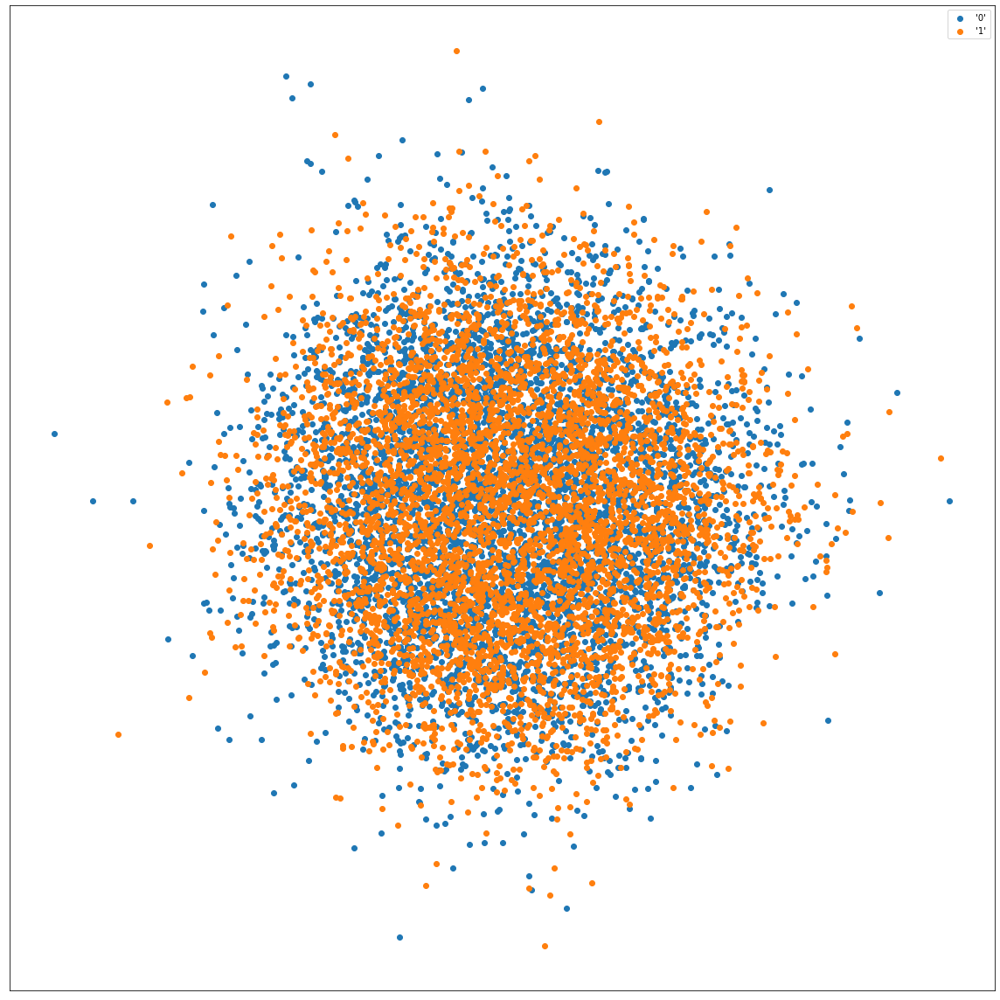

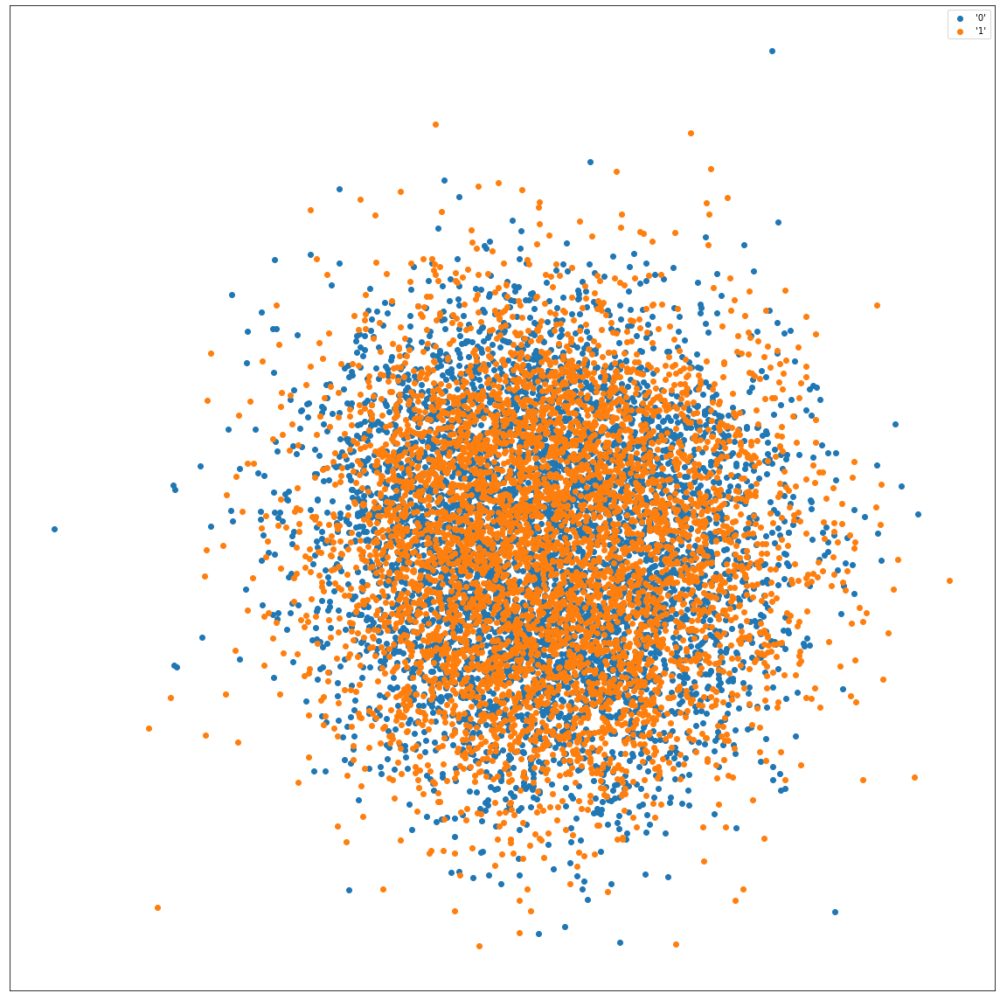

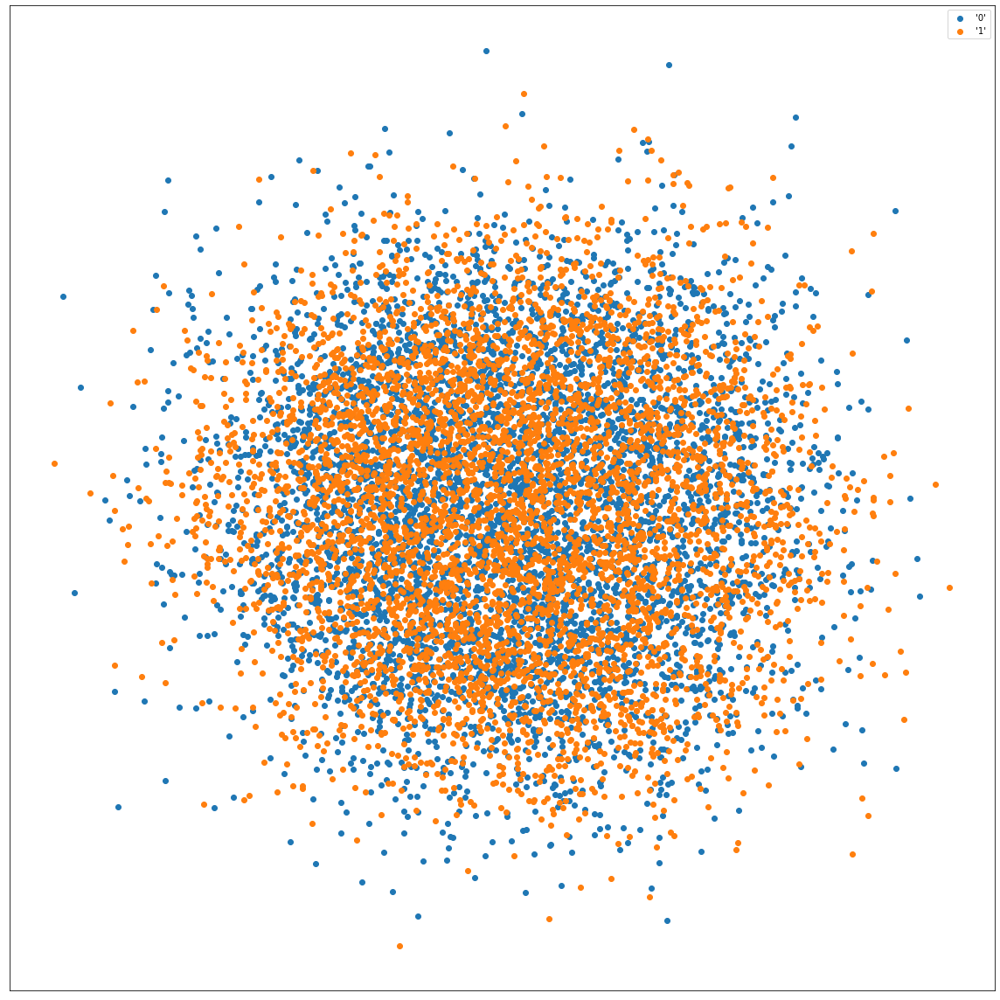

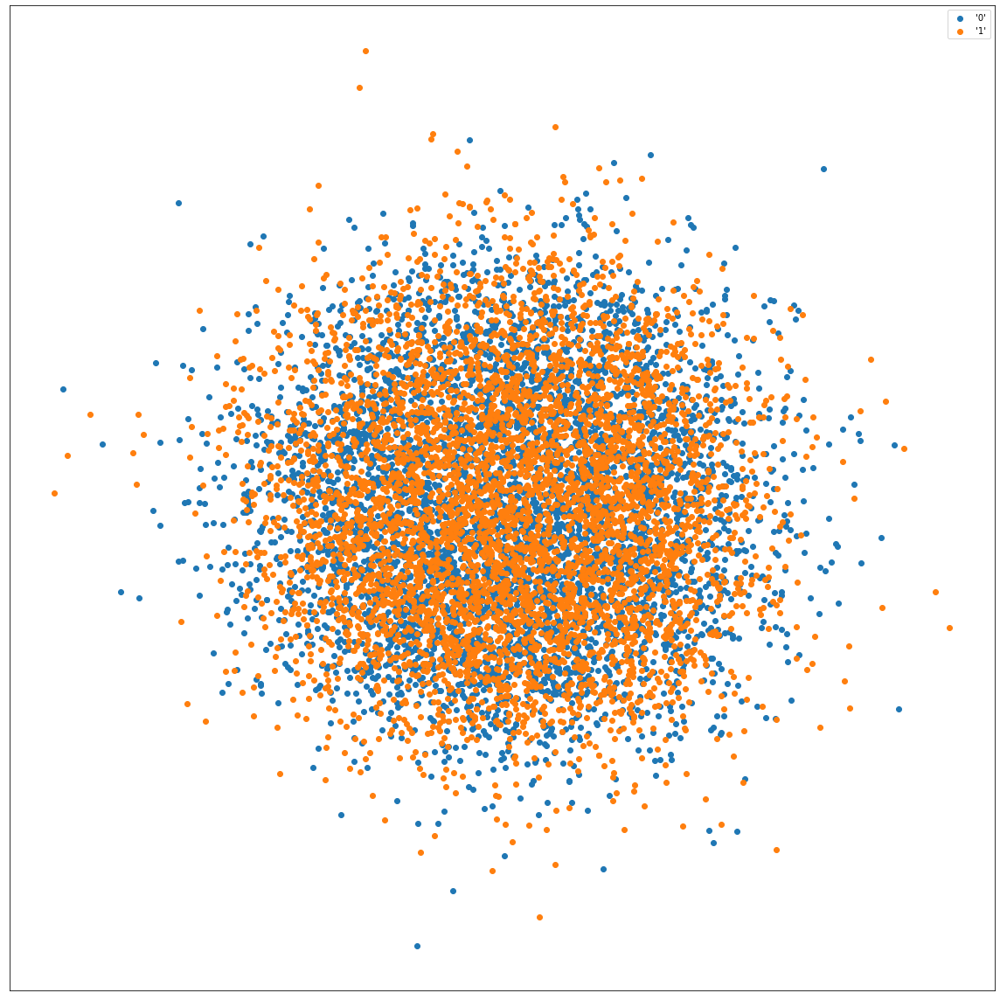

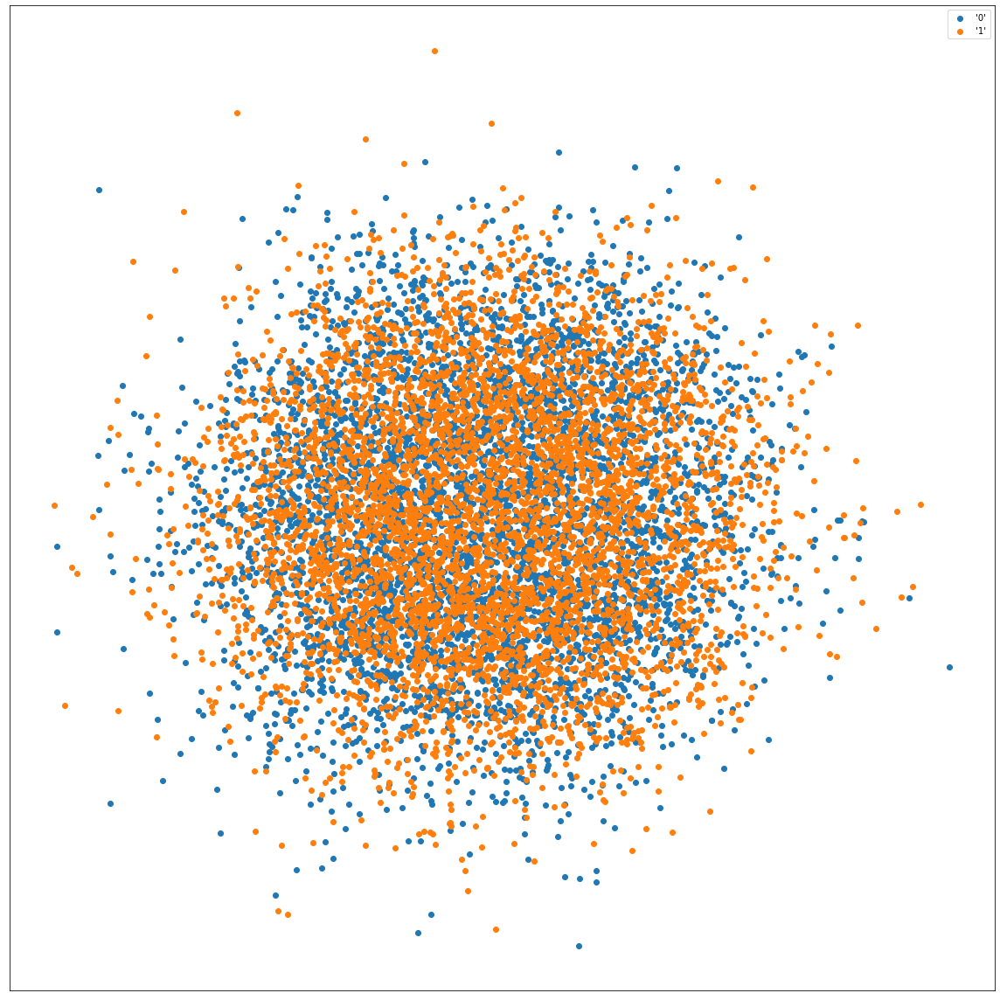

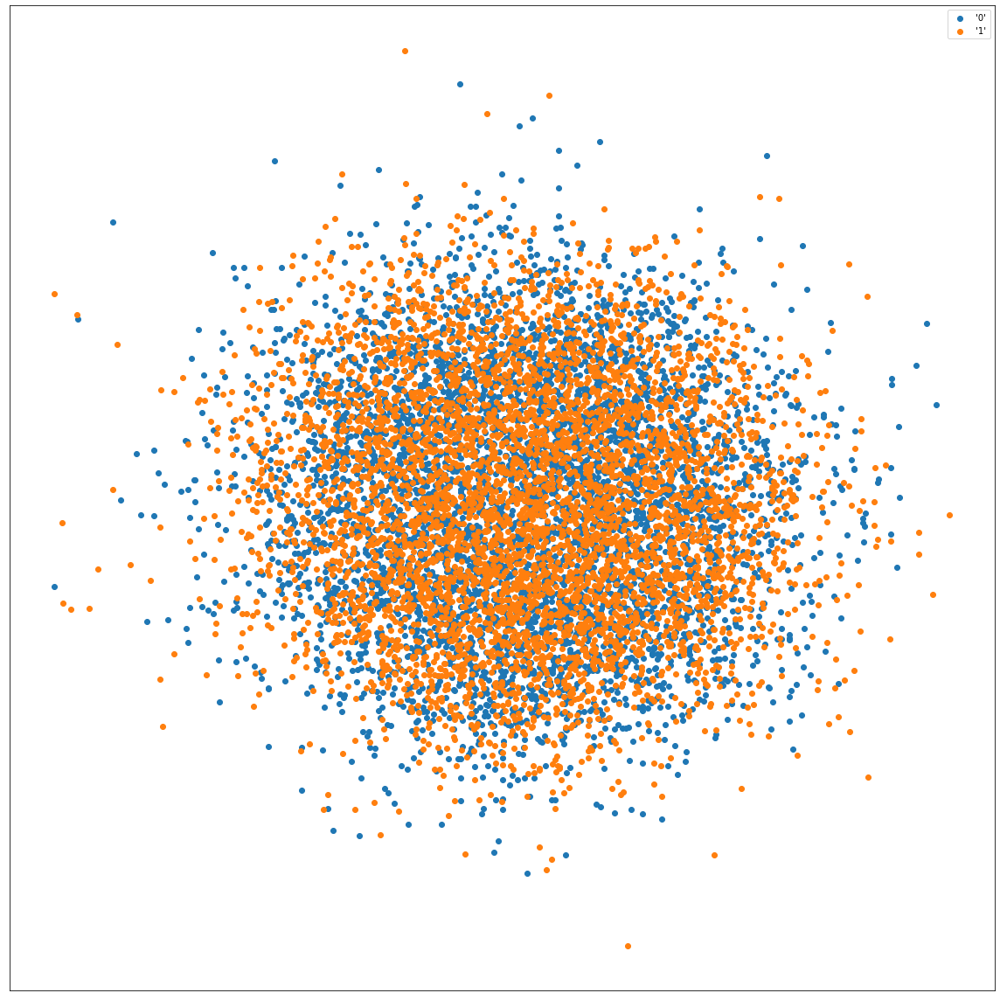

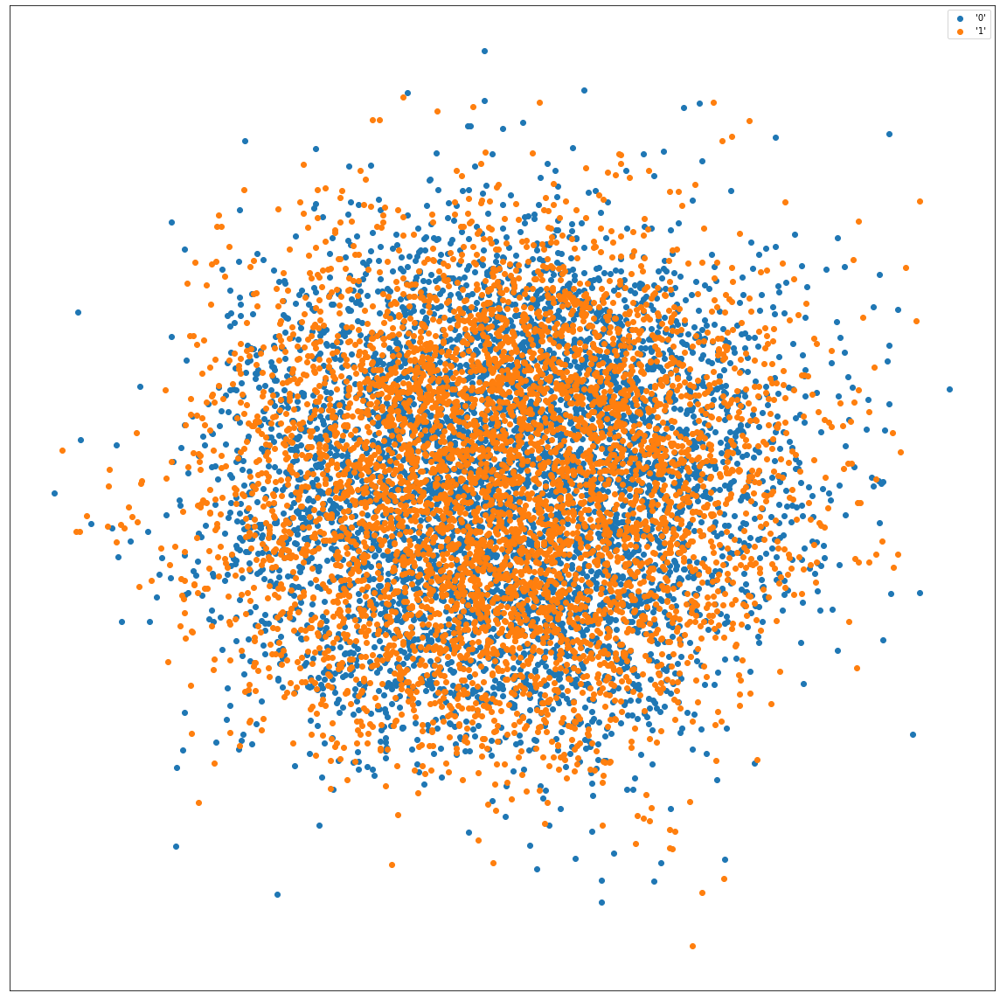

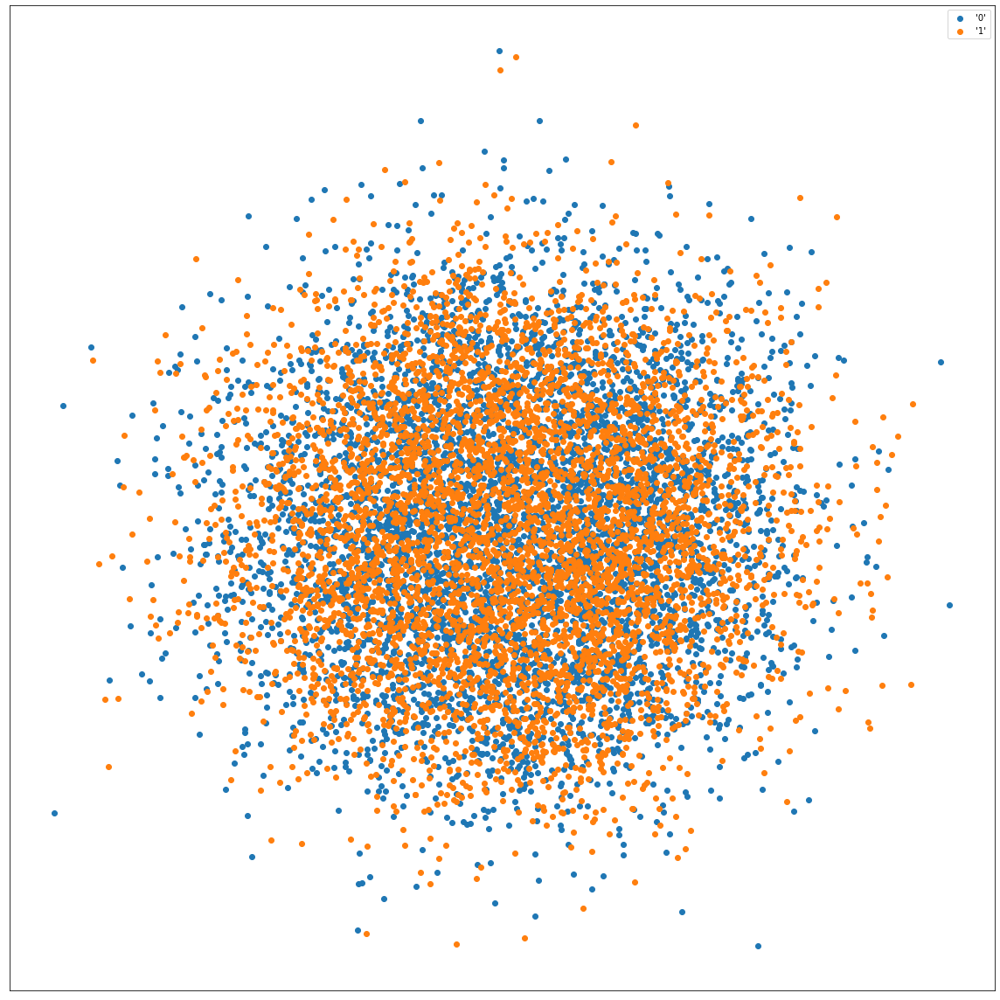

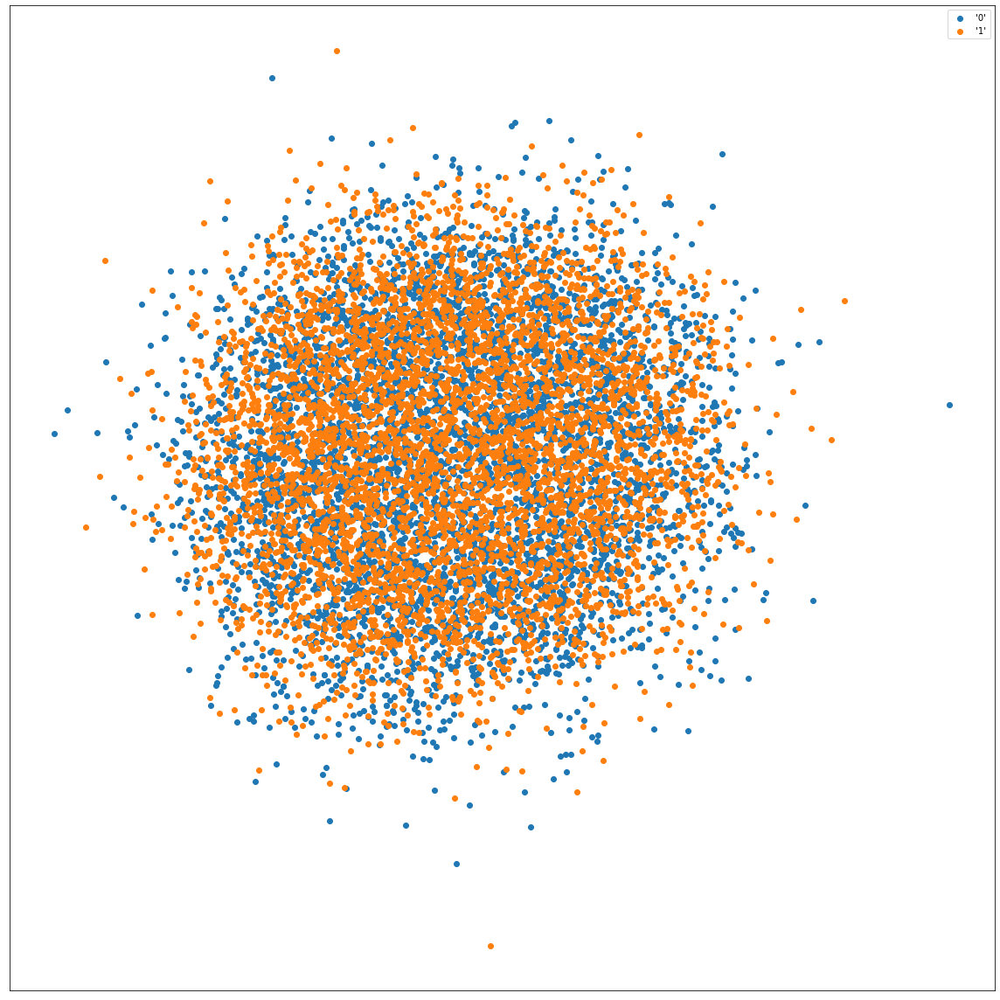

In [105]:
for x in ball_2c_ivhd_results:
    plot_2d_scatter(x, classes_2class_ball, 2)

In [109]:

ball_2spheres_ivhd_const_args = {
    'dir': "../viskit_offline",
    'labels_csv': "../data/ball_2spheres_15k_labels.csv",
    'output': "../data/ball_2spheres_15k.txt",
    'iter': 2500,
    'bd': 1, # binaryDistances
    'rns': 0, # reverseNeighborsSteps
    'rnc': 0, # reverseNeighborsCount
    'l1s': 0, # l1Steps
    'optimizer': "force-directed"
}

ball_2spheres_ivhd_args = [
    {'data_csv': "../data/ball_2spheres_15k.csv", 'gp': "../data/ball_2spheres_15k_nonscaled_euclidean.bin", 'nn': 3, 'rn': 1},
    {'data_csv': "../data/ball_2spheres_15k.csv", 'gp': "../data/ball_2spheres_15k_nonscaled_euclidean.bin", 'nn': 5, 'rn': 1},
    {'data_csv': "../data/ball_2spheres_15k.csv", 'gp': "../data/ball_2spheres_15k_nonscaled.bin", 'nn': 3, 'rn': 1},
    {'data_csv': "../data/ball_2spheres_15k.csv", 'gp': "../data/ball_2spheres_15k_nonscaled.bin", 'nn': 5, 'rn': 1},
    {'data_csv': "../data/ball_2spheres_15k_scaled.csv", 'gp': "../data/ball_2spheres_15k_scaled_euclidean.bin", 'nn': 3, 'rn': 1},
    {'data_csv': "../data/ball_2spheres_15k_scaled.csv", 'gp': "../data/ball_2spheres_15k_scaled_euclidean.bin", 'nn': 5, 'rn': 1},
    {'data_csv': "../data/ball_2spheres_15k_scaled.csv", 'gp': "../data/ball_2spheres_15k_scaled.bin", 'nn': 3, 'rn': 1},
    {'data_csv': "../data/ball_2spheres_15k_scaled.csv", 'gp': "../data/ball_2spheres_15k_scaled.bin", 'nn': 5, 'rn': 1},
    {'data_csv': "../data/ball_2spheres_15k_scaled.csv", 'gp': "../data/ball_2spheres_15k_scaled_euclidean.bin", 'nn': 7, 'rn': 2},
]

ball_2spheres_ivhd_names = ["IVHD nonscaled euclidean 3nn", 
    "IVHD nonscaled euclidean 5nn", 
    "IVHD nonscaled cosine 3nn", 
    "IVHD nonscaled cosine 5nn",
    "IVHD scaled euclidean 3nn", 
    "IVHD scaled euclidean 5nn", 
    "IVHD scaled cosine 3nn", 
    "IVHD scaled cosine 5nn",
    "IVHD scaled euclidean 7nn 2rn",
]


In [107]:
ball_2spheres_ivhd_results = []

for args in ball_2spheres_ivhd_args:
    csv_arg = args['data_csv']
    gp_arg = args['gp']
    nn_arg = args['nn']
    rn_arg = args['rn']

    command = '{dir} "{data_csv}" "{labels_csv}" "{gp}" {output} {iter} {nn} {rn} {bd} {rns} {rnc} {l1s} "{optimizer}"'.format(
        dir = ball_2spheres_ivhd_const_args['dir'],
        data_csv = csv_arg,
        labels_csv = ball_2spheres_ivhd_const_args['labels_csv'],
        gp = gp_arg,
        output = ball_2spheres_ivhd_const_args['output'],
        iter = ball_2spheres_ivhd_const_args['iter'],
        nn = nn_arg, 
        rn = rn_arg,
        bd = ball_2spheres_ivhd_const_args['bd'],
        rns = ball_2spheres_ivhd_const_args['rns'],
        rnc = ball_2spheres_ivhd_const_args['rnc'],
        l1s = ball_2spheres_ivhd_const_args['l1s'],
        optimizer = ball_2spheres_ivhd_const_args['optimizer'],
    )

    os.system(command)
    res = get_ivhd_result(ball_2spheres_ivhd_const_args['output'])
    ball_2spheres_ivhd_results.append(res)

[Info] [CSV Parser] Loading dataset from file: ./data/ball_2spheres_15k.csv
[Info] [CSV Parser] Loading dataset from file: ./data/ball_2spheres_15k_labels.csv
[Info] [CSV Parser] Labels file passed.
[Info] [CSV Parser] Dataset size: 15000
[Info] [CSV Parser] Dataset dimensionality: 30
[Info] [CSV Parser] Number of classes in dataset: 3
[Info] [CSV Parser] Finished.
[Info] [Graph] Loading graph from cache...
[Info] [Graph] Finished.
[Info] [kNN Generator] Determining random neighbors...
[Info] [kNN Generator] Finished.
[Info] [kNN Generator] Neighbors in graph: 60000
Step: 0
Step: 100
Step: 200
Step: 300
Step: 400
Step: 500
Step: 600
Step: 700
Step: 800
Step: 900
Step: 1000
Step: 1100
Step: 1200
Step: 1300
Step: 1400
Step: 1500
Step: 1600
Step: 1700
Step: 1800
Step: 1900
Step: 2000
Step: 2100
Step: 2200
Step: 2300
Step: 2400
[Info] [CSV Parser] Loading dataset from file: ./data/ball_2spheres_15k.csv
[Info] [CSV Parser] Loading dataset from file: ./data/ball_2spheres_15k_labels.csv
[Info

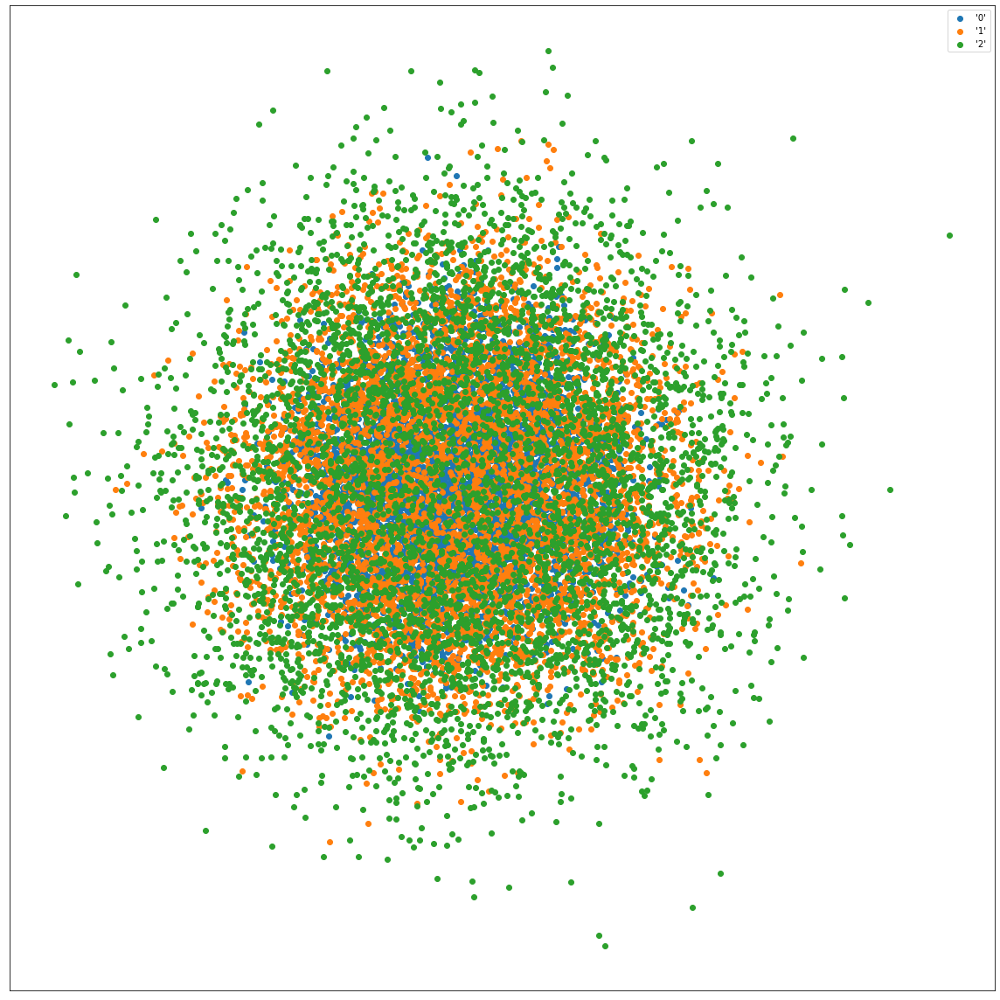

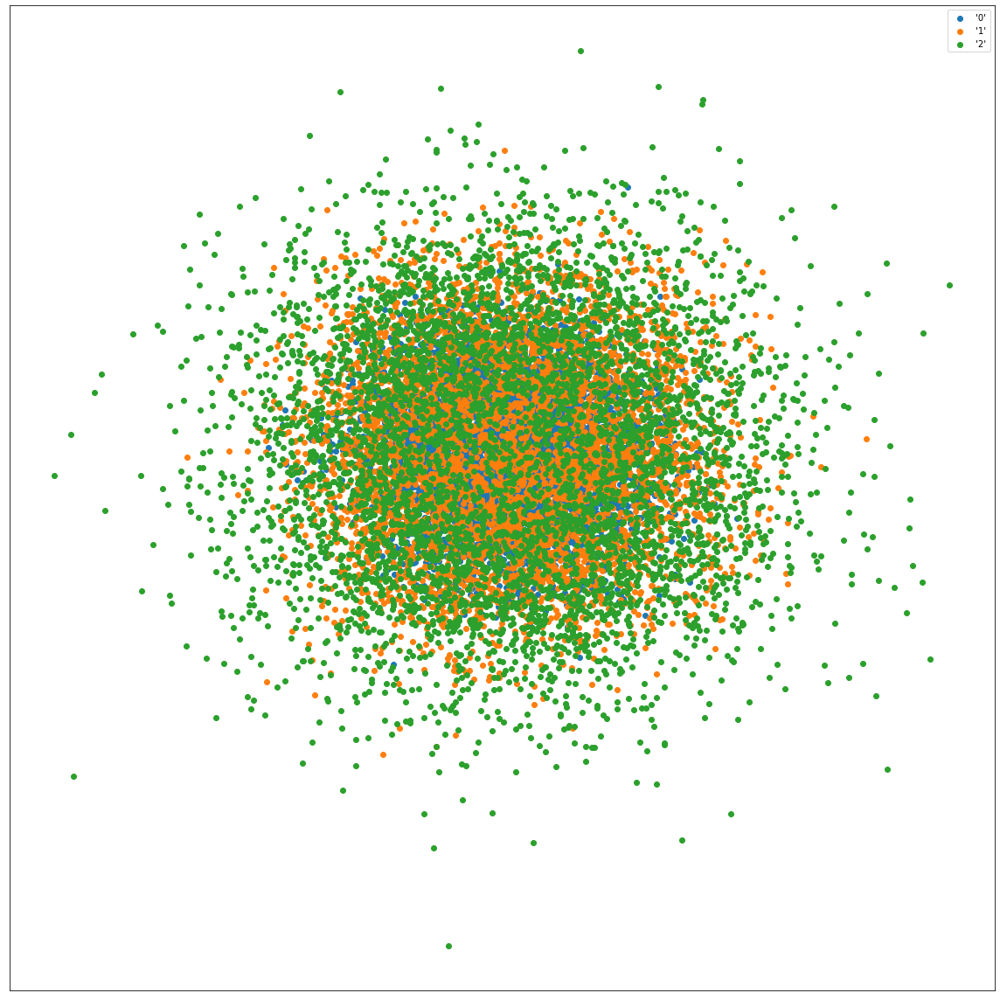

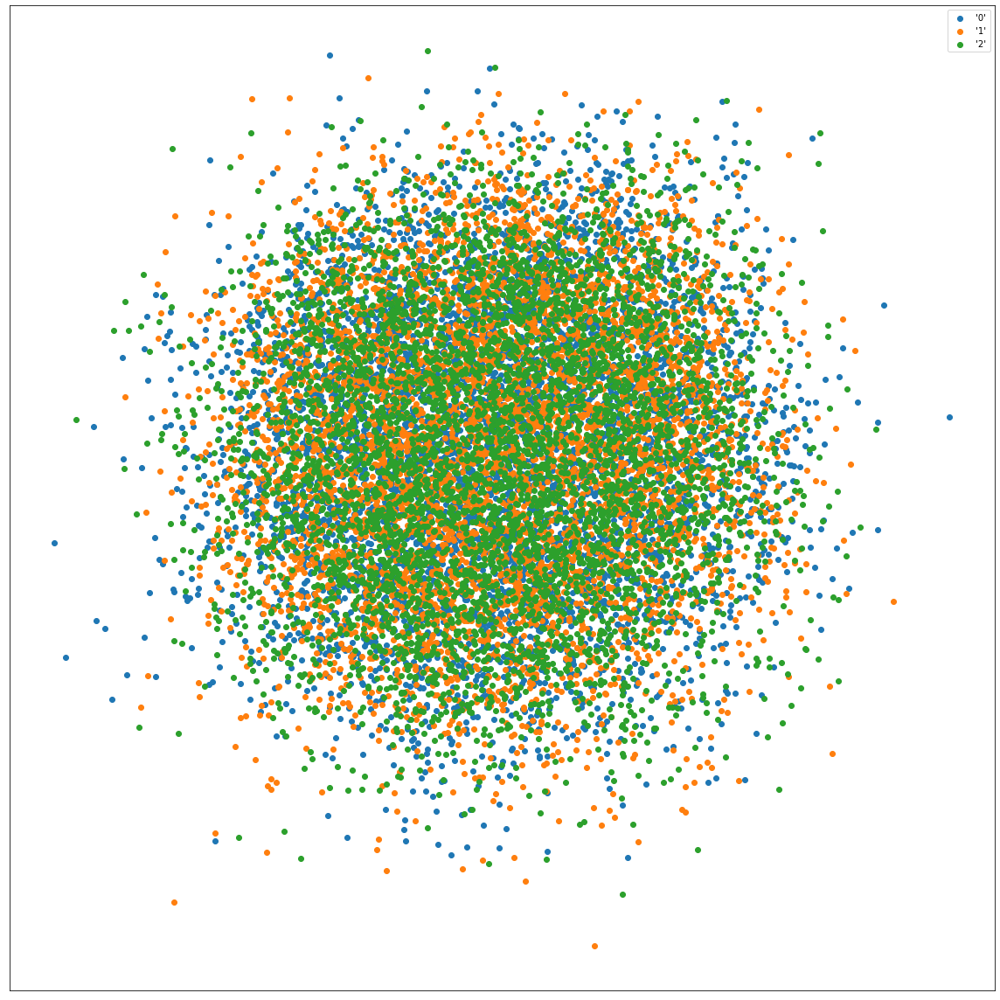

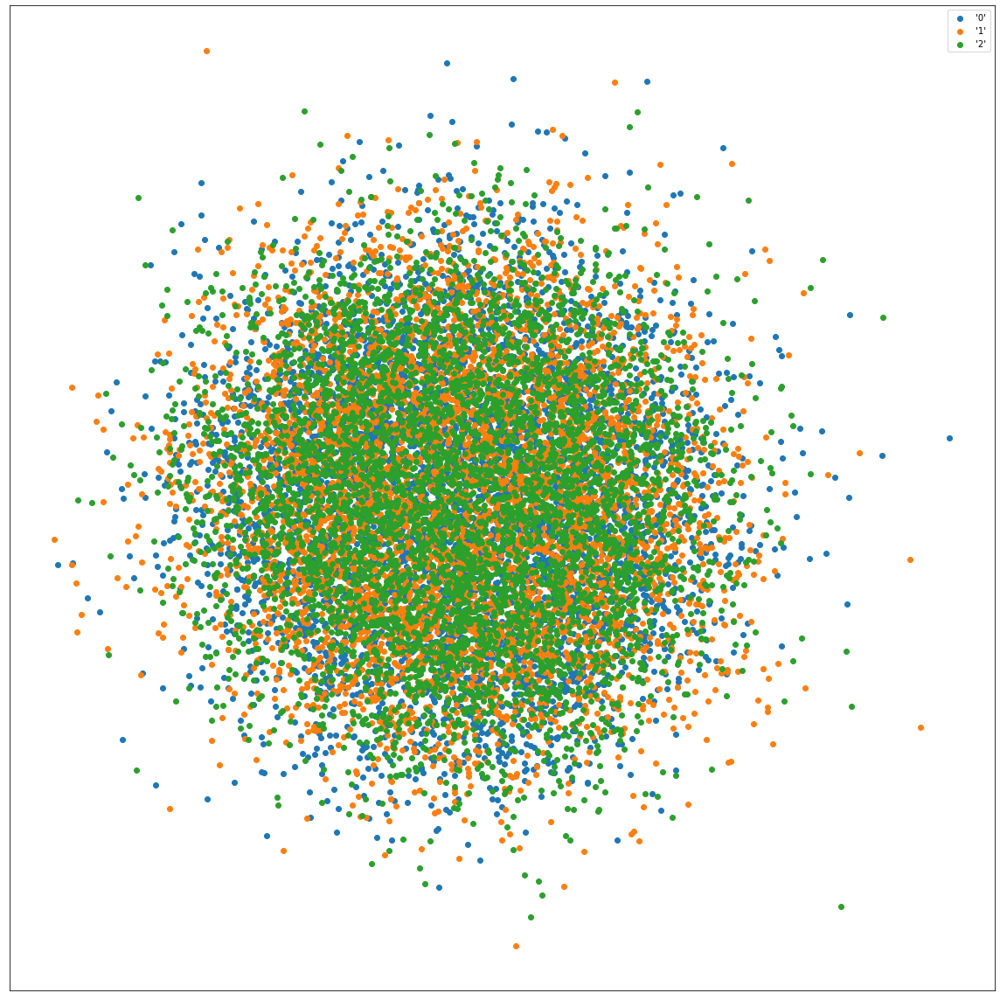

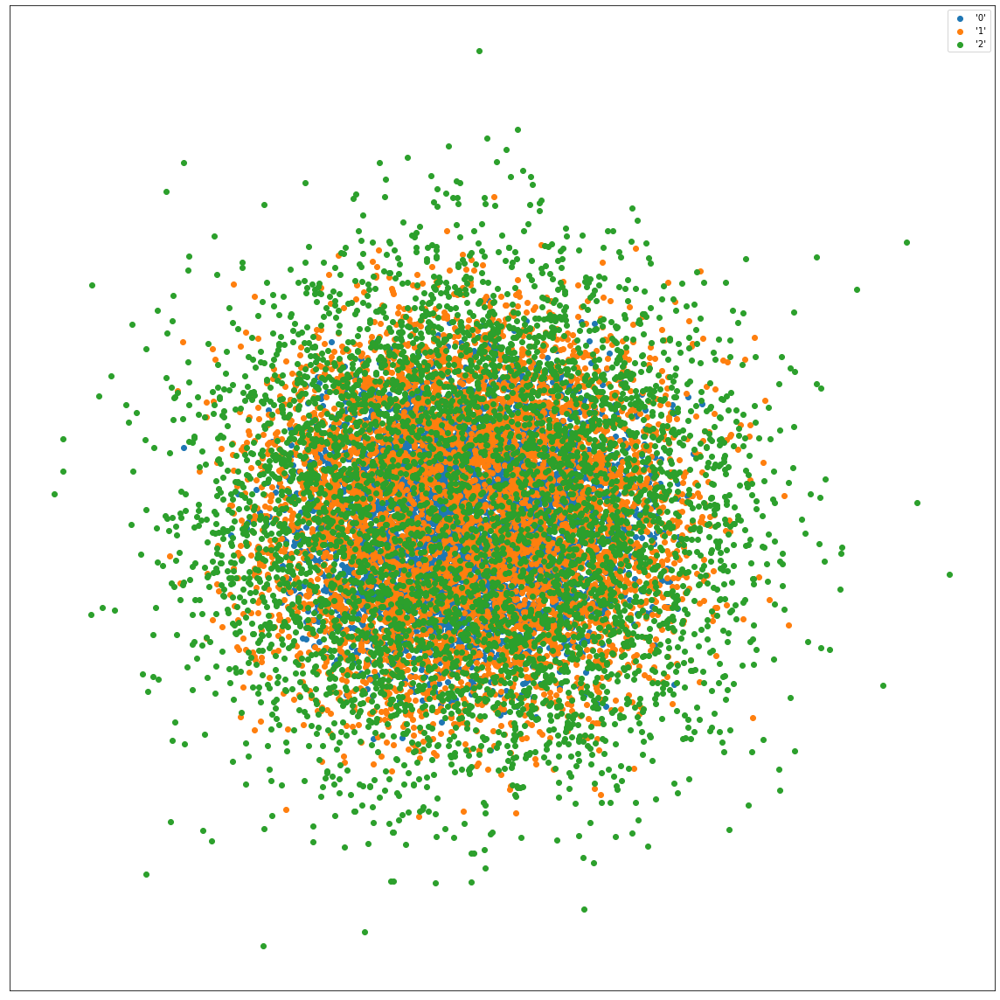

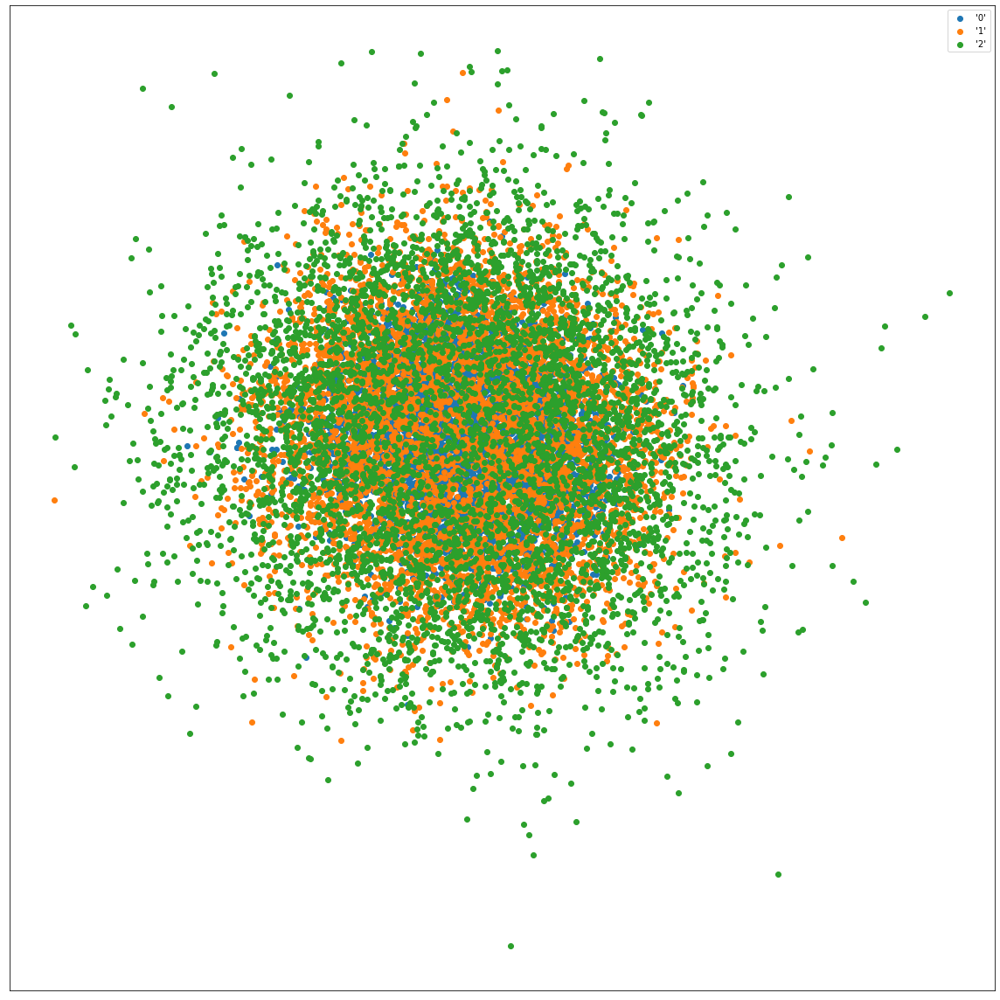

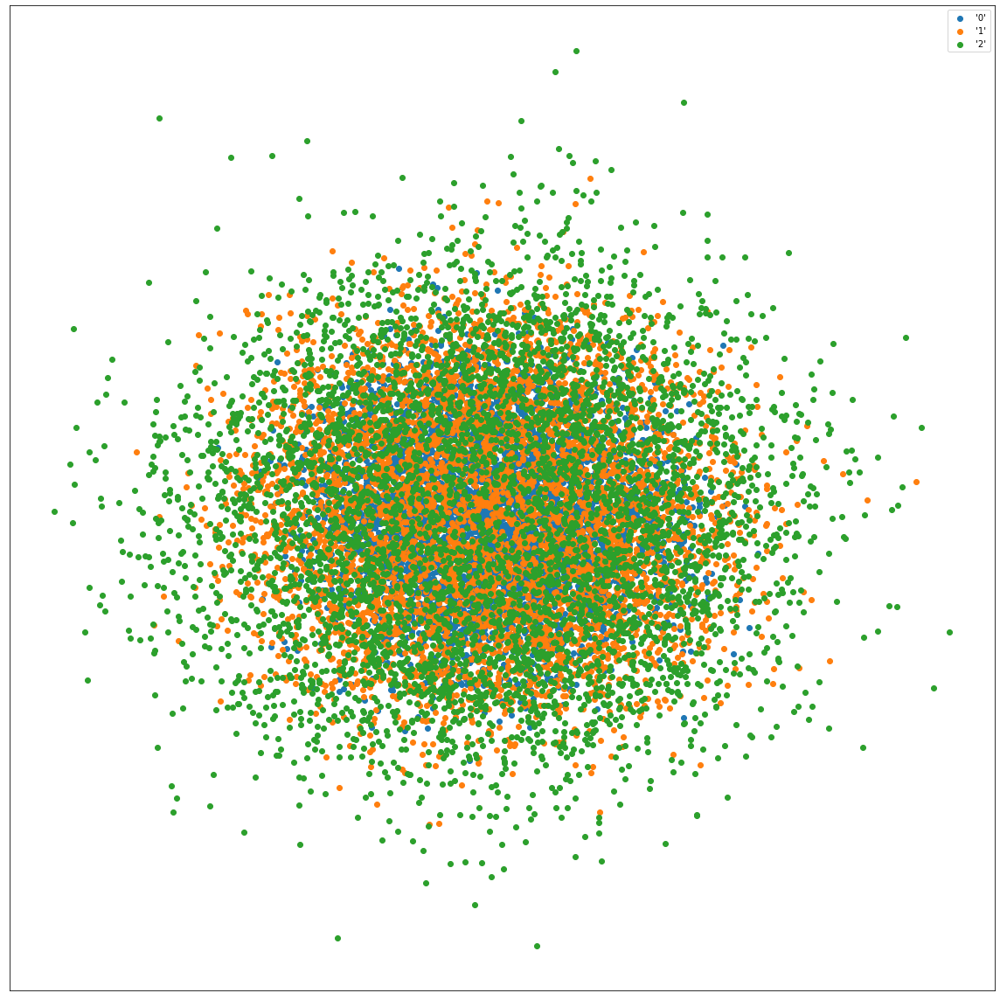

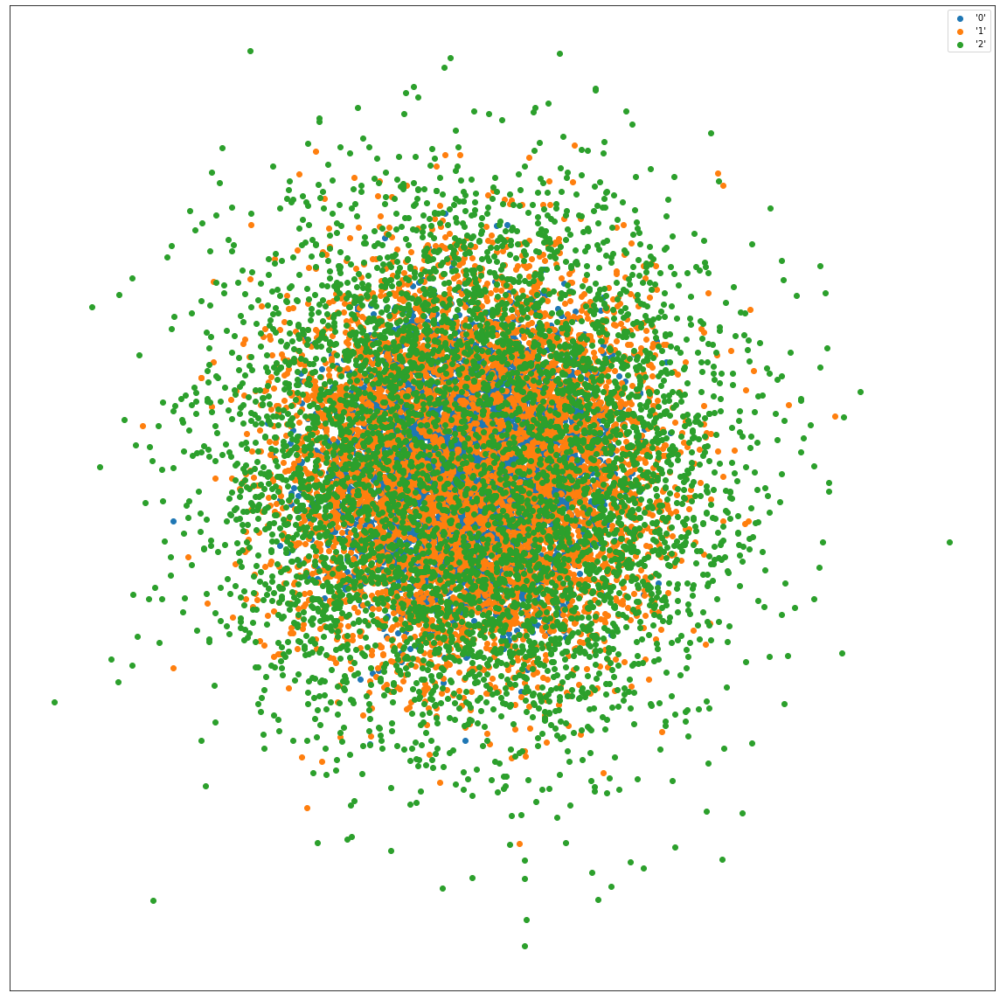

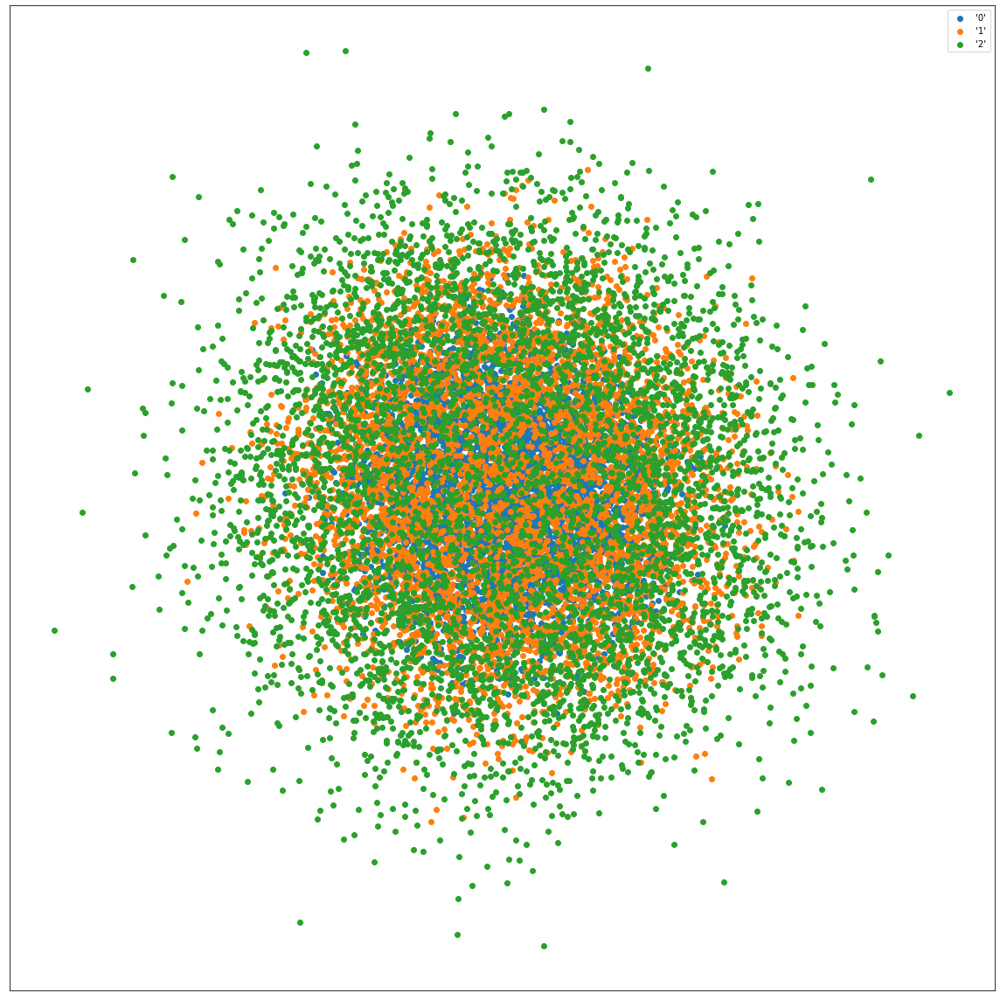

In [110]:
for x in ball_2spheres_ivhd_results:
    plot_2d_scatter(x, classes_ball_2spheres, 3)

### Results comparison for 10k 2class ball 30d dataset

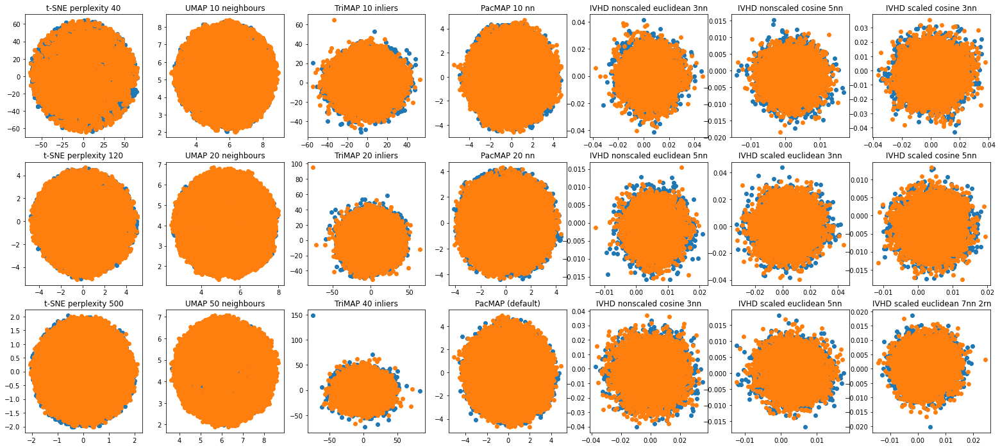

In [115]:
# 3 subplots for t-SNE
# 3 subplots for UMAP
# 3 subplots for TriMAP
# 3 subplots for PacMAP
# 9 subplots for IVHD

figure, axis = plt.subplots(3, 7)
figure.set_size_inches(27,12)
ball_2c_methods_names = [
    ["t-SNE perplexity 40", "t-SNE perplexity 120", "t-SNE perplexity 500"],
    ["UMAP 10 neighbours", "UMAP 20 neighbours", "UMAP 50 neighbours"], 
    ["TriMAP 10 inliers", "TriMAP 20 inliers", "TriMAP 40 inliers"], 
    ["PacMAP 10 nn", "PacMAP 20 nn", "PacMAP (default)"],
    [ball_2c_ivhd_names[0], ball_2c_ivhd_names[1], ball_2c_ivhd_names[2]],
    [ball_2c_ivhd_names[3], ball_2c_ivhd_names[4], ball_2c_ivhd_names[5]], 
    [ball_2c_ivhd_names[6], ball_2c_ivhd_names[7], ball_2c_ivhd_names[8]],
]
todo_res = np.array([])
ball_2c_methods_results = [
    [ball_2c_x_40_tsne, ball_2c_x_120_tsne, ball_2c_x_500_tsne],
    [ball_2c_x_10_umap, ball_2c_x_20_umap, ball_2c_x_50_umap],
    [ball_2c_x_10_trimap, ball_2c_x_20_trimap, ball_2c_x_40_trimap],
    [ball_2c_x_nn10_pacmap, ball_2c_x_nn20_pacmap, ball_2c_x_pacmap],
    [ball_2c_ivhd_results[0], ball_2c_ivhd_results[1], ball_2c_ivhd_results[2]],
    [ball_2c_ivhd_results[3], ball_2c_ivhd_results[4], ball_2c_ivhd_results[5]],
    [ball_2c_ivhd_results[6], ball_2c_ivhd_results[7], ball_2c_ivhd_results[8]],
]

for j in range(7):
    for i in range(3):
        axis[i, j].set_title(ball_2c_methods_names[j][i])

        X = ball_2c_methods_results[j][i]
        if not X.any(): # temporary for non-existant plot data
            break
        
        for k in range(2):
            digit_indices = (classes_2class_ball == 1-k)
            dim1 = X[digit_indices, 0]
            dim2 = X[digit_indices, 1]
            axis[i, j].scatter(dim1, dim2, label=f"'{i}'")
            

plt.show()

### Results comparison for 15k ball inside sphere inside sphere 30d dataset

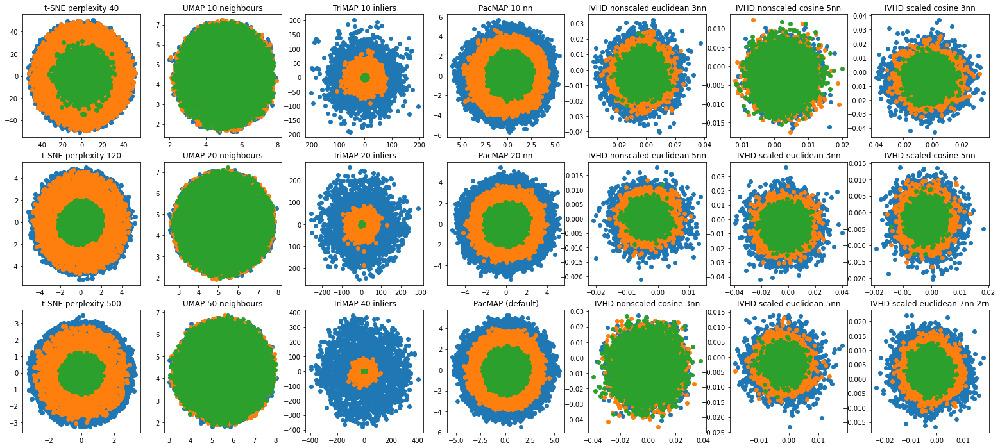

In [114]:
# 3 subplots for t-SNE
# 3 subplots for UMAP
# 3 subplots for TriMAP
# 3 subplots for PacMAP
# 9 subplots for IVHD
figure, axis = plt.subplots(3, 7)
figure.set_size_inches(27,12)
ball_2spheres_methods_names = [
    ["t-SNE perplexity 40", "t-SNE perplexity 120", "t-SNE perplexity 500"],
    ["UMAP 10 neighbours", "UMAP 20 neighbours", "UMAP 50 neighbours"], 
    ["TriMAP 10 inliers", "TriMAP 20 inliers", "TriMAP 40 inliers"], 
    ["PacMAP 10 nn", "PacMAP 20 nn", "PacMAP (default)"],
    [ball_2spheres_ivhd_names[0], ball_2spheres_ivhd_names[1], ball_2spheres_ivhd_names[2]],
    [ball_2spheres_ivhd_names[3], ball_2spheres_ivhd_names[4], ball_2spheres_ivhd_names[5]], 
    [ball_2spheres_ivhd_names[6], ball_2spheres_ivhd_names[7], ball_2spheres_ivhd_names[8]],
]
todo_res = np.array([])
ball_2spheres_methods_results = [
    [ball_2spheres_x_40_tsne, ball_2spheres_x_120_tsne, ball_2spheres_x_500_tsne],
    [ball_2spheres_x_10_umap, ball_2spheres_x_20_umap, ball_2spheres_x_50_umap],
    [ball_2spheres_x_10_trimap, ball_2spheres_x_20_trimap, ball_2spheres_x_40_trimap],
    [ball_2spheres_x_nn10_pacmap, ball_2spheres_x_nn20_pacmap, ball_2spheres_x_pacmap],
    [ball_2spheres_ivhd_results[0], ball_2spheres_ivhd_results[1], ball_2spheres_ivhd_results[2]],
    [ball_2spheres_ivhd_results[3], ball_2spheres_ivhd_results[4], ball_2spheres_ivhd_results[5]],
    [ball_2spheres_ivhd_results[6], ball_2spheres_ivhd_results[7], ball_2spheres_ivhd_results[8]],
]

for j in range(7):
    for i in range(3):
        axis[i, j].set_title(ball_2spheres_methods_names[j][i])

        X = ball_2spheres_methods_results[j][i]
        if not X.any(): # temporary for non-existant plot data
            break
        
        for k in range(3):
            digit_indices = (classes_ball_2spheres == 2-k)
            dim1 = X[digit_indices, 0]
            dim2 = X[digit_indices, 1]
            axis[i, j].scatter(dim1, dim2, label=f"'{i}'")
            

plt.show()

### Metrics comparison for 15k ball inside sphere inside sphere 30d dataset

In [119]:
ball_2spheres_labels = np.array([x for x in df_ball_2spheres_labels[0]])

In [120]:
ball_2spheres_tsne_umap_metric = LocalMetric()
ball_2spheres_trimap_pacmap_metric = LocalMetric()
ball_2spheres_ivhd_cosine_metric = LocalMetric()
ball_2spheres_ivhd_euclidean_metric = LocalMetric()

ball_2spheres_x_tsne_umap = [ball_2spheres_x_40_tsne, ball_2spheres_x_120_tsne, ball_2spheres_x_500_tsne, ball_2spheres_x_10_umap, ball_2spheres_x_20_umap, ball_2spheres_x_50_umap]
ball_2spheres_y_tsne_umap = ["t-SNE perplexity 40", "t-SNE perplexity 120", "t-SNE perplexity 500",
    "UMAP 10 neighbours", "UMAP 20 neighbours", "UMAP 50 neighbours"]

ball_2spheres_x_trimap_pacmap = [ball_2spheres_x_10_trimap, ball_2spheres_x_20_trimap, ball_2spheres_x_40_trimap, ball_2spheres_x_nn10_pacmap, ball_2spheres_x_nn20_pacmap, ball_2spheres_x_pacmap]
ball_2spheres_y_trimap_pacmap = ["TriMAP 10 inliers", "TriMAP 20 inliers", "TriMAP 40 inliers", 
    "PacMAP 10 nn", "PacMAP 20 nn", "PacMAP (default)"]

ball_2spheres_x_euclidean_ivhd = []
ball_2spheres_y_euclidean_ivhd = []

ball_2spheres_x_cosine_ivhd = []
ball_2spheres_y_cosine_ivhd = []

for i in range(len(ball_2spheres_ivhd_names)):
    if i // 2 % 2 == 0:
        ball_2spheres_x_euclidean_ivhd.append(ball_2spheres_ivhd_results[i])
        ball_2spheres_y_euclidean_ivhd.append(ball_2spheres_ivhd_names[i])
    else:
        ball_2spheres_x_cosine_ivhd.append(ball_2spheres_ivhd_results[i])
        ball_2spheres_y_cosine_ivhd.append(ball_2spheres_ivhd_names[i])


def metric_calculate(metric, x_m, y_m):
    for i in range(len(x_m)):
        metric.calculate_knn_gain_and_dr_quality(
            X_lds=x_m[i],
            X_hds=df_ball_2spheres_scaled,
            labels=ball_2spheres_labels,
            method_name=y_m[i],
        )

metric_calculate(ball_2spheres_tsne_umap_metric, ball_2spheres_x_tsne_umap, ball_2spheres_y_tsne_umap)
metric_calculate(ball_2spheres_trimap_pacmap_metric, ball_2spheres_x_trimap_pacmap, ball_2spheres_y_trimap_pacmap)
metric_calculate(ball_2spheres_ivhd_euclidean_metric, ball_2spheres_x_euclidean_ivhd, ball_2spheres_y_euclidean_ivhd)
metric_calculate(ball_2spheres_ivhd_cosine_metric, ball_2spheres_x_cosine_ivhd, ball_2spheres_y_cosine_ivhd)

Calculating d_hd
t-SNE perplexity 40
Calculating d_hd
t-SNE perplexity 120
Calculating d_hd
t-SNE perplexity 500
Calculating d_hd
UMAP 10 neighbours
Calculating d_hd
UMAP 20 neighbours
Calculating d_hd
UMAP 50 neighbours
Calculating d_hd
TriMAP 10 inliers
Calculating d_hd
TriMAP 20 inliers
Calculating d_hd
TriMAP 40 inliers
Calculating d_hd
PacMAP 10 nn
Calculating d_hd
PacMAP 20 nn
Calculating d_hd
PacMAP (default)
Calculating d_hd
IVHD nonscaled euclidean 3nn
Calculating d_hd
IVHD nonscaled euclidean 5nn
Calculating d_hd
IVHD scaled euclidean 3nn
Calculating d_hd
IVHD scaled euclidean 5nn
Calculating d_hd
IVHD scaled euclidean 7nn 2rn
Calculating d_hd
IVHD nonscaled cosine 3nn
Calculating d_hd
IVHD nonscaled cosine 5nn
Calculating d_hd
IVHD scaled cosine 3nn
Calculating d_hd
IVHD scaled cosine 5nn


Finished.


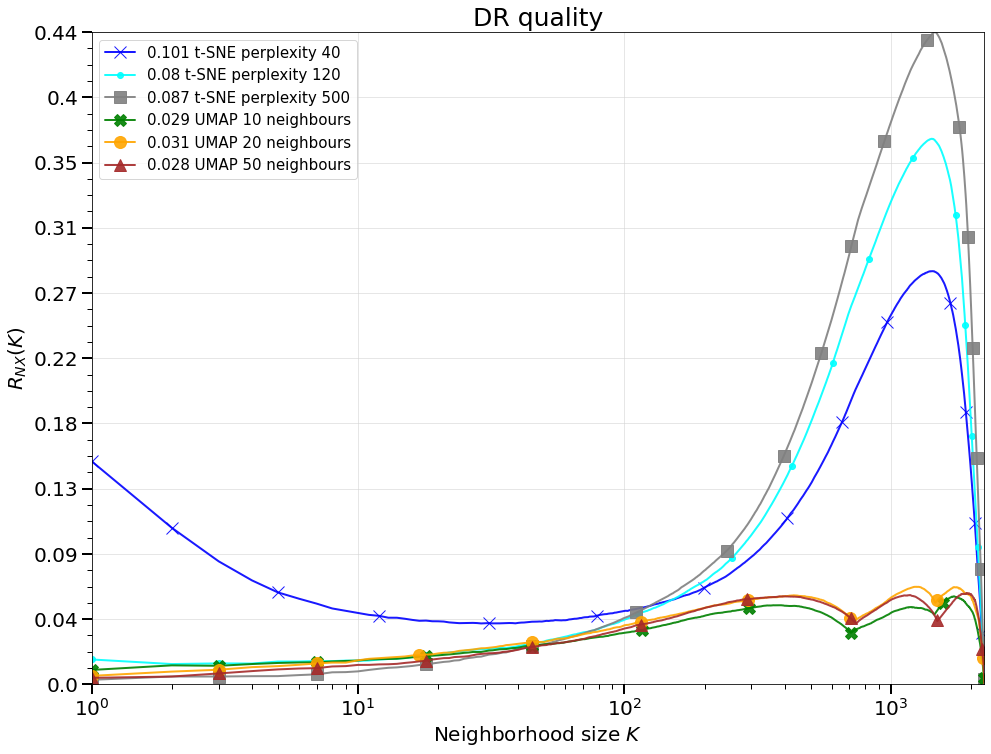

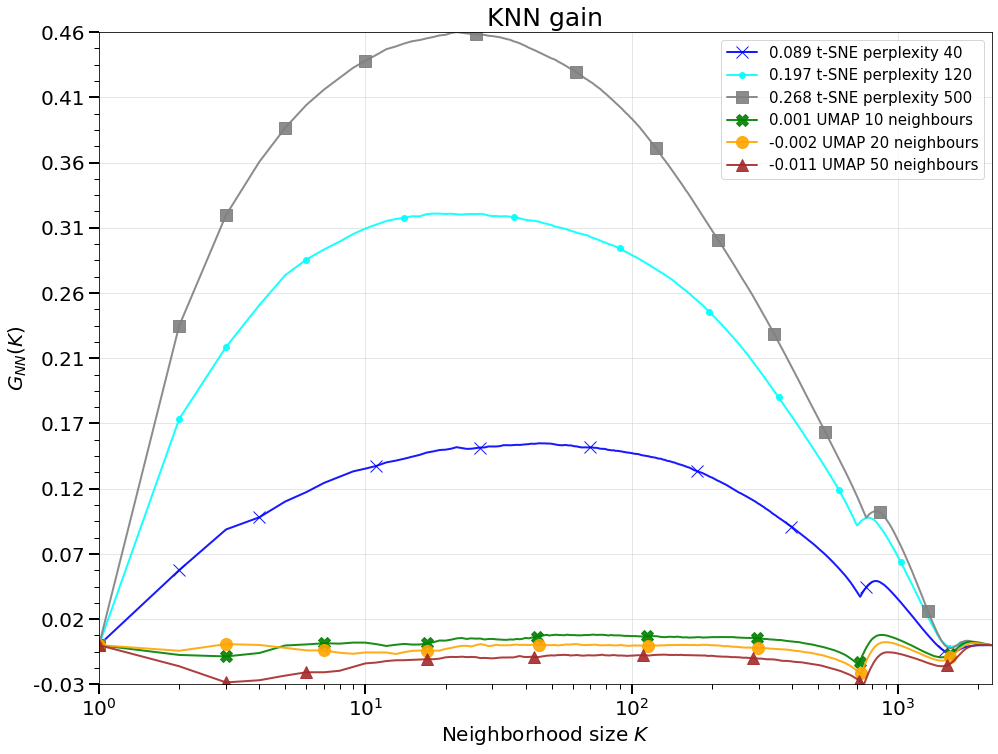

In [121]:
ball_2spheres_tsne_umap_metric.visualize()

Finished.


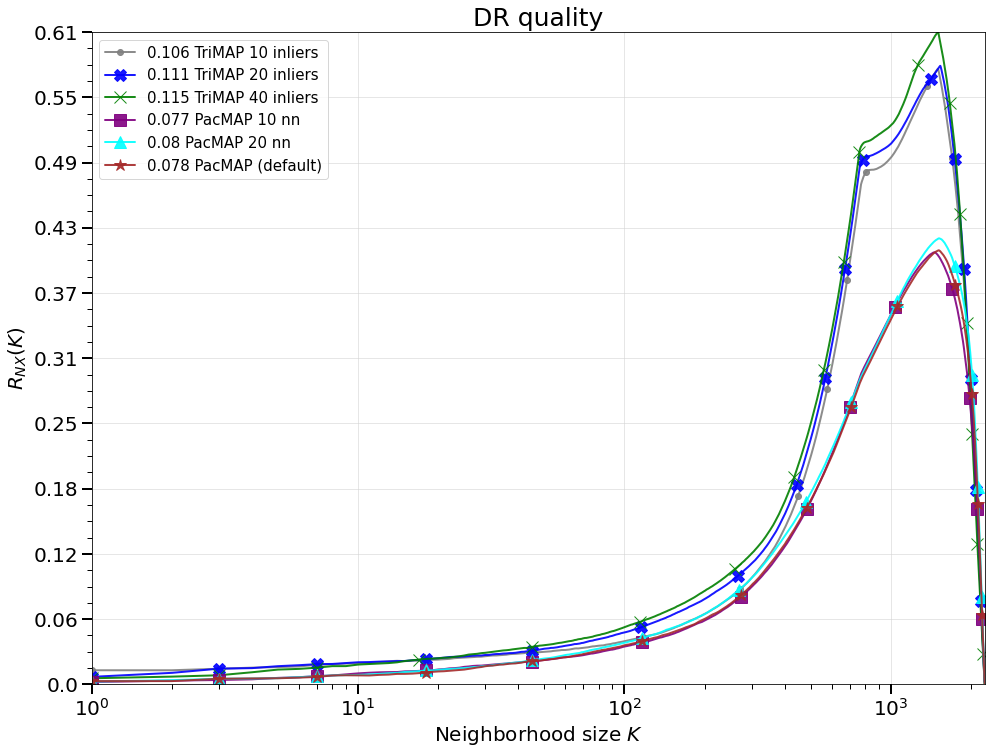

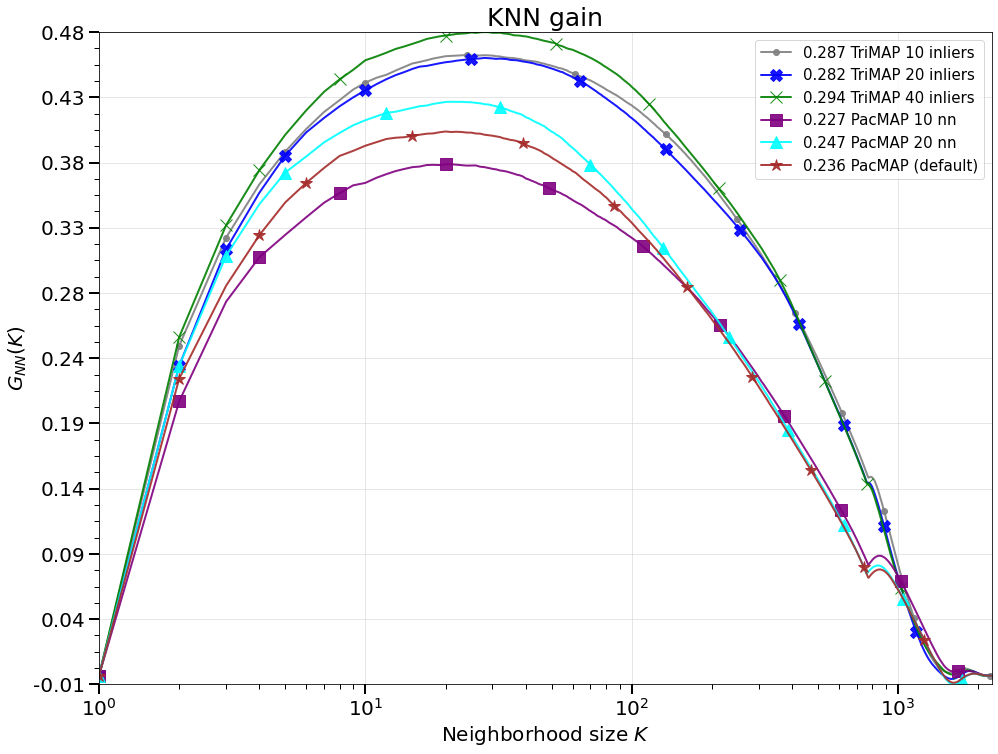

In [122]:
ball_2spheres_trimap_pacmap_metric.visualize()

Finished.


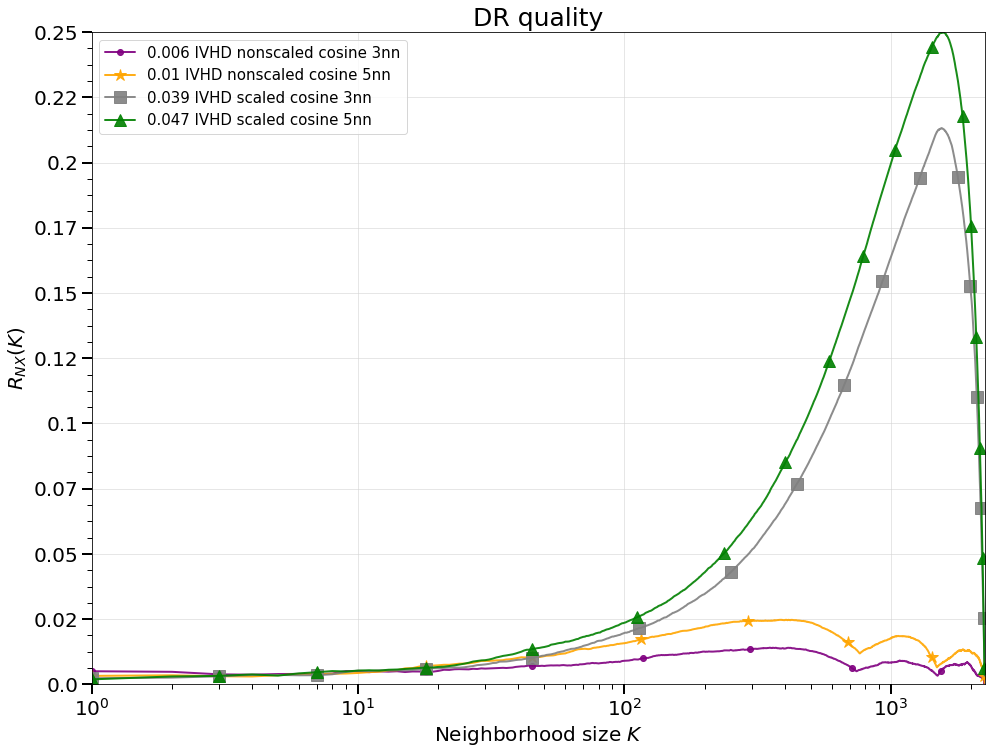

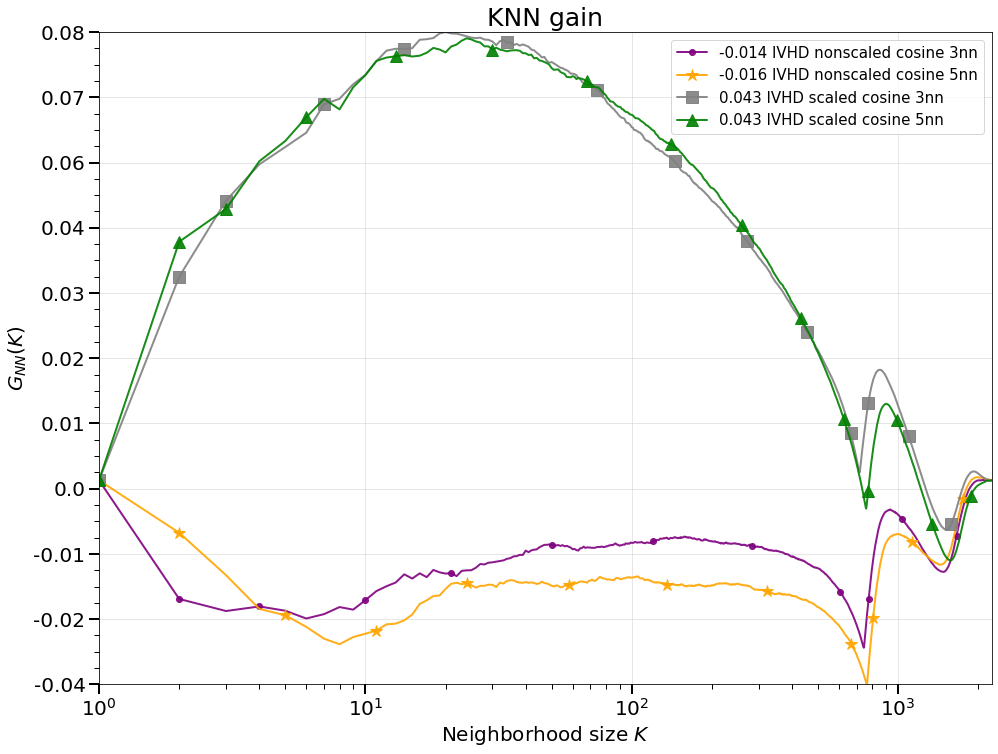

In [123]:
ball_2spheres_ivhd_cosine_metric.visualize()

Finished.


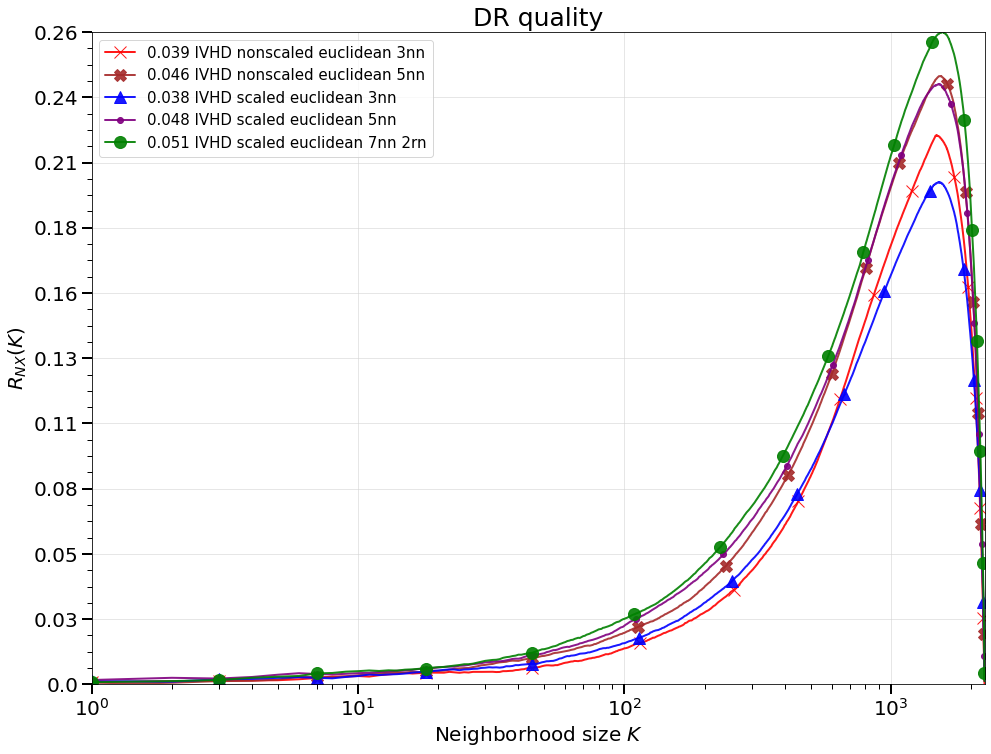

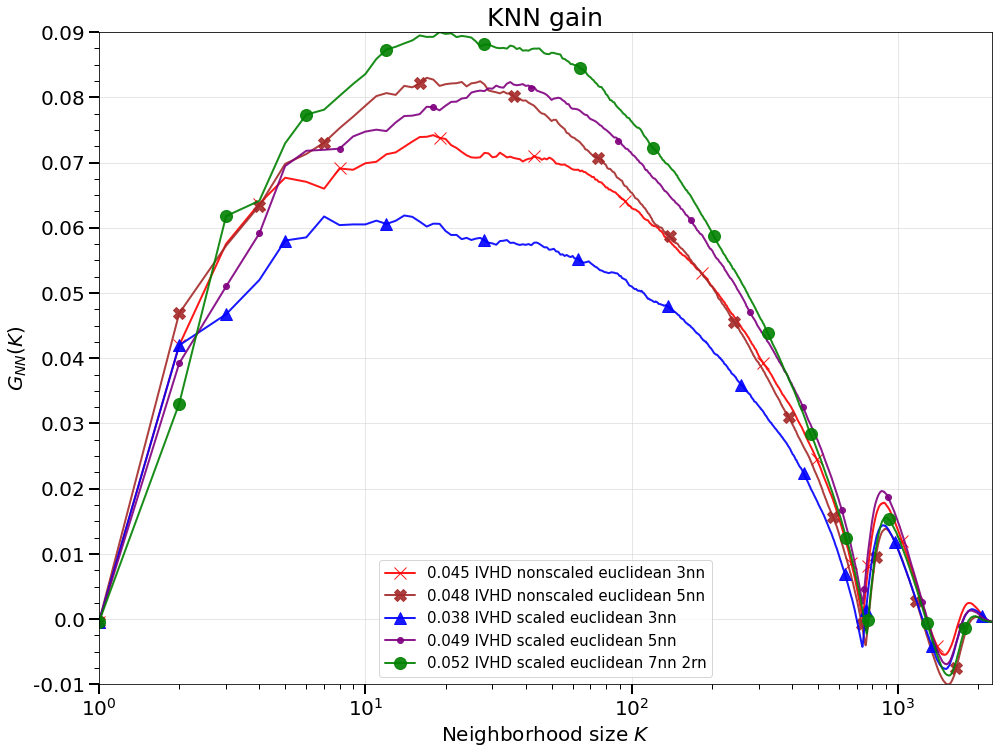

In [124]:
ball_2spheres_ivhd_euclidean_metric.visualize()

In [125]:
ball_2spheres_best_method_results = LocalMetric()

ball_2spheres_x_results_best = [ball_2spheres_x_500_tsne, ball_2spheres_x_10_umap, ball_2spheres_x_40_trimap, ball_2spheres_x_nn20_pacmap, ball_2spheres_ivhd_results[-1]]
ball_2spheres_y_results_best = ["t-SNE perplexity 500", "UMAP 10 neighbours", "TriMAP 40 inliers", "PacMAP 20nn", "IVHD euclidean 7nn scaled 2rn"]

metric_calculate(ball_2spheres_best_method_results, ball_2spheres_x_results_best, ball_2spheres_y_results_best)

Calculating d_hd
t-SNE perplexity 500
Calculating d_hd
UMAP 10 neighbours
Calculating d_hd
TriMAP 40 inliers
Calculating d_hd
PacMAP 20nn
Calculating d_hd
IVHD euclidean 7nn scaled 2rn


Finished.


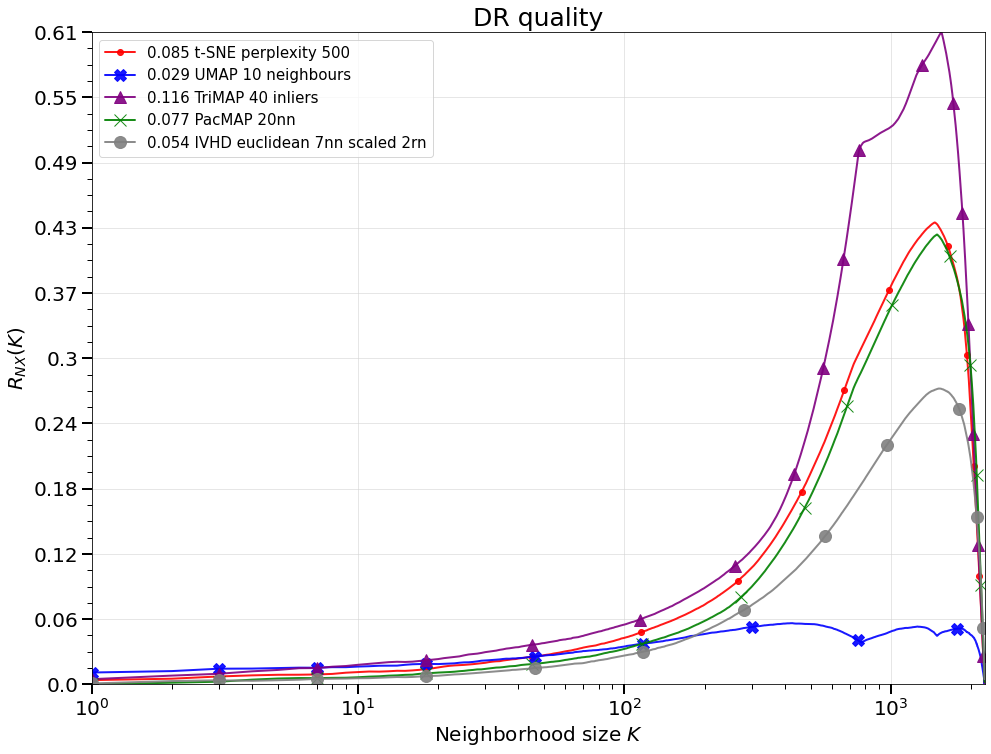

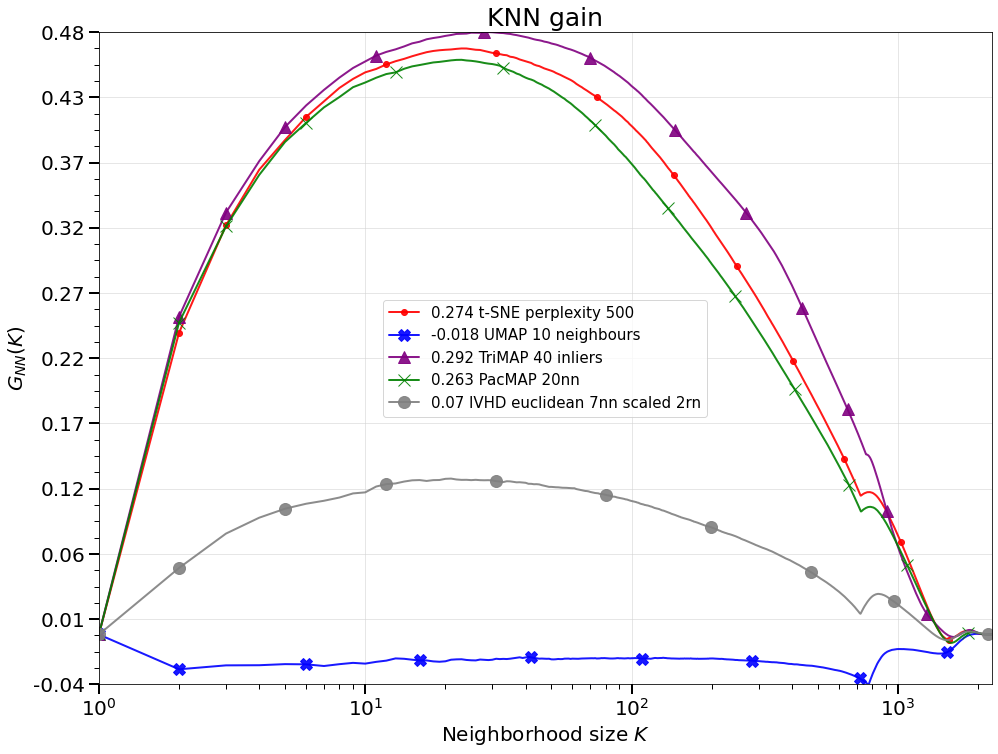

In [126]:
ball_2spheres_best_method_results.visualize()

### Additional investigation for 10k 2class ball 30d dataset

Since our dataset class is reliant only on 1st dimension (d[0] > 0 = 1, d[0] < 0 = 2) we lost a lot of information when reducing it to 2 dimensions.
We can try to reduce initial dataset dimensions to see at what point will the methods fall.

In [23]:
sought_dimensions = [3,5,7,10]

# If you want to generate new balls for each generation you will have to generate new .bin files for IVHD

# for d in sought_dimensions:
#     tmp_ball = random_ball(12000, d, radius=1)
#     tmp_ball1 = []
#     tmp_ball2 = []
#     for i in tmp_ball:
#         if i[0] > 0:
#             tmp_ball1.append(i)
#         else:
#             tmp_ball2.append(i)
#     tmp_ball_res = np.concatenate([tmp_ball1[:5000], tmp_ball2[:5000]])
#     np.savetxt(f"data/10k_ball_{d}d.csv", tmp_ball_res, delimiter=",")

In [43]:
ball_nd_10k_dataset_results = [[] for _ in sought_dimensions]
ball_nd_10k_classes = np.array([i for i in range(2) for _ in range(5000)])

ball_nd_ivhd_args = {
    'dir': "../../viskit_offline/viskit_offline",
    'labels_csv': "./data/10k_ball_labels.csv",
    'output': "./data/10k_balls.txt",
    'nn': 10,
    'rn': 1, # tried for 5 rn as well but it didn't help either
    'iter': 2500,
    'bd': 1,
    'rns': 0,
    'rnc': 0,
    'l1s': 0,
    'optimizer': "force-directed"
}

for i, d in enumerate(sought_dimensions):
    df_dataset = pd.read_csv(f'data/10k_ball_{d}d.csv', header=None)

    min_max_scaler = preprocessing.MinMaxScaler()
    data_10k_ball_scaled = min_max_scaler.fit_transform(df_dataset)
    df_10k_ball_scaled = pd.DataFrame(data=data_10k_ball_scaled)
    df_10k_ball_scaled.to_csv(f'./data/10k_ball_scaled_{d}d.csv', header=False, index=False)

    tsne_ball_10k_check = TSNE()
    tsne_ball_10k_check_res = tsne_ball_10k_check.fit_transform(data_10k_ball_scaled)
    ball_nd_10k_dataset_results[i].append(tsne_ball_10k_check_res)

    umap_ball_10k_check = umap.UMAP()
    umap_ball_10k_check_res = umap_ball_10k_check.fit_transform(data_10k_ball_scaled)
    ball_nd_10k_dataset_results[i].append(umap_ball_10k_check_res)

    trimap_ball_10k_check = trimap.TRIMAP()
    trimap_ball_10k_check_res = trimap_ball_10k_check.fit_transform(data_10k_ball_scaled)
    ball_nd_10k_dataset_results[i].append(trimap_ball_10k_check_res)

    pacmap_ball_10k_check = pacmap.PaCMAP()
    pacmap_ball_10k_check_res = pacmap_ball_10k_check.fit_transform(data_10k_ball_scaled)
    ball_nd_10k_dataset_results[i].append(pacmap_ball_10k_check_res)

    
    command = '{dir} "{data_csv}" "{labels_csv}" "{gp}" {output} {iter} {nn} {rn} {bd} {rns} {rnc} {l1s} "{optimizer}"'.format(
        dir = ball_nd_ivhd_args['dir'],
        data_csv = f"./data/10k_ball_scaled_{d}d.csv",
        labels_csv = ball_nd_ivhd_args['labels_csv'],
        gp = f"./data/10k_ball_scaled_{d}d_cosine.bin",
        output = ball_nd_ivhd_args['output'],
        iter = ball_nd_ivhd_args['iter'],
        nn = ball_nd_ivhd_args['nn'], 
        rn = ball_nd_ivhd_args['rn'],
        bd = ball_nd_ivhd_args['bd'],
        rns = ball_nd_ivhd_args['rns'],
        rnc = ball_nd_ivhd_args['rnc'],
        l1s = ball_nd_ivhd_args['l1s'],
        optimizer = ball_nd_ivhd_args['optimizer'],
    )

    os.system(command)
    res = get_ivhd_result(ball_nd_ivhd_args['output'])
    ball_nd_10k_dataset_results[i].append(res)

    command = command.replace('cosine', 'euclidean')
    os.system(command)
    res = get_ivhd_result(ball_nd_ivhd_args['output'])
    ball_nd_10k_dataset_results[i].append(res)

/home/ewer/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/home/ewer/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[Info] [CSV Parser] Loading dataset from file: ./data/10k_ball_scaled_3d.csv
[Info] [CSV Parser] Loading dataset from file: ./data/10k_ball_labels.csv
[Info] [CSV Parser] Labels file passed.
[Info] [CSV Parser] Dataset size: 10000
[Info] [CSV Parser] Dataset dimensionality: 3
[Info] [CSV Parser] Number of classes in dataset: 2
[Info] [CSV Parser] Finished.
[Info] [Graph] Loading graph from cache...
[Info] [Graph] Finished.
[Info] [kNN Generator] Determining random neighbors...
[Info] [kNN Generator] Finished.
[Info] [kNN Generator] Neighbors in graph: 110000
Step: 0
Step: 100
Step: 200
Step: 300
Step: 400
Step: 500
Step: 600
Step: 700
Step: 800
Step: 900
Step: 1000
Step: 1100
Step: 1200
Step: 1300
Step: 1400
Step: 1500
Step: 1600
Step: 1700
Step: 1800
Step: 1900
Step: 2000
Step: 2100
Step: 2200
Step: 2300
Step: 2400
[Info] [CSV Parser] Loading dataset from file: ./data/10k_ball_scaled_3d.csv
[Info] [CSV Parser] Loading dataset from file: ./data/10k_ball_labels.csv
[Info] [CSV Parser] L

/home/ewer/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/home/ewer/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[Info] [CSV Parser] Loading dataset from file: ./data/10k_ball_scaled_5d.csv
[Info] [CSV Parser] Loading dataset from file: ./data/10k_ball_labels.csv
[Info] [CSV Parser] Labels file passed.
[Info] [CSV Parser] Dataset size: 10000
[Info] [CSV Parser] Dataset dimensionality: 5
[Info] [CSV Parser] Number of classes in dataset: 2
[Info] [CSV Parser] Finished.
[Info] [Graph] Loading graph from cache...
[Info] [Graph] Finished.
[Info] [kNN Generator] Determining random neighbors...
[Info] [kNN Generator] Finished.
[Info] [kNN Generator] Neighbors in graph: 110000
Step: 0
Step: 100
Step: 200
Step: 300
Step: 400
Step: 500
Step: 600
Step: 700
Step: 800
Step: 900
Step: 1000
Step: 1100
Step: 1200
Step: 1300
Step: 1400
Step: 1500
Step: 1600
Step: 1700
Step: 1800
Step: 1900
Step: 2000
Step: 2100
Step: 2200
Step: 2300
Step: 2400
[Info] [CSV Parser] Loading dataset from file: ./data/10k_ball_scaled_5d.csv
[Info] [CSV Parser] Loading dataset from file: ./data/10k_ball_labels.csv
[Info] [CSV Parser] L

/home/ewer/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/home/ewer/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[Info] [CSV Parser] Loading dataset from file: ./data/10k_ball_scaled_7d.csv
[Info] [CSV Parser] Loading dataset from file: ./data/10k_ball_labels.csv
[Info] [CSV Parser] Labels file passed.
[Info] [CSV Parser] Dataset size: 10000
[Info] [CSV Parser] Dataset dimensionality: 7
[Info] [CSV Parser] Number of classes in dataset: 2
[Info] [CSV Parser] Finished.
[Info] [Graph] Loading graph from cache...
[Info] [Graph] Finished.
[Info] [kNN Generator] Determining random neighbors...
[Info] [kNN Generator] Finished.
[Info] [kNN Generator] Neighbors in graph: 110000
Step: 0
Step: 100
Step: 200
Step: 300
Step: 400
Step: 500
Step: 600
Step: 700
Step: 800
Step: 900
Step: 1000
Step: 1100
Step: 1200
Step: 1300
Step: 1400
Step: 1500
Step: 1600
Step: 1700
Step: 1800
Step: 1900
Step: 2000
Step: 2100
Step: 2200
Step: 2300
Step: 2400
[Info] [CSV Parser] Loading dataset from file: ./data/10k_ball_scaled_7d.csv
[Info] [CSV Parser] Loading dataset from file: ./data/10k_ball_labels.csv
[Info] [CSV Parser] L

/home/ewer/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/home/ewer/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[Info] [CSV Parser] Loading dataset from file: ./data/10k_ball_scaled_10d.csv
[Info] [CSV Parser] Loading dataset from file: ./data/10k_ball_labels.csv
[Info] [CSV Parser] Labels file passed.
[Info] [CSV Parser] Dataset size: 10000
[Info] [CSV Parser] Dataset dimensionality: 10
[Info] [CSV Parser] Number of classes in dataset: 2
[Info] [CSV Parser] Finished.
[Info] [Graph] Loading graph from cache...
[Info] [Graph] Finished.
[Info] [kNN Generator] Determining random neighbors...
[Info] [kNN Generator] Finished.
[Info] [kNN Generator] Neighbors in graph: 110000
Step: 0
Step: 100
Step: 200
Step: 300
Step: 400
Step: 500
Step: 600
Step: 700
Step: 800
Step: 900
Step: 1000
Step: 1100
Step: 1200
Step: 1300
Step: 1400
Step: 1500
Step: 1600
Step: 1700
Step: 1800
Step: 1900
Step: 2000
Step: 2100
Step: 2200
Step: 2300
Step: 2400
[Info] [CSV Parser] Loading dataset from file: ./data/10k_ball_scaled_10d.csv
[Info] [CSV Parser] Loading dataset from file: ./data/10k_ball_labels.csv
[Info] [CSV Parser

### Now we can check the results

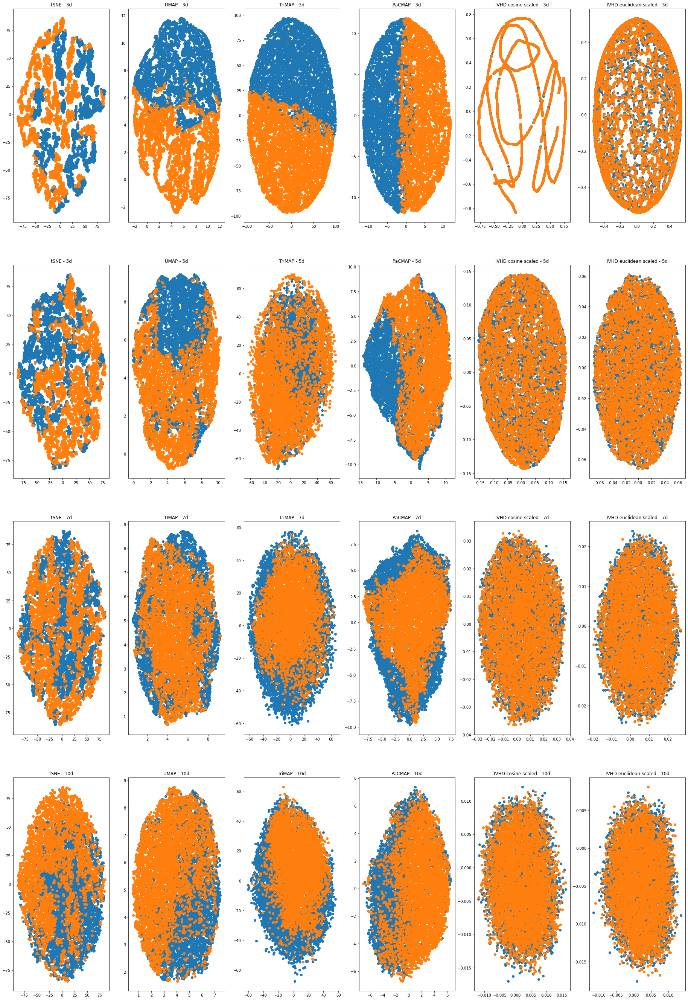

In [44]:
figure, axis = plt.subplots(len(sought_dimensions), 6)
figure.set_size_inches(len(sought_dimensions)*8, 48)

method_names_ball_10k_nd = [
    "tSNE", "UMAP", "TriMAP", "PaCMAP", "IVHD cosine (10nn) scaled", "IVHD euclidean (10nn) scaled"
]

for j in range(len(sought_dimensions)):
    for i in range(6):
        axis[j, i].set_title(method_names_ball_10k_nd[i] + f' - {sought_dimensions[j]}d')

        X = ball_nd_10k_dataset_results[j][i]
        if not X.any(): # temporary for non-existant plot data
            break
        
        for k in range(6):
            digit_indices = (ball_nd_10k_classes == 1-k)
            dim1 = X[digit_indices, 0]
            dim2 = X[digit_indices, 1]
            axis[j, i].scatter(dim1, dim2, label=f"'{i}'")
            

plt.show()